## Build MRCNN Model -Load MRCNN and FCN weights - Load Training Files  

In [191]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
%matplotlib inline
%load_ext autoreload
%autoreload 2
import sys,os, pprint, pickle
pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())
if '..' not in sys.path:
    print("appending '..' to sys.path")
    sys.path.append('..')
import copy    
import numpy as np
import matplotlib.pyplot as plt
from matplotlib          import cm
import mrcnn.utils       as utils
import mrcnn.visualize   as visualize
import mrcnn.visualize  as vis
import mrcnn.visualize_2 as vis2
from mrcnn.prep_notebook import build_fcn_inference_pipeline_newshapes, build_fcn_evaluate_pipeline_newshapes
from mrcnn.prep_notebook import get_inference_batch, get_evaluate_batch, get_image_batch
from mrcnn.prep_notebook import run_mrcnn_detection, run_fcn_detection, run_fcn_evaluation
from mrcnn.newshapes     import prep_newshape_dataset
from mrcnn.visualize     import display_training_batch
# from mrcnn.utils         import trim_zeros, compute_overlaps
# from mrcnn.calculate_map import update_map_dictionaries

# WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_2298.h5' 
# FCN_WEIGHT_FILE = 'F:\\models_newshapes\\train_fcn8_l2_newshapes\\fcn20181224T0000\\fcn_0821.h5'
##------------------------------------------------------------------------------------
## Parse command line arguments
##------------------------------------------------------------------------------------
parser = utils.command_line_parser()
input_parms  =" --batch_size     1  "
input_parms +=" --dataset        newshapes2 "
input_parms +=" --mrcnn_logs_dir train_mrcnn "
input_parms +=" --fcn_logs_dir   train_fcn8L2_BCE1 " 
input_parms +=" --mrcnn_model    /home/kbardool/models_newshapes2/train_mrcnn/mrcnn20190318T0000/"+ "mrcnn_0020.h5 "
input_parms +=" --fcn_model      /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/" + "fcn_0089.h5"
input_parms +=" --fcn_arch       fcn8l2 " 
input_parms +=" --sysout         screen "
input_parms +=" --evaluate_method 3"
input_parms +=" --scale_factor    1"
args = parser.parse_args(input_parms.split())
utils.display_input_parms(args)

CLASS_COLUMN        = 4
ORIG_SCORE_COLUMN   = 5
DT_TYPE_COLUMN      = 6
SEQUENCE_COLUMN     = 7
NORM_SCORE_COLUMN   = 8    
SCORE_0_SUM_COLUMN  = 9
SCORE_0_AREA_COLUMN = 10
SCORE_0_COLUMN      = 11
SCORE_1_SUM_COLUMN  = 12
SCORE_1_AREA_COLUMN = 13
SCORE_1_COLUMN      = 14 
SCORE_1_NORM_COLUMN = 17
SCORE_2_SUM_COLUMN  = 18
SCORE_2_AREA_COLUMN = 19
SCORE_2_COLUMN      = 20
SCORE_2_NORM_COLUMN = 23

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Current working dir:  /home/kbardool/git_projs/mrcnn3/notebooks

   Arguments passed :
   --------------------
   batch_size                     1
   coco_classes                   None
   dataset                        newshapes2
   epochs                         1
   evaluate_method                3
   fcn_arch                       FCN8L2
   fcn_bce_loss_class             0
   fcn_bce_loss_method            1
   fcn_layers                     ['fcn32+']
   fcn_logs_dir                   train_fcn8L2_BCE1
   fcn_losses                     fcn_BCE_loss
   fcn_model                      /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0089.h5
   last_epoch                     0
   lr                             0.001
   mrcnn_exclude_layers           None
   mrcnn_layers                   ['mrcnn', 'fpn', 'rpn']
   mrcnn_logs_dir                 train_mrcnn
   mrcnn_model     

In [289]:
# mrcnn_model, fcn_model = build_fcn_inference_pipeline_newshapes(args = args)
mrcnn_model, fcn_model = build_fcn_evaluate_pipeline_newshapes(args = args)

MODE IS: evaluate

--> Execution started at: 04-16-2019 @ 22:58:57
    Tensorflow Version: 1.8.0   Keras Version : 2.1.6 
    Build_mrcnn_inference_pipeline_newshapes MODE is : evaluate

   Arguments passed :
   --------------------
   batch_size                     1
   coco_classes                   None
   dataset                        newshapes2
   epochs                         1
   evaluate_method                3
   fcn_arch                       FCN8L2
   fcn_bce_loss_class             0
   fcn_bce_loss_method            1
   fcn_layers                     ['fcn32+']
   fcn_logs_dir                   train_fcn8L2_BCE1
   fcn_losses                     fcn_BCE_loss
   fcn_model                      /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0089.h5
   last_epoch                     0
   lr                             0.001
   mrcnn_exclude_layers           None
   mrcnn_layers                   ['mrcnn', 'fpn', 'rpn']
   mrcnn_logs_dir              

    Weights file loaded: /home/kbardool/models_newshapes2/train_mrcnn/mrcnn20190318T0000/mrcnn_0020.h5 
MRCNN  MODEL Load weight file COMPLETE 
>>> Initialize Paths
 Linx  Linux
>>> Initialize ModelBase model 
   Mode      :  inference
   Model dir :  /home/kbardool/models_newshapes2/train_fcn8L2_BCE1
>>> ModelBase initialiation complete
>>> Initialize FCN model, mode:  inference architecture:  FCN8L2
    arch set to FCN8 - with L2 Regularization
<function fcn8_l2_graph at 0x7f80a690b598>


---------------------------------------------------
 Build FCN Model -  Arch:  FCN8L2  mode:  inference
---------------------------------------------------

------------------------------------------------------
>>> FCN8L2 Layer With Regularization - mode: inference
------------------------------------------------------

 
---------------------------------------------
>>> FCN Scoring Graph  - mode: inference
---------------------------------------------

 
-------------------------------------------

## Load MRCNN  and FCN Weights

In [ ]:
MRCNN_DIR_WEIGHTS =  'F:/models_newshapes/train_mrcnn_newshapes/mrcnn20181216T0000'

# files = ['fcn_0001.h5','fcn_0027.h5','fcn_0036.h5','fcn_0051.h5','fcn_0076.h5','fcn_0106.h5','fcn_0156.h5']
# files   = ['fcn_0104.h5','fcn_0150.h5','fcn_0205.h5','fcn_0249.h5','fcn_0293.h5','fcn_0346.h5','fcn_0419.h5']
mrcnn_files   = ['mrcnn_0001.h5', 'mrcnn_0058.h5', 'mrcnn_0152.h5', 'mrcnn_0247.h5', 'mrcnn_0389.h5','mrcnn_0472.h5']

In [ ]:
FILE_IDX = -1
mrcnn_weights_file = os.path.join(MRCNN_DIR_WEIGHTS  , mrcnn_files[FILE_IDX])
print("Loading weights ", mrcnn_weights_file)
mrcnn_model.load_model_weights(mrcnn_weights_file)

In [ ]:
FCN_DIR_WEIGHTS =  'F:/models_newshapes/train_fcn8_l2_newshapes/fcn20181224T0000' ### Training with LR=0.00001, MSE Loss NO L2 Regularization

fcn_files = ['fcn_0001.h5', 'fcn_0150.h5', 'fcn_0346.h5', 'fcn_0421.h5',
             'fcn_0450.h5', 'fcn_0482.h5', 'fcn_0521.h5', 'fcn_0610.h5',
             'fcn_0687.h5', 'fcn_0793.h5', 'fcn_0821.h5', 'fcn_0940.h5',
             'fcn_1012.h5', 'fcn_1127.h5', 'fcn_1644.h5', 'fcn_1776.h5',
              'fcn_1848.h5', 'fcn_2017.h5', 'fcn_2084.h5', 'fcn_x0434.h5', 'fcn_x0419.h5']

In [ ]:
FILE_IDX = 10
fcn_weights_file = os.path.join(FCN_DIR_WEIGHTS  , fcn_files[FILE_IDX])
print("Loading weights ", fcn_weights_file)
fcn_model.load_model_weights(fcn_weights_file)

## Load test dataset

In [3]:
# del dataset_train, dataset_val, train_generator, val_generator
# dataset_test , test_generator   = prep_newshape_dataset( mrcnn_model.config,  1000, generator=True)
# with open('newshapes_dataset_1000_B.pkl', 'wb') as outfile:
#     pickle.dump(dataset_test, outfile)
## -- OR --

with open(os.path.join(mrcnn_model.config.DIR_DATASET,"newshapes2_test_dataset_1000_A.pkl"), 'rb') as infile:
    dataset_test = pickle.load(infile)
print(type(dataset_test))    

dataset_test.display_active_class_info()
print("Testing Dataset Image Count: {}".format(len(dataset_test.image_ids)))
print("Testing Dataset Class Count: {}".format(dataset_test.num_classes))
print(len(dataset_test.image_ids))    
class_names = dataset_test.class_names

<class 'mrcnn.newshapes2.NewImagesDataset'>
[1, 2, 3, 4, 5, 6, 7, 8]
internal_class:  1 ext_cls: 1 name: None - person
internal_class:  2 ext_cls: 2 name: None - car
internal_class:  3 ext_cls: 3 name: None - sun
internal_class:  4 ext_cls: 4 name: None - building
internal_class:  5 ext_cls: 5 name: None - tree
internal_class:  6 ext_cls: 6 name: None - cloud
internal_class:  7 ext_cls: 7 name: None - airplane
internal_class:  8 ext_cls: 8 name: None - truck
Testing Dataset Image Count: 1000
Testing Dataset Class Count: 9
1000


###  Display some images from dataset

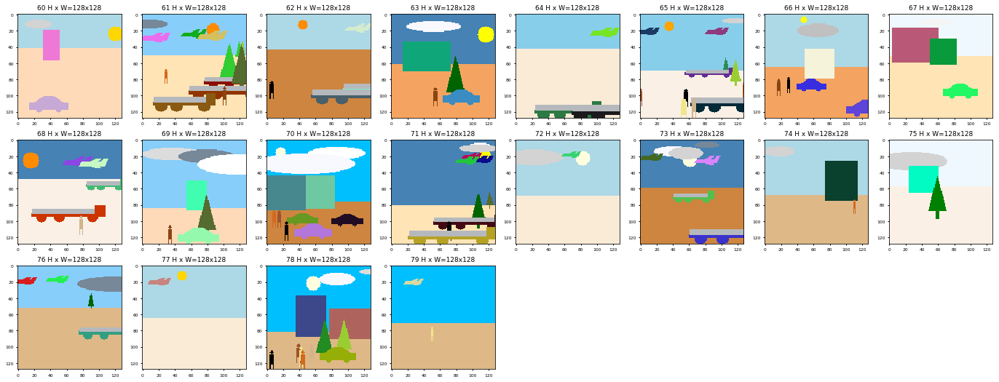

In [4]:
# image_list = list(range(160,200))
image_list = list(range(60, 80))
image_titles = [str(i) for i in image_list]
images = get_image_batch(dataset_test, image_list)
visualize.display_images(images, titles = image_titles, cols = 8, width = 24)

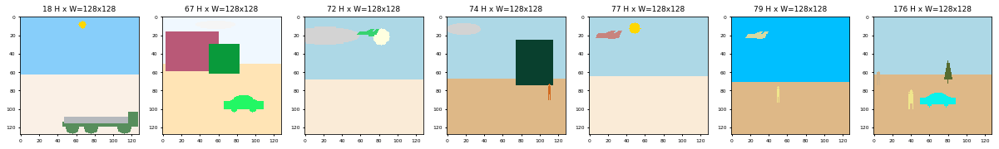

In [5]:
# image_list = list(range(160,200))
# image_list = list(range(0, 80))
image_list = [18, 67, 72, 74, 77, 79, 176]
image_titles = [str(i) for i in image_list]

images = get_image_batch(dataset_test, image_list)
visualize.display_images(images, titles = image_titles, cols = 8, width = 24)

####  Display next image from generator

In [6]:
# train_batch_x, train_batch_y = next(test_generator)
# visualize.display_training_batch(dataset_test, train_batch_x)

##  Manipulate some images to test contextual relationships

|Exp |Image     | Original Image | modifications |Conxtextual experiment
|----| :------- |:-------------- | :-------------|:------------------------------------------------------------------ 
| 1 | Image 18 | sun and truck | Remove sun, add building |  move truck around with and without a building present in the image
| 2 | image 67 | Buildings and car|                    | If we move a person around the activation "should" peak when it's in proper position with regards to the car.
| 3 | image 67 | Buildings and car| Remove all objects | and move an object of each class around in black, and in color. 
| 4 | Image 72 | sun and airplane | Remove sun         | move a car around the image, and move a truck around the image , comparing the results. Moving a truck should invoke higher activation than a car, since the cars do not cooccur with an airplane
| 5 | Image 77 | Sun, Airplane    | Remove sun         | move airplane around with and and without a building present in the scene. The activation strength should increase when the building is absent
| 6 | Image 79 | Person, plane | Remove the plane | move a car around the image. Activation of the car should peak when it's in propoer position with regards to the person
| 7 | image 176| 2 persons, tree, car| Remove tree and persons | move a airplane around (car and airplane dont occur in same image - so the relatvie activation strength of the airplane, in proper position, should be higher when thecar is absent from the image
    
    - The max FCN activation of the person is close to the car
 

####  Objects to add / remove from image s

In [7]:
## image 77: [('sun', (255.0, 215.0, 0.0), (49, 13, 6, 6)), ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))]
## image 27 : [ ('sun', (255.0, 255.0, 224.0), (87, 16, 7, 7)),   ('building', (7.0, 9.0, 197.0), (92, 60, 24, 20)),   ('person', (210.0, 105.0, 30.0), (124, 107, 2, 11))]

# del dataset_test.image_info[image_id]['shapes'][0:2]
# black_car  = ('car', black, (cx, cy, 15, 7))
# black_car = ('car', (0.0, 0.0, 0.0),(64,64, 15, 7))
# person = ('person', (139.0, 69.0, 19.0), (17, 92, 2, 10))
## person = ('person', (240.0, 230.0, 140.0), (40, 92, 2, 10))
## black_sun = ('sun', (0.0, 0.0, 0.0), (7, 9, 4, 4))
building  =  ('building', (7.0, 9.0, 197.0), (92, 60, 24, 20))
airplane  = ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))
car       = ('car', (150.0, 174.0, 8.0), (87, 112, 22, 11))
truck     = ('truck', (213.0, 56.0, 119.0), (80, 93, 39, 13))
truck     = ('truck', (83.0, 192.0, 78.0), (65, 71, 25, 8))
tree      = ('tree', (50.0, 205.0, 50.0), (100, 91, 12, 28))
cloud     = ('cloud', (192.0, 192.0, 192.0), (106, 20, 34, 8))
sun       = ('sun', (255.0, 140.0, 0.0), (66, 18, 7, 7)),

In [8]:
pp.pprint(dataset_test.image_info[20]['shapes'])

[ ('sun', (255.0, 140.0, 0.0), (66, 18, 7, 7)),
  ('cloud', (220.0, 220.0, 220.0), (120, 8, 11, 3)),
  ('cloud', (245.0, 245.0, 245.0), (22, 15, 33, 6)),
  ('cloud', (192.0, 192.0, 192.0), (106, 20, 34, 8)),
  ('airplane', (238.0, 50.0, 231.0), (12, 22, 16, 6)),
  ('airplane', (197.0, 103.0, 195.0), (70, 29, 18, 7)),
  ('tree', (107.0, 142.0, 35.0), (15, 66, 4, 11)),
  ('truck', (143.0, 204.0, 87.0), (73, 80, 25, 8)),
  ('tree', (46.0, 139.0, 87.0), (2, 74, 6, 16)),
  ('person', (160.0, 82.0, 45.0), (34, 89, 1, 9)),
  ('truck', (24.0, 239.0, 59.0), (52, 93, 41, 10)),
  ('tree', (50.0, 205.0, 50.0), (19, 91, 12, 28)),
  ('person', (160.0, 82.0, 45.0), (121, 112, 2, 12))]


#### Manipulate image 77

In [9]:
image_id = 77
save_shapes = copy.copy(dataset_test.image_info[image_id]['shapes'])
pp.pprint(save_shapes)

[('sun', (255.0, 215.0, 0.0), (49, 13, 6, 6)), ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))]


In [23]:
# pp.pprint(save_shapes)
# dataset_test.image_info[image_id]['shapes'] = save_shapes
# building  =  ('building', (7.0, 9.0, 197.0), (92, 60, 24, 20))
pp.pprint(dataset_test.image_info[image_id]['shapes'])

[('sun', (255.0, 215.0, 0.0), (49, 13, 6, 6)), ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))]


[ ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7)),
  ('car', (150.0, 174.0, 8.0), (100, 93, 20, 10))]
 Image_id    :  77  Reference:  [('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7)), ('car', (150.0, 174.0, 8.0), (100, 93, 20, 10))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [7 2]
 Class Names :  ['airplane', 'car']


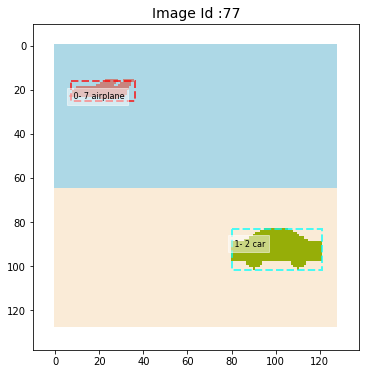

In [24]:
airplane = ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))
car       = ('car', (150.0, 174.0, 8.0), (30, 93, 26, 12))
truck     = ('truck', (213.0, 56.0, 119.0), (30, 93, 26, 13))
small_car = ('car', (150.0, 174.0, 8.0), (100, 93, 20, 10))
car       = ('car', (150.0, 174.0, 8.0), (95, 93, 28, 13))

dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(airplane)
dataset_test.image_info[image_id]['shapes'].append(small_car)
pp.pprint(dataset_test.image_info[image_id]['shapes'])
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

# del dataset_test.image_info[image_id]['shapes'][-1]
# dataset_test.image_info[image_id]['shapes'].append(truck)
# vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

# dataset_test.image_info[image_id]['shapes'][-1] = car
# vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)


In [25]:
# del dataset_test.image_info[image_id]['shapes'][-1]
# dataset_test.image_info[image_id]['shapes'].append(building)
# vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

In [10]:
airplane = ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))
person    = ('person', (139.0, 69.0, 19.0), (17, 92, 2, 10))
car       = ('car', (150.0, 174.0, 8.0), (87, 93, 24, 12))
sun       = ('sun', (255.0, 215.0, 0.0), (49, 13, 6, 6))
building  = ('building', (7.0, 9.0, 197.0), (92, 60, 24, 20))
tree      = ('tree', (50.0, 205.0, 50.0), (100, 91, 12, 28))
cloud     = ('cloud', (192.0, 192.0, 192.0), (106, 20, 34, 8))
truck     = ('truck', (213.0, 56.0, 119.0), (80, 93, 39, 13))
truck     = ('truck', (213.0, 56.0, 119.0), (80, 93, 30, 13))
truck     = ('truck', (213.0, 56.0, 119.0), (30, 93, 26, 13))

car       = ('car', (150.0, 174.0, 8.0), (87, 93, 26, 12))
## smae place on the left of the image to avoid the building
car       = ('car', (150.0, 174.0, 8.0), (30, 93, 26, 12))

xsmall_car = ('car', (150.0, 174.0, 8.0),(95, 93, 15, 7)) 
small_car = ('car', (150.0, 174.0, 8.0), (95, 93, 20, 9))
large_car = ('car', (150.0, 174.0, 8.0), (95, 93, 26, 12))

cols = 9
only = None

#####  Airplane and extra small car

 Image_id    :  77  Reference:  [('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7)), ('car', (150.0, 174.0, 8.0), (95, 93, 15, 7))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         7          2]
 Class Names :  ['airplane', 'car']


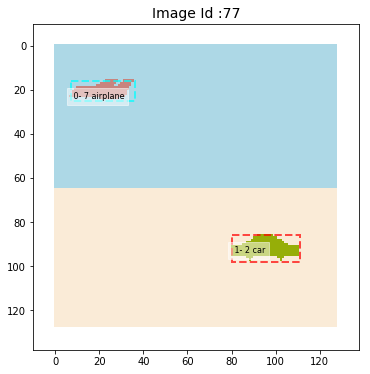

In [41]:
dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(airplane)
dataset_test.image_info[image_id]['shapes'].append(xsmall_car)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

In [42]:
# r = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  


 --------------------------------------------------------------------------------------
 class id :   2     class avg score: 0.9115    GT boxes :   1
 --------------------------------------------------------------------------------------

  TP Boxes: 	 box 			 orig_score 	 noise 		 new_score
  --------------------------------------------------------------------------------
  0  	 [   86.0000    80.0000    98.0000   111.0000] 		 [    0.9115] 	 [    0.0000] 	 [    0.9115]

 --------------------------------------------------------------------------------------
 class id :   7     class avg score: 0.9164    GT boxes :   1
 --------------------------------------------------------------------------------------

  TP Boxes: 	 box 			 orig_score 	 noise 		 new_score
  --------------------------------------------------------------------------------
  0  	 [   16.0000     7.0000    25.0000    36.0000] 		 [    0.9164] 	 [    0.0000] 	 [    0.9164]

GT boxes with additive noise, prior to sort: (2

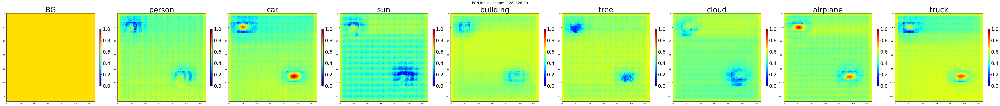

  FCN BBox Information - classes   --  :  [    2.0000     7.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  7.00)  ( 25.00, 36.00) |  21.50/ 20.50    29.00~   9.00   261.00   

In [43]:
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_fcn_scores(r[0]['fcn_scores'], class_names, only = only)
vis2.display_pr_fcn_style1(r[0], class_names)


#####  Airplane and small car

 Image_id    :  77  Reference:  [('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7)), ('car', (150.0, 174.0, 8.0), (95, 93, 20, 9))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         7          2]
 Class Names :  ['airplane', 'car']


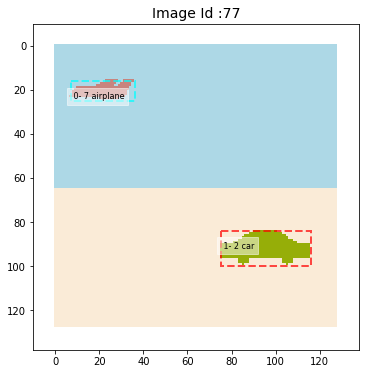

In [44]:
dataset_test.image_info[image_id]['shapes'][-1] = small_car
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

In [45]:
# r = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  


 --------------------------------------------------------------------------------------
 class id :   2     class avg score: 0.9115    GT boxes :   1
 --------------------------------------------------------------------------------------

  TP Boxes: 	 box 			 orig_score 	 noise 		 new_score
  --------------------------------------------------------------------------------
  0  	 [   84.0000    75.0000   100.0000   116.0000] 		 [    0.9115] 	 [    0.0000] 	 [    0.9115]

 --------------------------------------------------------------------------------------
 class id :   7     class avg score: 0.9164    GT boxes :   1
 --------------------------------------------------------------------------------------

  TP Boxes: 	 box 			 orig_score 	 noise 		 new_score
  --------------------------------------------------------------------------------
  0  	 [   16.0000     7.0000    25.0000    36.0000] 		 [    0.9164] 	 [    0.0000] 	 [    0.9164]

GT boxes with additive noise, prior to sort: (2

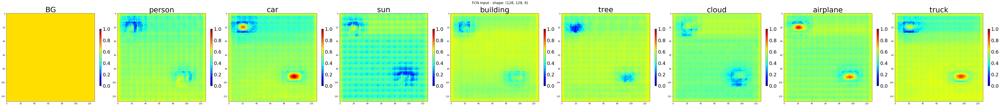

  FCN BBox Information - classes   --  :  [    2.0000     7.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  7.00)  ( 25.00, 36.00) |  21.50/ 20.50    29.00~   9.00   261.00   

In [46]:
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_fcn_scores(r[0]['fcn_scores'], class_names, only = only)
vis2.display_pr_fcn_style1(r[0], class_names)

##### Airplane and large car

 Image_id    :  77  Reference:  [('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7)), ('car', (150.0, 174.0, 8.0), (95, 93, 26, 12))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         7          2]
 Class Names :  ['airplane', 'car']


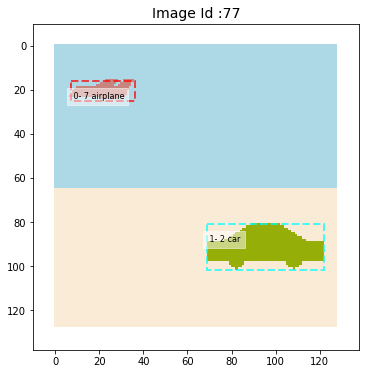

In [47]:
dataset_test.image_info[image_id]['shapes'][-1] = large_car
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

In [48]:
# r = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  


 --------------------------------------------------------------------------------------
 class id :   2     class avg score: 0.9115    GT boxes :   1
 --------------------------------------------------------------------------------------

  TP Boxes: 	 box 			 orig_score 	 noise 		 new_score
  --------------------------------------------------------------------------------
  0  	 [   81.0000    69.0000   102.0000   122.0000] 		 [    0.9115] 	 [    0.0000] 	 [    0.9115]

 --------------------------------------------------------------------------------------
 class id :   7     class avg score: 0.9164    GT boxes :   1
 --------------------------------------------------------------------------------------

  TP Boxes: 	 box 			 orig_score 	 noise 		 new_score
  --------------------------------------------------------------------------------
  0  	 [   16.0000     7.0000    25.0000    36.0000] 		 [    0.9164] 	 [    0.0000] 	 [    0.9164]

GT boxes with additive noise, prior to sort: (2

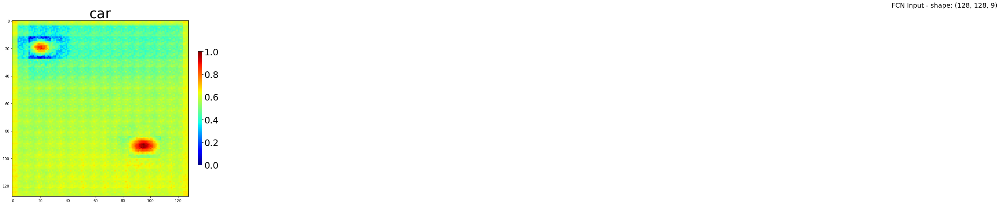

  FCN BBox Information - classes   --  :  [    2.0000     7.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  7.00)  ( 25.00, 36.00) |  21.50/ 20.50    29.00~   9.00   261.00   

In [49]:
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8, classes = [2])
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_fcn_scores(r[0]['fcn_scores'], class_names, only = only)
vis2.display_pr_fcn_style1(r[0], class_names)

##### 

77
 Image_id    :  77  Reference:  [('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7)), ('car', (150.0, 174.0, 8.0), (100, 93, 20, 10))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         7          2]
 Class Names :  ['airplane', 'car']
 Image_id    :  77  Reference:  [('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7)), ('car', (150.0, 174.0, 8.0), (100, 10, 20, 10))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         7          2]
 Class Names :  ['airplane', 'car']


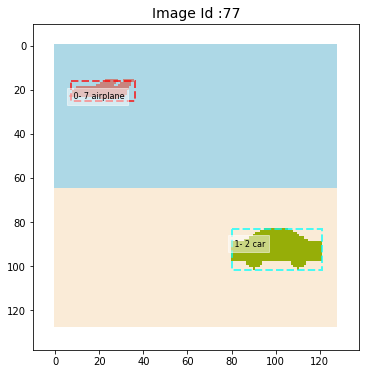

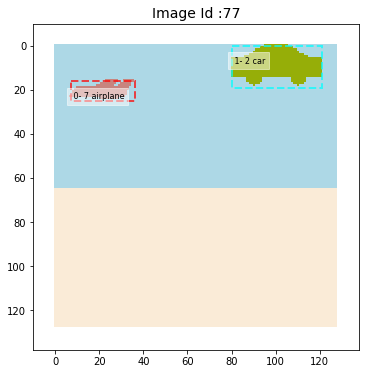

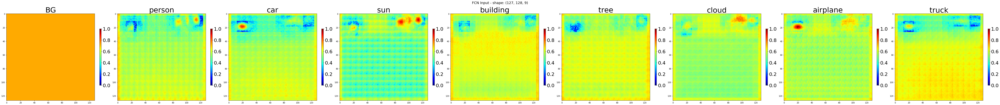

  FCN BBox Information - classes   --  :  [2, 7]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  6.00)  ( 25.00, 35.00) |  20.50/ 20.50    29.00~   9.00   261.00   40.00 |   3.81   

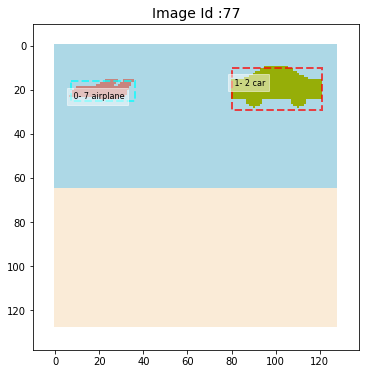

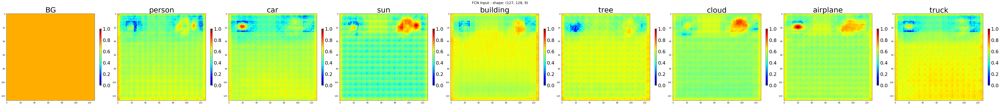

  FCN BBox Information - classes   --  :  [2, 7]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  6.00)  ( 25.00, 35.00) |  20.50/ 20.50    29.00~   9.00   261.00   40.00 |   3.81   

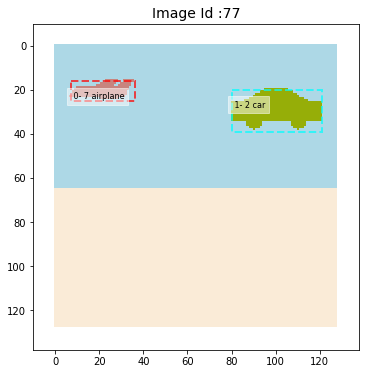

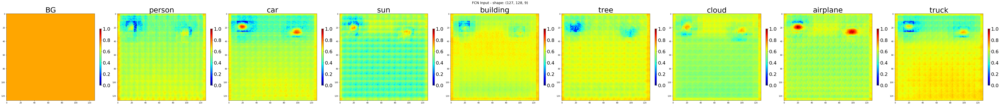

  FCN BBox Information - classes   --  :  [2, 7]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  6.00)  ( 25.00, 35.00) |  20.50/ 20.50    29.00~   9.00   261.00   40.00 |   3.81   

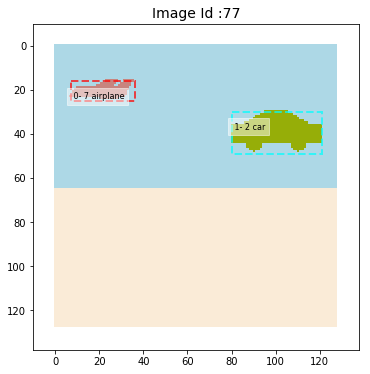

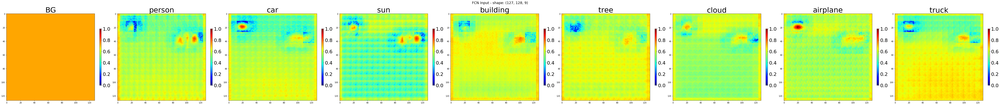

  FCN BBox Information - classes   --  :  [2, 7]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  6.00)  ( 25.00, 35.00) |  20.50/ 20.50    29.00~   9.00   261.00   40.00 |   3.81   

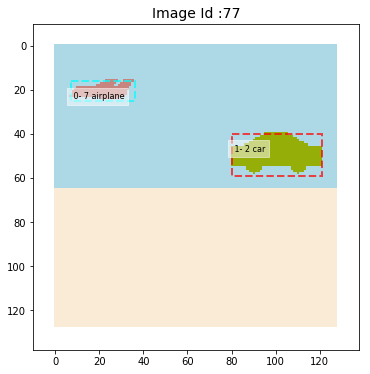

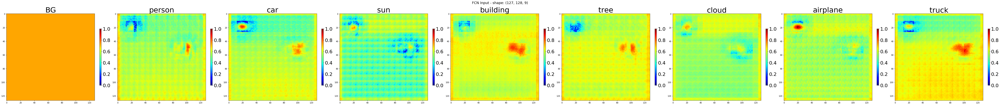

  FCN BBox Information - classes   --  :  [2, 7]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  6.00)  ( 25.00, 35.00) |  20.50/ 20.50    29.00~   9.00   261.00   40.00 |   3.81   

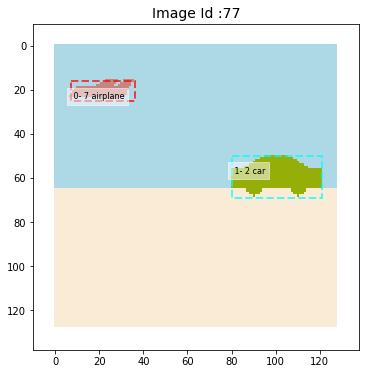

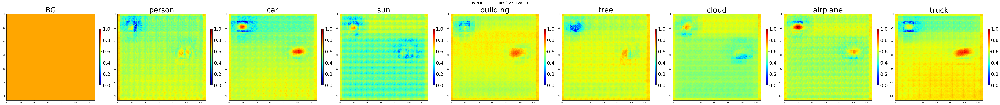

  FCN BBox Information - classes   --  :  [2, 7]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  6.00)  ( 25.00, 35.00) |  20.50/ 20.50    29.00~   9.00   261.00   40.00 |   3.81   

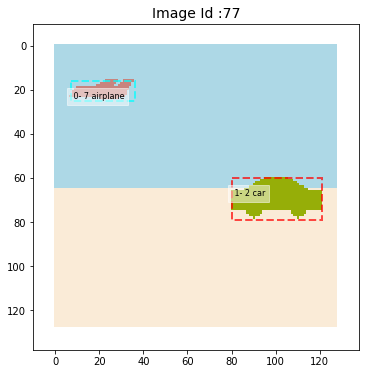

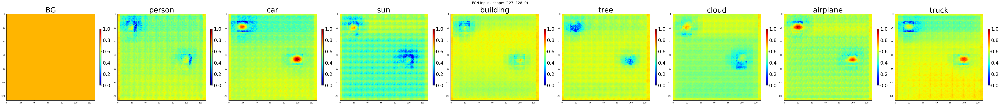

  FCN BBox Information - classes   --  :  [2, 7]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 16.00,  6.00)  ( 25.00, 35.00) |  20.50/ 20.50    29.00~   9.00   261.00   40.00 |   3.81   

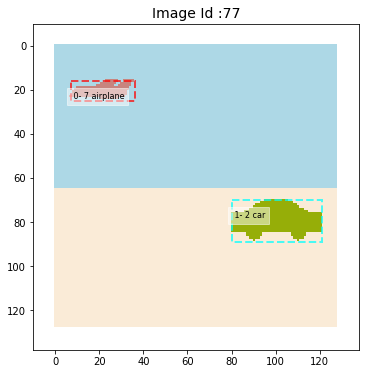

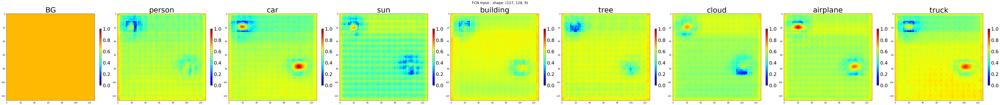

  FCN BBox Information - classes   --  :  [2, 7]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   2 car             ( 71.00, 82.00)  ( 87.00,121.00) | 101.50/ 79.00    39.00~  16.00   624.00   54.00 |   4.42   

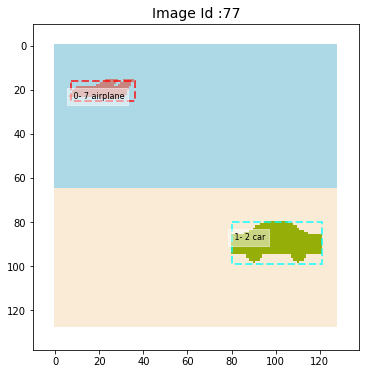

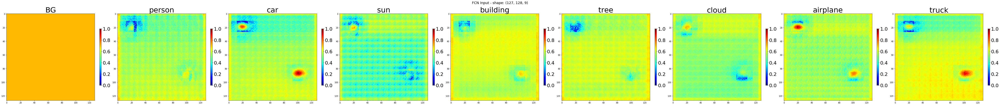

  FCN BBox Information - classes   --  :  [2, 7]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   2 car             ( 79.00, 85.00)  ( 98.00,118.00) | 101.50/ 88.50    33.00~  19.00   627.00   63.00 |   4.06   

In [100]:
print(image_id)
small_car = ('car', (150.0, 174.0, 8.0), (100, 93, 20, 10))
cx = 100

dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(airplane)
dataset_test.image_info[image_id]['shapes'].append(small_car)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
only = [2,7]
for cy in range(10, 100, 10):    
    small_car = ('car', (150.0, 174.0, 8.0), (cx, cy, 20, 10))
    dataset_test.image_info[image_id]['shapes'][-1] = small_car
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
    r = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
    vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns = cols, size = 8)
    vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)

#     r = fcn_results[0]
#     vis2.display_fcn_hm(vis2.normalize_all(r['fcn_hm'][...,:3]), class_names, columns = 3, size = 8)

###  Image 77 - consider contextual realtions between Airplane  and --> { Building, Car , Truck}

We know that {Airplane, Truck} and {Car, Building}are mutually exclusive. Evaluate the effect of inserting an out of context object into an image containing a car, or truck, or building

####  Image 77 : Airplane alone

 Image_id    :  77  Reference:  [('airplane', (200.0, 132.0, 126.0), (25, 30, 18, 7))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (1,)    [         7]
 Class Names :  ['airplane']


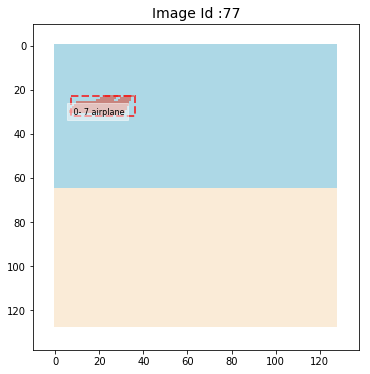

In [97]:
airplane = ('airplane', (200.0, 132.0, 126.0), (25, 30, 18, 7))

dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(airplane)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

 Image_id    :  77  Reference:  [('car', (150.0, 174.0, 8.0), (95, 93, 26, 12))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (1,)    [         2]
 Class Names :  ['car']


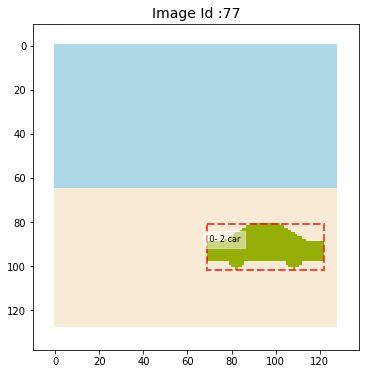

In [99]:
large_car = ('car', (150.0, 174.0, 8.0), (95, 93, 26, 12))
airplane  = ('airplane', (200.0, 132.0, 126.0), (25, 30, 18, 7))
dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(large_car)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

# r = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

 Image_id    :  77  Reference:  [('car', (150.0, 174.0, 8.0), (95, 93, 26, 12)), ('airplane', (200.0, 132.0, 126.0), (25, 30, 18, 7))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         2          7]
 Class Names :  ['car', 'airplane']


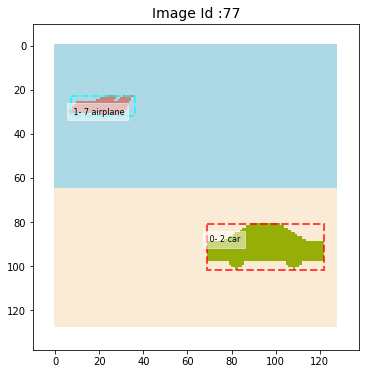

In [101]:
dataset_test.image_info[image_id]['shapes'].append(airplane)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

# r = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

###  Image 77 : Car and other objects 

In [144]:
# airplane  = ('airplane', (200.0, 132.0, 126.0), (25 , 30, 18,  7))
# person    = ('person'  , (139.0, 69.0, 19.0)  , (17 , 92,  2, 10))
# car       = ('car'     , (150.0, 174.0, 8.0)  , (87 , 93, 24, 12))
# sun       = ('sun'     , (255.0, 215.0, 0.0)  , (49 , 13,  6,  6))
# building  = ('building', (7.0, 9.0, 197.0)    , (92 , 60, 24, 20))
# tree      = ('tree'    , (50.0, 205.0, 50.0)  , (100, 91, 12, 28))
# cloud     = ('cloud'   , (192.0, 192.0, 192.0), (106, 20, 34,  8))
# truck     = ('truck'   , (213.0, 56.0, 119.0) , (80 , 93, 39, 13))
# large_car = ('car'     , (150.0, 174.0, 8.0)  , (95 , 93, 24, 12))

cx = 30
cy = 90
airplane  = ('airplane', (200.0, 132.0, 126.0), (cx , cy, 18,  7))
person    = ('person'  , (139.0, 69.0, 19.0)  , (cx , cy,  2, 10))
car       = ('car'     , (150.0, 174.0, 8.0)  , (cx , cy, 24, 12))
sun       = ('sun'     , (255.0, 215.0, 0.0)  , (cx , cy,  6,  6))
building  = ('building', (7.0, 9.0, 197.0)    , (cx , cy, 24, 20))
tree      = ('tree'    , (50.0, 205.0, 50.0)  , (cx , cy, 12, 28))
cloud     = ('cloud'   , (192.0, 192.0, 192.0), (cx , cy, 34,  8))
truck     = ('truck'   , (213.0, 56.0, 119.0) , (cx , cy, 39, 13))
large_car = ('car'     , (150.0, 174.0, 8.0)  , (95 , 93, 24, 12))

 Image_id    :  77  Reference:  [('car', (150.0, 174.0, 8.0), (95, 93, 24, 12))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (1,)    [         2]
 Class Names :  ['car']


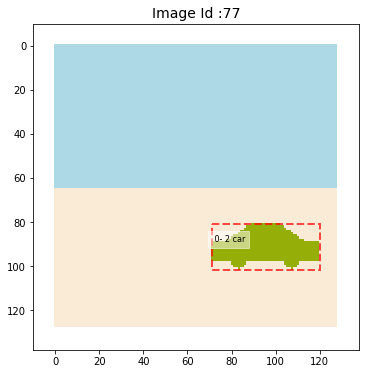

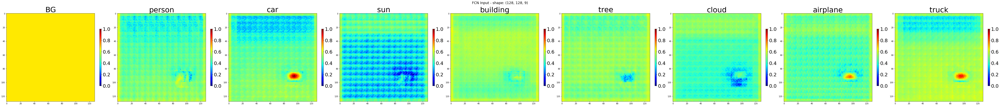

  FCN BBox Information - classes   --  :  [    2.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   2 car             ( 81.00, 71.00)  (102.00,120.00) |  95.50/ 91.50    49.00~  21.00  1029.00   70.00 |   4

In [145]:
dataset_test.image_info[image_id]['shapes'] = []

dataset_test.image_info[image_id]['shapes'].append(large_car)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

 Image_id    :  77  Reference:  [('car', (150.0, 174.0, 8.0), (95, 93, 24, 12)), ('person', (139.0, 69.0, 19.0), (30, 90, 2, 10))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         2          1]
 Class Names :  ['car', 'person']


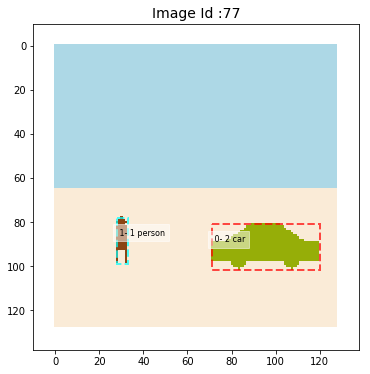

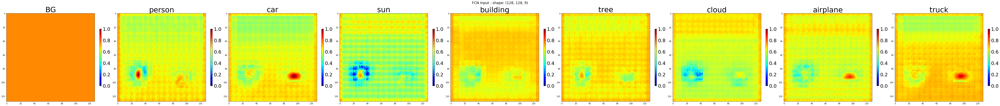

  FCN BBox Information - classes   --  :  [    1.0000     2.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   2 car             ( 81.00, 71.00)  (102.00,120.00) |  95.50/ 91.50    49.00~  21.00  1029.00   

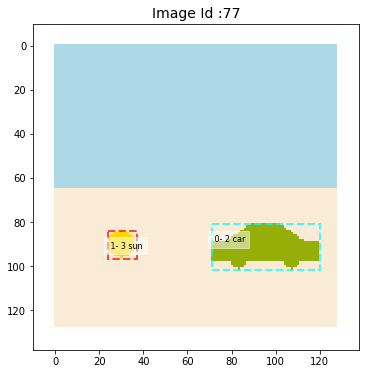

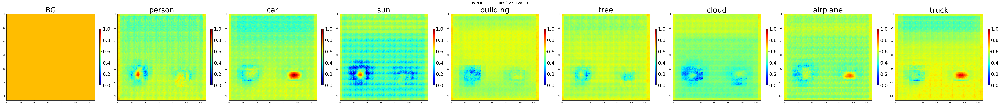

  FCN BBox Information - classes   --  :  [    2.0000     3.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   3 sun             ( 84.00, 24.00)  ( 97.00, 37.00) |  30.50/ 90.50    13.00~  13.00   169.00   

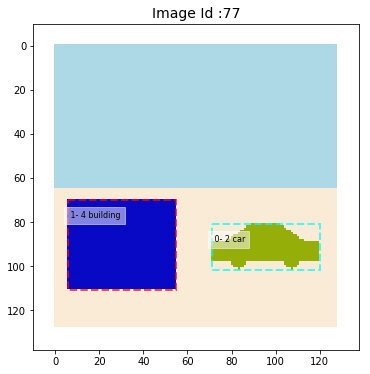

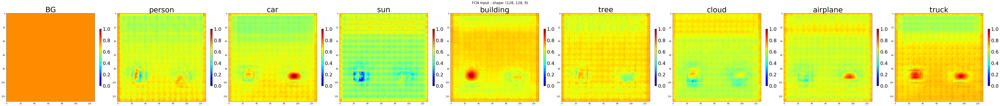

  FCN BBox Information - classes   --  :  [    2.0000     4.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   4 building        ( 70.00,  6.00)  (111.00, 55.00) |  30.50/ 90.50    49.00~  41.00  2009.00  1

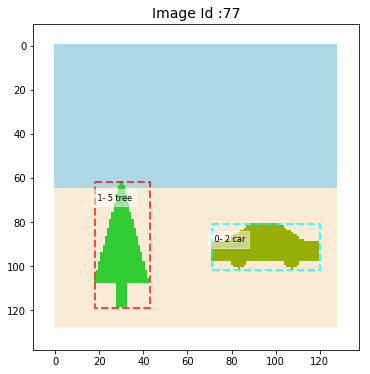

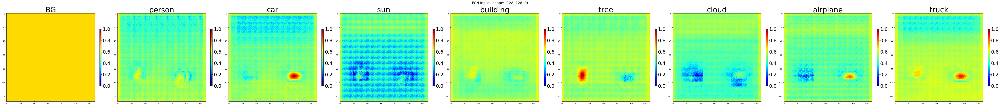

  FCN BBox Information - classes   --  :  [    2.0000     5.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   5 tree            ( 62.00, 18.00)  (119.00, 43.00) |  30.50/ 90.50    25.00~  57.00  1425.00   

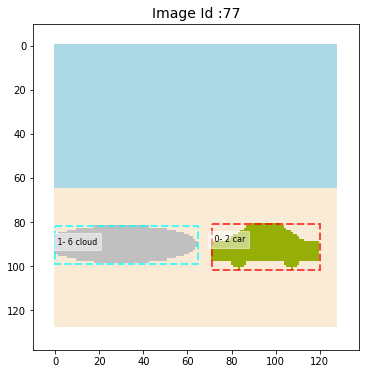

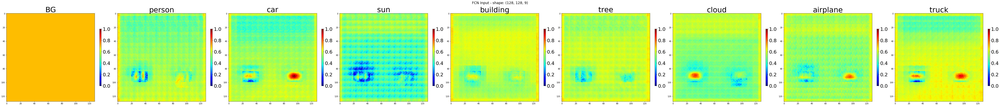

  FCN BBox Information - classes   --  :  [    2.0000     6.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   2 car             ( 81.00, 71.00)  (102.00,120.00) |  95.50/ 91.50    49.00~  21.00  1029.00   

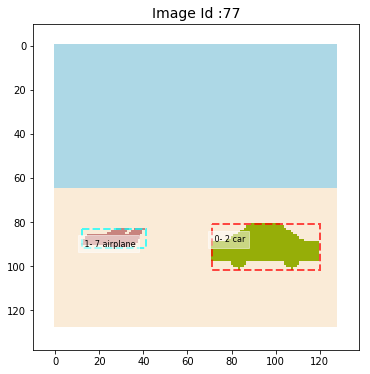

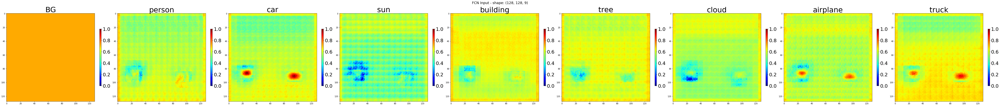

  FCN BBox Information - classes   --  :  [    2.0000     7.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   7 airplane        ( 83.00, 12.00)  ( 92.00, 41.00) |  26.50/ 87.50    29.00~   9.00   261.00   

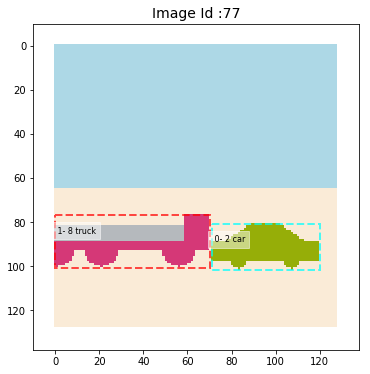

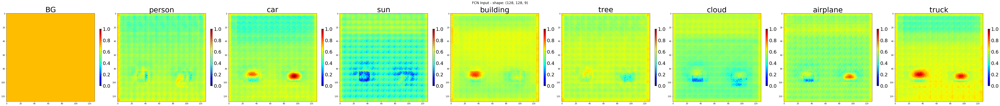

  FCN BBox Information - classes   --  :  [    2.0000     8.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   2 car             ( 81.00, 71.00)  (102.00,120.00) |  95.50/ 91.50    49.00~  21.00  1029.00   

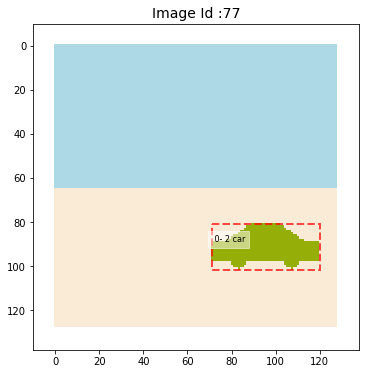

In [146]:
dataset_test.image_info[image_id]['shapes'].append(person)

vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = sun
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = building
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = tree
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = cloud
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = airplane
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = truck
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

# dataset_test.image_info[image_id]['shapes'][-1] = car
# vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
# r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
# vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)


del dataset_test.image_info[image_id]['shapes'][-1]
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)



####  Image 77 : Building
Building without airplane. 
Add Airplane on left side and note changes in scores 

In [163]:
cx = 30
cy = 30
airplane  = ('airplane', (200.0, 132.0, 126.0), (cx , cy, 18,  7))
person    = ('person'  , (139.0, 69.0, 19.0)  , (cx , cy,  2, 10))
car       = ('car'     , (150.0, 174.0, 8.0)  , (cx , cy, 24, 12))
sun       = ('sun'     , (255.0, 215.0, 0.0)  , (cx , cy,  6,  6))
building  = ('building', (7.0, 9.0, 197.0)    , (cx , cy, 24, 20))
tree      = ('tree'    , (50.0, 205.0, 50.0)  , (cx , cy, 12, 28))
cloud     = ('cloud'   , (192.0, 192.0, 192.0), (cx , cy, 34,  8))
truck     = ('truck'   , (213.0, 56.0, 119.0) , (cx , cy, 39, 13))

 Image_id    :  77  Reference:  [('building', (7.0, 9.0, 197.0), (95, 93, 24, 12))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (1,)    [         4]
 Class Names :  ['building']


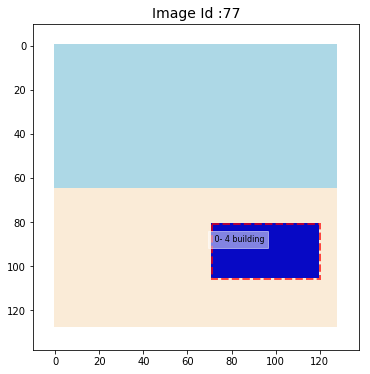

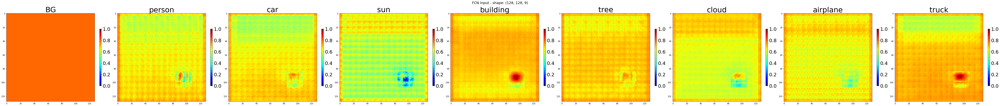

  FCN BBox Information - classes   --  :  [    4.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   4 building        ( 81.00, 71.00)  (106.00,120.00) |  95.50/ 93.50    49.00~  25.00  1225.00   80.00 |   4

In [166]:
building  = ('building', (7.0, 9.0, 197.0), (95, 93, 24, 12))

dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(building)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

 Image_id    :  77  Reference:  [('building', (7.0, 9.0, 197.0), (95, 93, 24, 12)), ('airplane', (200.0, 132.0, 126.0), (30, 30, 18, 7))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         4          7]
 Class Names :  ['building', 'airplane']


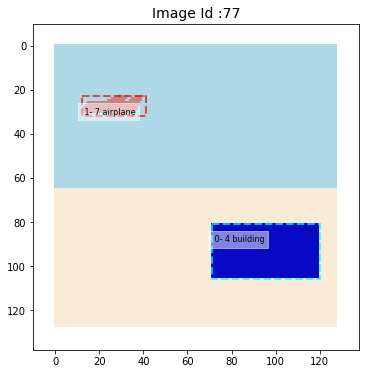

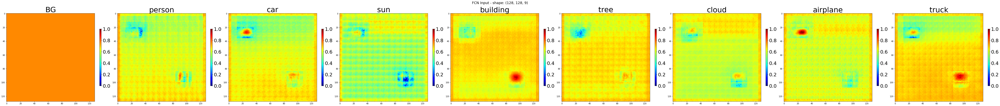

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  4 building           | 1 | 0.9324  1.0000 |   0.9996  1225.0    0.9996 |  54.8986    80.0    0.6862  1.0000 | 

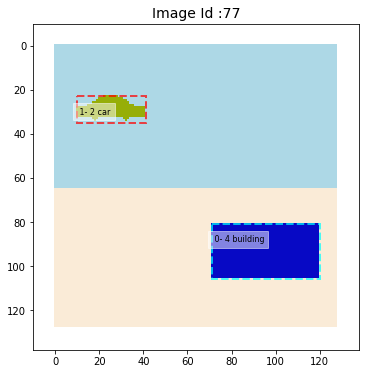

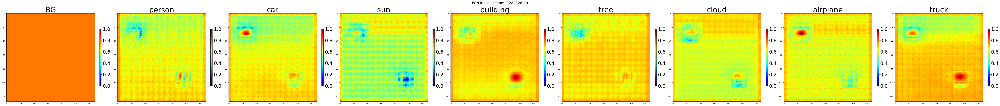

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  4 building           | 1 | 0.9324  1.0000 |   0.9996  1225.0    0.9996 |  54.8986    80.0    0.6862  1.0000 | 

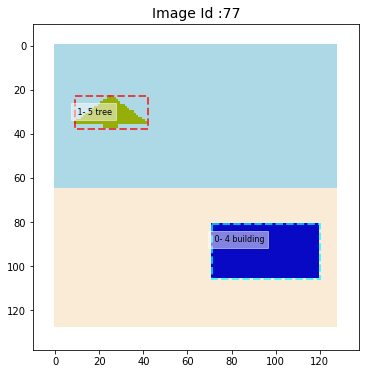

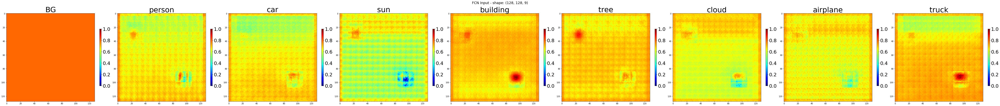

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  5 tree               | 1 | 0.9385  1.0000 |   0.9932   495.0    0.9932 |  36.4552    54.0    0.6751  1.0000 | 

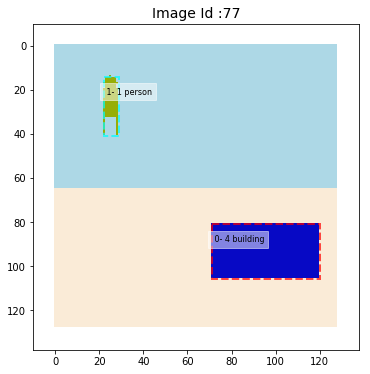

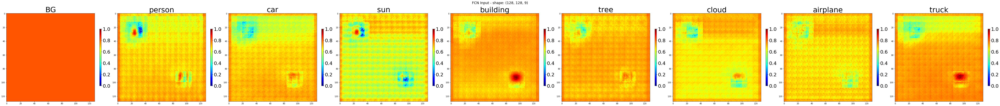

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  4 building           | 1 | 0.9324  1.0000 |   0.9996  1225.0    0.9996 |  54.8986    80.0    0.6862  1.0000 | 

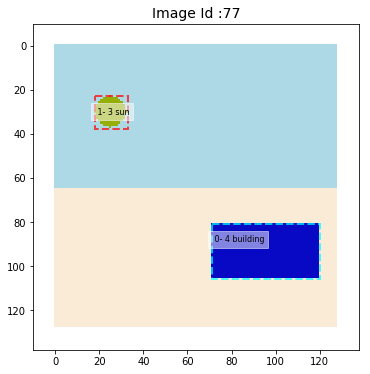

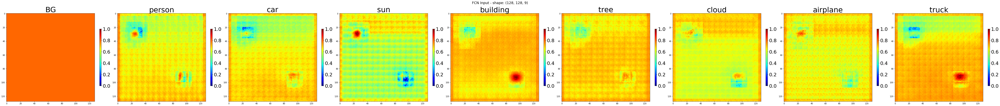

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  3 sun                | 1 | 0.9475  1.0000 |   0.9866   225.0    0.9866 |  23.7169    36.0    0.6588  1.0000 | 

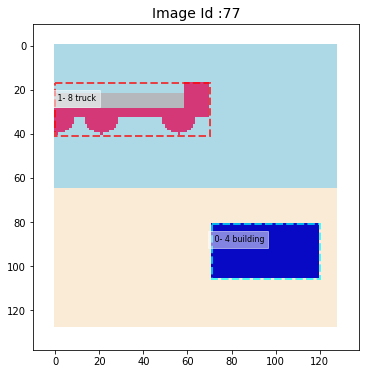

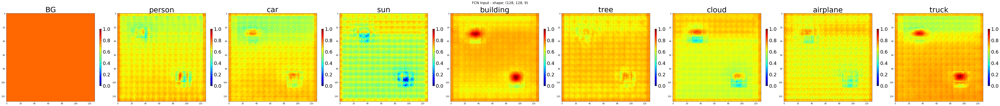

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  4 building           | 1 | 0.9324  1.0000 |   0.9996  1225.0    0.9996 |  54.8986    80.0    0.6862  1.0000 | 

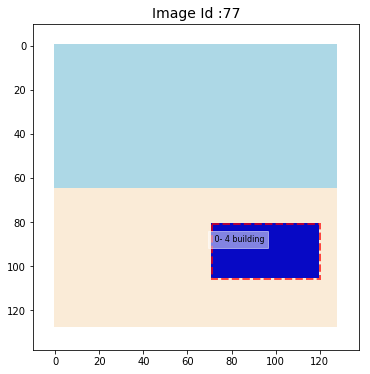

In [167]:
dataset_test.image_info[image_id]['shapes'].append(airplane)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


dataset_test.image_info[image_id]['shapes'][-1] =  ('car', (150.0, 174.0, 8.0), (25, 30, 15, 7))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


 
dataset_test.image_info[image_id]['shapes'][-1] =  ('tree', (150.0, 174.0, 8.0), (25, 30, 16, 7))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


dataset_test.image_info[image_id]['shapes'][-1] =  ('person', (150.0, 174.0, 8.0), (25, 30, 3, 13))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


dataset_test.image_info[image_id]['shapes'][-1] =  ('sun', (150.0, 174.0, 8.0), (25, 30, 7, 7))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


# dataset_test.image_info[image_id]['shapes'][-1] =  ('building', (150.0, 174.0, 8.0), (25, 30, 7, 7))
# vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
# r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

# vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# # vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
# vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = ('truck'   , (213.0, 56.0, 119.0) , (cx , cy, 39, 13))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

del dataset_test.image_info[image_id]['shapes'][-1]
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

####  Car - moving airplane

77
 Image_id    :  77  Reference:  [('car', (150.0, 174.0, 8.0), (95, 93, 24, 12)), ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         2          7]
 Class Names :  ['car', 'airplane']

FCN_SCORES:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |         FCN score 0        |            FCN score 1             |            FCN score 2             |                         
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   |                         
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in m

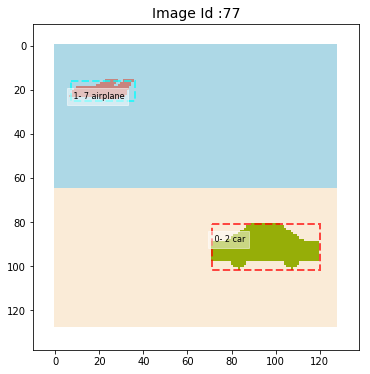

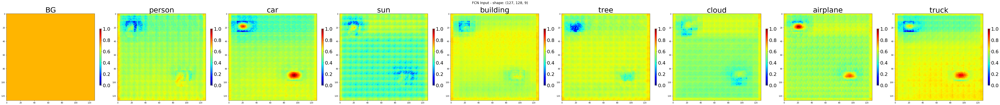

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

In [83]:
print(image_id)
large_car = ('car', (150.0, 174.0, 8.0), (95, 93, 24, 12))
airplane = ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))

dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(large_car)
dataset_test.image_info[image_id]['shapes'].append(airplane)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
vis2.display_pr_fcn_scores(r[0], class_names)

----------------------------------------------------------------------------------------------------
 CY:  10
----------------------------------------------------------------------------------------------------


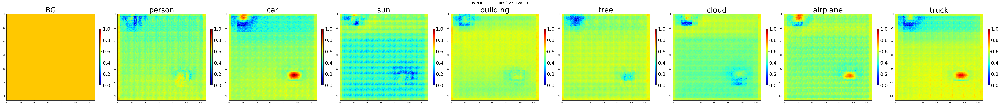

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

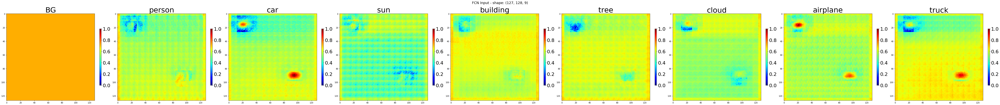

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

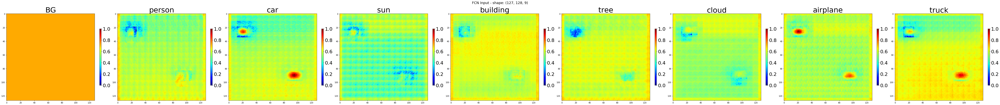

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

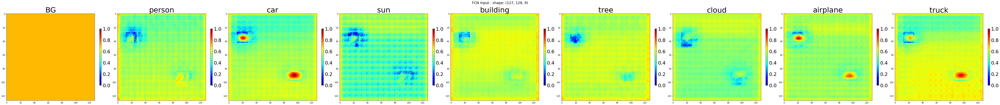

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

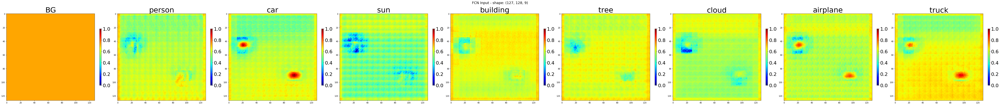

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

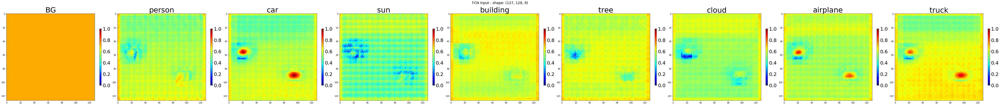

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

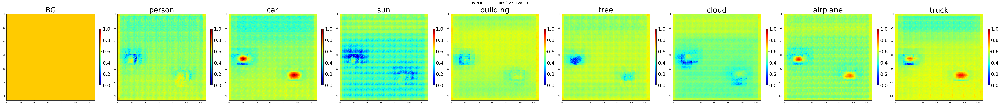

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

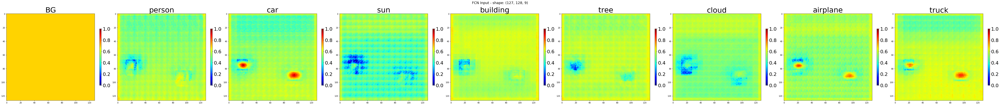

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

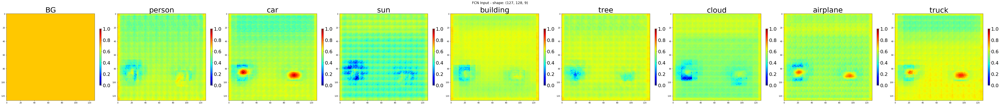

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

In [87]:
only = None
cx = 25

for cy in range(10, 100, 10):    
    airplane = ('airplane', (200.0, 132.0, 126.0), (cx, cy, 18, 7))
    dataset_test.image_info[image_id]['shapes'][-1] = airplane
#     r = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
    print('-'*100)
    print(' CY: ', cy)
    print('-'*100)
#     vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_scores(r[0]['fcn_scores'], class_names, only = only, display = True)
    vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
    vis2.display_pr_fcn_scores(r[0], class_names)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)

###  Image 77 : Truck and other objects 
Truck without airplane. 
Add Airplane on left side and note changes in scores 

##### Add airplane and other objects. 

Is Truck only sensitive to airplanes , or is it invariant to the class of the object?

In [173]:
# airplane  = ('airplane', (200.0, 132.0, 126.0), (25 , 30, 18,  7))
# person    = ('person'  , (139.0, 69.0, 19.0)  , (17 , 92,  2, 10))
# car       = ('car'     , (150.0, 174.0, 8.0)  , (87 , 93, 24, 12))
# sun       = ('sun'     , (255.0, 215.0, 0.0)  , (49 , 13,  6,  6))
# building  = ('building', (7.0, 9.0, 197.0)    , (92 , 60, 24, 20))
# tree      = ('tree'    , (50.0, 205.0, 50.0)  , (100, 91, 12, 28))
# cloud     = ('cloud'   , (192.0, 192.0, 192.0), (106, 20, 34,  8))
# truck     = ('truck'   , (213.0, 56.0, 119.0) , (80 , 93, 39, 13))
# large_car = ('car'     , (150.0, 174.0, 8.0)  , (95 , 93, 24, 12))

cx = 30
cy = 90
airplane  = ('airplane', (200.0, 132.0, 126.0), (cx , cy, 18,  7))
person    = ('person'  , (139.0, 69.0, 19.0)  , (cx , cy,  2, 10))
car       = ('car'     , (150.0, 174.0, 8.0)  , (cx , cy, 24, 12))
sun       = ('sun'     , (255.0, 215.0, 0.0)  , (cx , cy,  6,  6))
building  = ('building', (7.0, 9.0, 197.0)    , (cx , cy, 24, 20))
tree      = ('tree'    , (50.0, 205.0, 50.0)  , (cx , cy, 12, 28))
cloud     = ('cloud'   , (192.0, 192.0, 192.0), (cx , cy, 34,  8))
truck     = ('truck'   , (213.0, 56.0, 119.0) , (cx , cy, 39, 13))
large_car = ('car'     , (150.0, 174.0, 8.0)  , (95 , 93, 24, 12))

 Image_id    :  77  Reference:  [('truck', (213.0, 56.0, 119.0), (95, 93, 24, 12))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (1,)    [         8]
 Class Names :  ['truck']


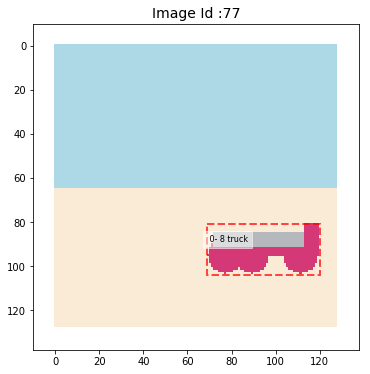

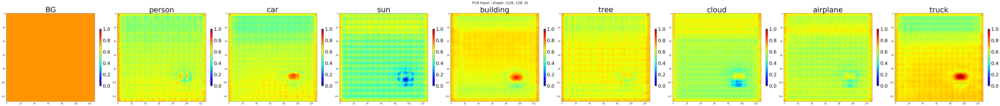

  FCN BBox Information - classes   --  :  [    8.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   8 truck           ( 81.00, 69.00)  (104.00,120.00) |  94.50/ 92.50    51.00~  23.00  1173.00   77.00 |   5

In [179]:
truck     = ('truck', (213.0, 56.0, 119.0), (95, 93, 24, 12)) 

dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(truck)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

 Image_id    :  77  Reference:  [('truck', (213.0, 56.0, 119.0), (95, 93, 24, 12)), ('person', (139.0, 69.0, 19.0), (30, 90, 2, 10))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         8          1]
 Class Names :  ['truck', 'person']


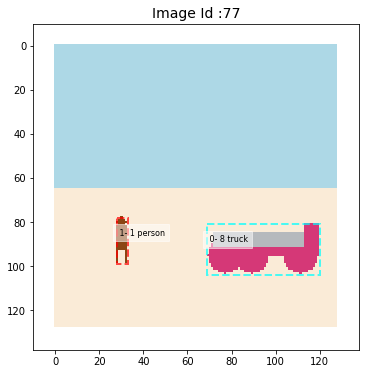

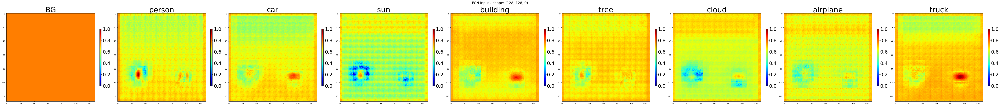

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  1 person             | 1 | 0.9054  1.0000 |   0.8729   105.0    0.8729 |  17.4903    28.0    0.6247  1.0000 | 

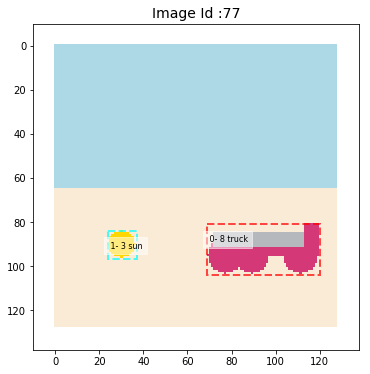

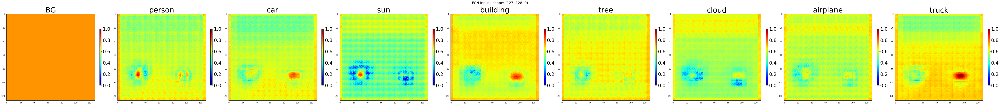

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  3 sun                | 1 | 0.9475  1.0000 |   0.9766   169.0    0.9766 |  22.4905    36.0    0.6247  1.0000 | 

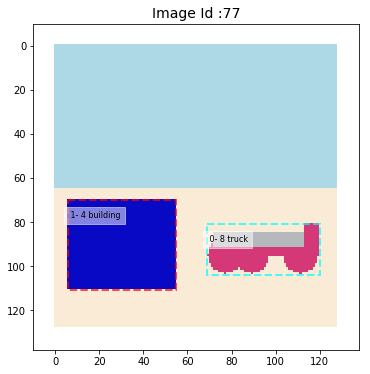

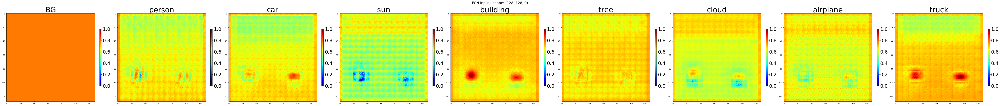

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  4 building           | 1 | 0.9324  1.0000 |   1.0000  2009.0    1.0000 |  69.5590   100.0    0.6956  1.0000 | 

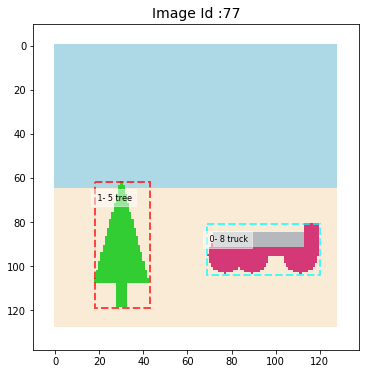

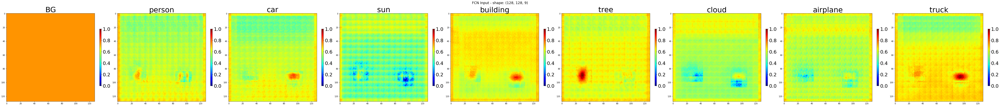

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  5 tree               | 1 | 0.9385  1.0000 |   0.9996  1425.0    0.9996 |  60.6620    88.0    0.6893  1.0000 | 

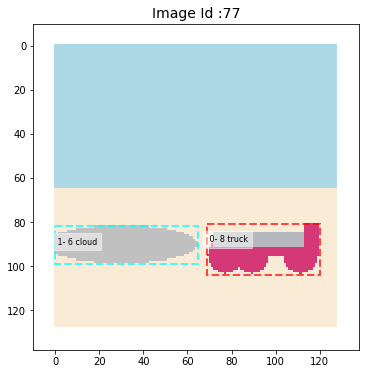

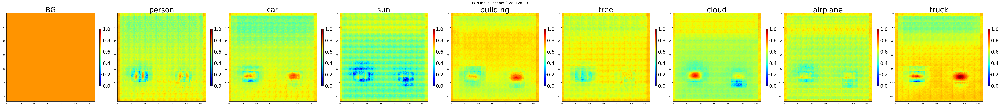

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  6 cloud              | 1 | 0.8971  1.0000 |   0.9961  1105.0    0.9961 |  49.9946    72.0    0.6944  1.0000 | 

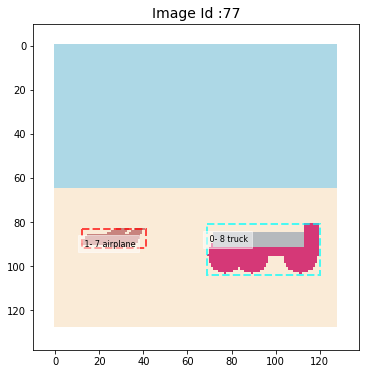

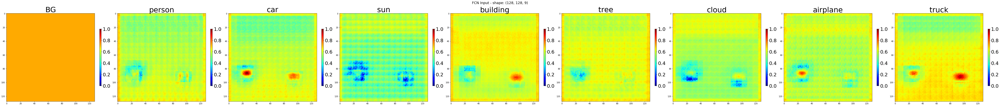

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

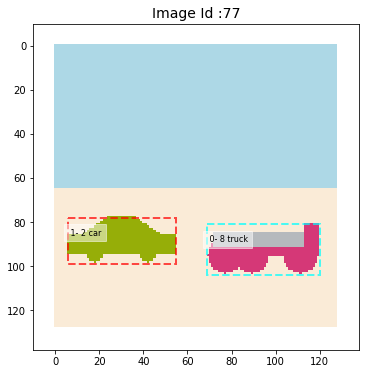

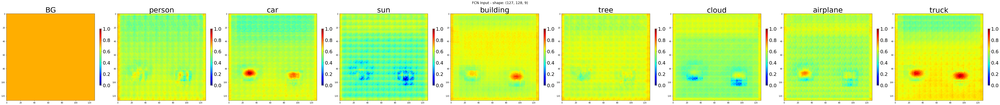

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  2 car                | 1 | 0.9115  1.0000 |   0.9987  1029.0    0.9987 |  49.8077    70.0    0.7115  1.0000 | 

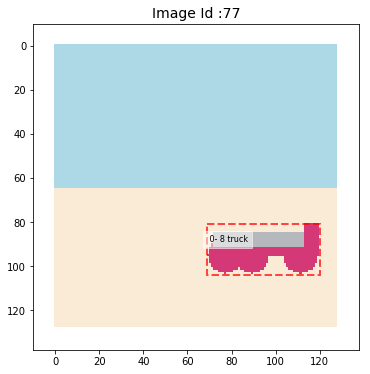

In [175]:
dataset_test.image_info[image_id]['shapes'].append(person)

vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = sun
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = building
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = tree
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = cloud
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = airplane
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

# dataset_test.image_info[image_id]['shapes'][-1] = truck
# vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
# r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
# vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
# vis2.display_pr_fcn_scores(r[0], class_names)

dataset_test.image_info[image_id]['shapes'][-1] = car
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


del dataset_test.image_info[image_id]['shapes'][-1]
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)



##### Add other objects in the same position an airplane would appear. 

Is Truck only sensitive to airplanes , or is it invariant to the class towards the object?

In [182]:
cx = 30
cy = 30
airplane  = ('airplane', (200.0, 132.0, 126.0), (cx , cy, 18,  7))
person    = ('person'  , (139.0, 69.0, 19.0)  , (cx , cy,  2, 10))
car       = ('car'     , (150.0, 174.0, 8.0)  , (cx , cy, 24, 12))
sun       = ('sun'     , (255.0, 215.0, 0.0)  , (cx , cy,  6,  6))
building  = ('building', (7.0, 9.0, 197.0)    , (cx , cy, 24, 20))
tree      = ('tree'    , (50.0, 205.0, 50.0)  , (cx , cy, 12, 28))
cloud     = ('cloud'   , (192.0, 192.0, 192.0), (cx , cy, 34,  8))
truck     = ('truck'   , (213.0, 56.0, 119.0) , (cx , cy, 39, 13))
large_car = ('car'     , (150.0, 174.0, 8.0)  , (95 , 93, 24, 12))

 Image_id    :  77  Reference:  [('truck', (213.0, 56.0, 119.0), (95, 93, 24, 12))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (1,)    [         8]
 Class Names :  ['truck']


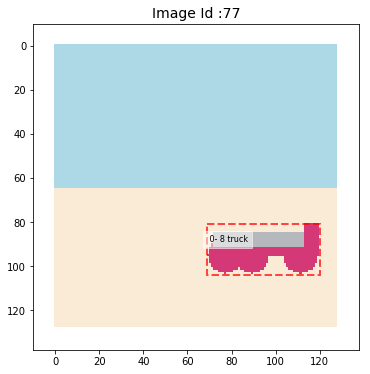

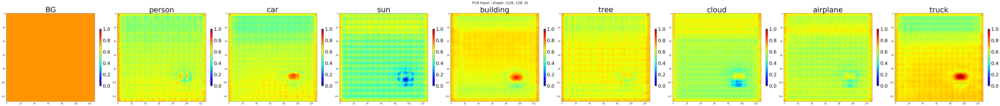

  FCN BBox Information - classes   --  :  [    8.0000]
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                         |                                                 |    (COVAR)    |               CLIP REGION   
BOX     class                                            |                   Width   Height                |      SQRT     |      FROM/TO               FROM/TO 
seq  id     name              Y1/X1              Y2/X2   |    CX / CY         (W)  ~  (H)      AREA        |  W/2     H/2  |  X1/Y1    X2/Y2   A |  X1/Y1   X2/Y2   A
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 64   8 truck           ( 81.00, 69.00)  (104.00,120.00) |  94.50/ 92.50    51.00~  23.00  1173.00   77.00 |   5

In [181]:
truck     = ('truck', (213.0, 56.0, 119.0), (95, 93, 24, 12))

dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(truck)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)

 Image_id    :  77  Reference:  [('truck', (213.0, 56.0, 119.0), (95, 93, 24, 12)), ('airplane', (200.0, 132.0, 126.0), (30, 30, 18, 7))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         8          7]
 Class Names :  ['truck', 'airplane']


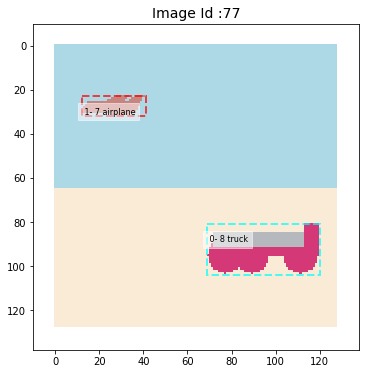

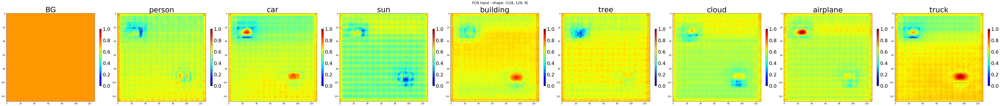

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

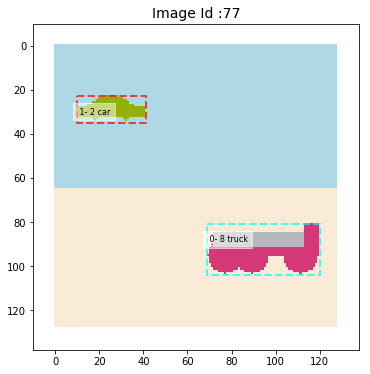

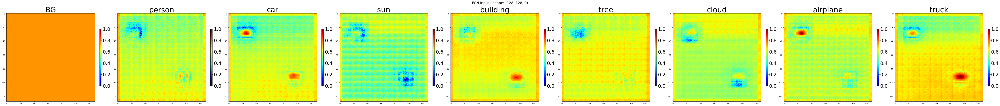

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  2 car                | 1 | 0.9115  1.0000 |   0.9843   372.0    0.9843 |  27.1018    40.0    0.6775  1.0000 | 

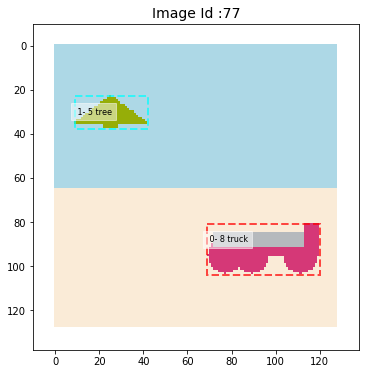

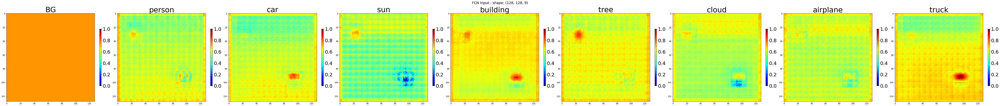

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  5 tree               | 1 | 0.9385  1.0000 |   0.9932   495.0    0.9932 |  36.4552    54.0    0.6751  1.0000 | 

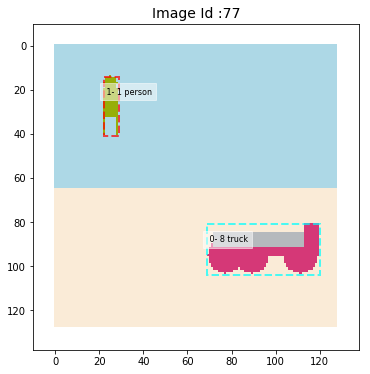

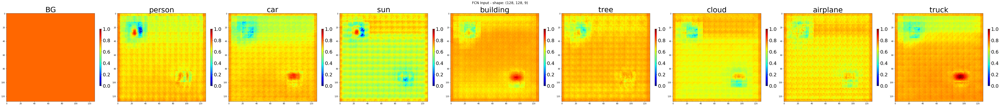

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  1 person             | 1 | 0.9054  1.0000 |   0.9322   189.0    0.9322 |  20.8864    32.0    0.6527  1.0000 | 

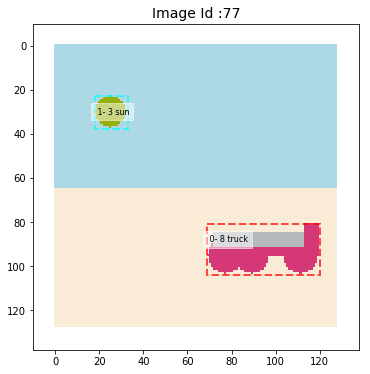

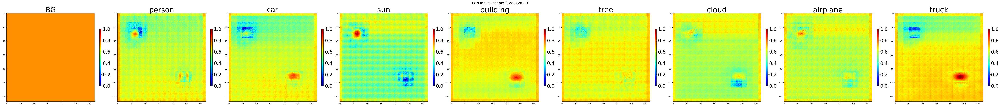

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  3 sun                | 1 | 0.9475  1.0000 |   0.9866   225.0    0.9866 |  23.7169    36.0    0.6588  1.0000 | 

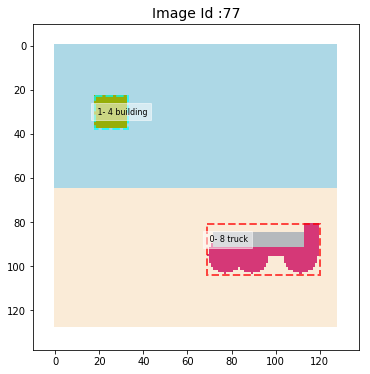

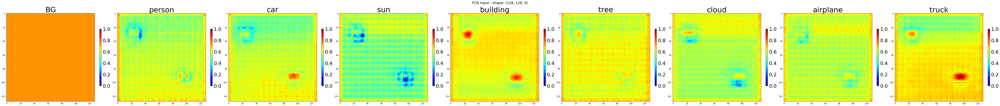

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  4 building           | 1 | 0.9324  1.0000 |   0.9866   225.0    0.9866 |  23.7169    36.0    0.6588  1.0000 | 

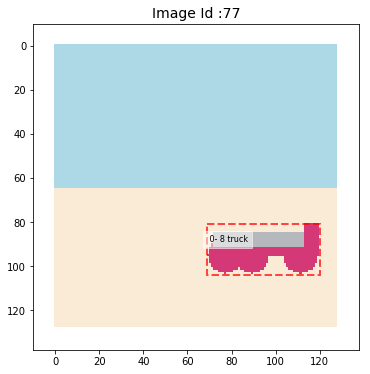

In [183]:
dataset_test.image_info[image_id]['shapes'].append(airplane)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


dataset_test.image_info[image_id]['shapes'][-1] =  ('car', (150.0, 174.0, 8.0), (25, 30, 15, 7))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


 
dataset_test.image_info[image_id]['shapes'][-1] =  ('tree', (150.0, 174.0, 8.0), (25, 30, 16, 7))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


dataset_test.image_info[image_id]['shapes'][-1] =  ('person', (150.0, 174.0, 8.0), (25, 30, 3, 13))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


dataset_test.image_info[image_id]['shapes'][-1] =  ('sun', (150.0, 174.0, 8.0), (25, 30, 7, 7))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)


dataset_test.image_info[image_id]['shapes'][-1] =  ('building', (150.0, 174.0, 8.0), (25, 30, 7, 7))
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False) 

vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm']), class_names, columns = cols, size = 8)
# vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names, only = only)
vis2.display_pr_fcn_scores(r[0], class_names)



del dataset_test.image_info[image_id]['shapes'][-1]
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

###  Truck - vertically moving objects (airplane, ..)

77
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         8          7]
 Class Names :  ['truck', 'airplane']


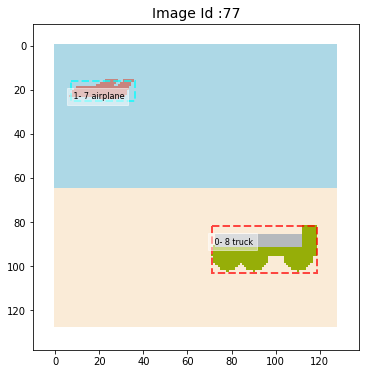

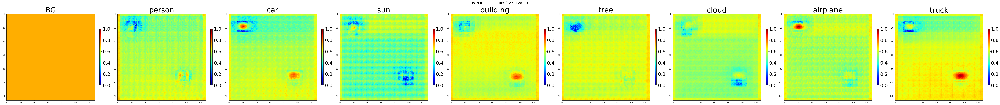

PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  0  64  7 airplane           | 1 | 0.9164  1.0000 |   0.9627   261.0    0.9627 |  27.3879    40.0    0.6847  1.0000 | 

In [297]:
print(image_id)
truck = ('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11))
airplane = ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))

dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(truck)
dataset_test.image_info[image_id]['shapes'].append(airplane)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
# r = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
vis2.display_pr_fcn_scores(r[0], class_names)

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (25, 5, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 7]
 Class Names :  ['truck', 'airplane']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (25, 15, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 7]
 Class Names :  ['truck', 'airplane']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (25, 25, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 7]
 Class Names :  ['truck', 'airplane']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (25, 35, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 12

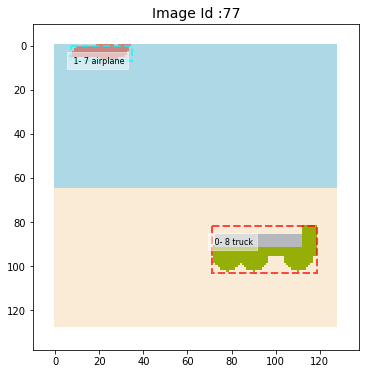

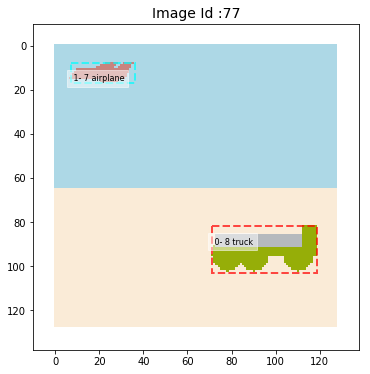

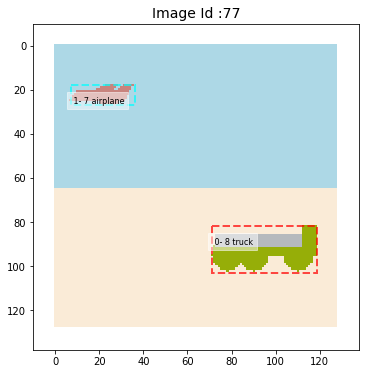

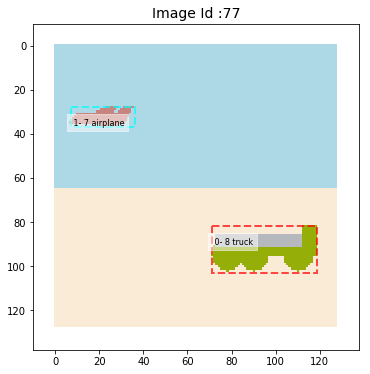

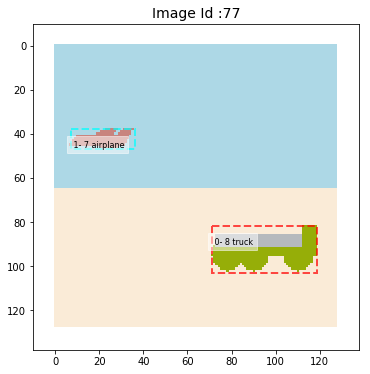

...

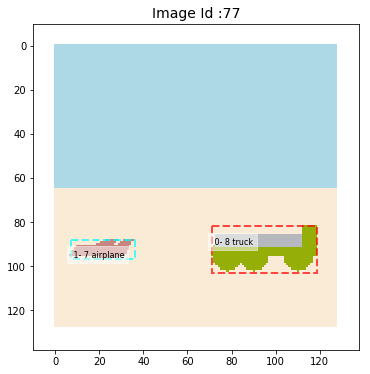

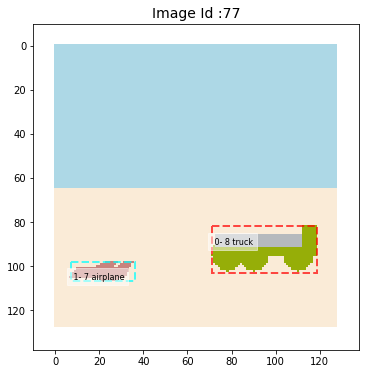

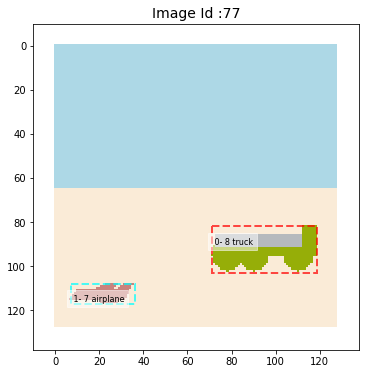

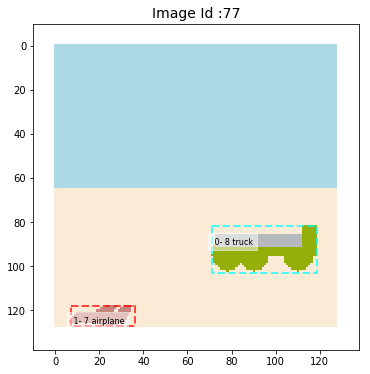

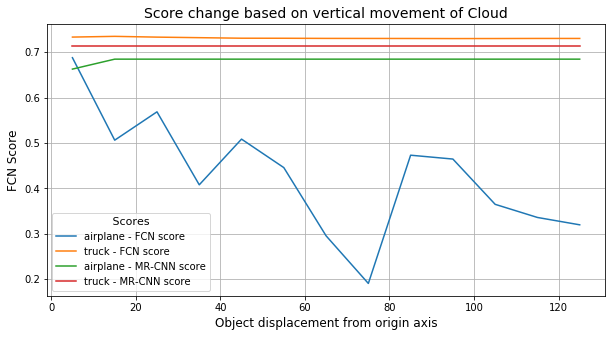

In [310]:
only = None
cx = 25
scores_airplane  = {}
baseline_scores = {}
xy_movement = np.arange(5,130,10)
for cy in xy_movement:    
    airplane = ('airplane', (200.0, 132.0, 126.0), (cx, cy, 18, 7))
    dataset_test.image_info[image_id]['shapes'][-1] = airplane
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     r = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     print('-'*100)
#     print(' CY: ', cy)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_pr_fcn_scores(r[0], class_names)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in scores_airplane:
            scores_airplane[cls_name] = []
            baseline_scores[cls_name] = []
        scores_airplane[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(scores_airplane)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, scores_airplane, baseline_scores, class_names, title = 'Score change based on vertical movement of Cloud')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('cloud', (200.0, 132.0, 126.0), (25, 5, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 6]
 Class Names :  ['truck', 'cloud']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('cloud', (200.0, 132.0, 126.0), (25, 15, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 6]
 Class Names :  ['truck', 'cloud']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('cloud', (200.0, 132.0, 126.0), (25, 25, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 6]
 Class Names :  ['truck', 'cloud']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('cloud', (200.0, 132.0, 126.0), (25, 35, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128

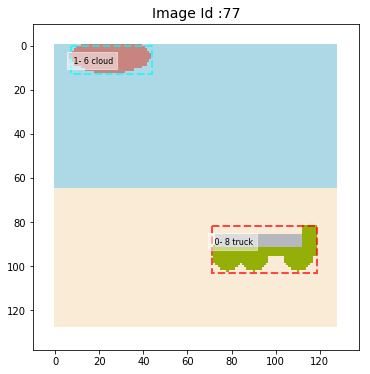

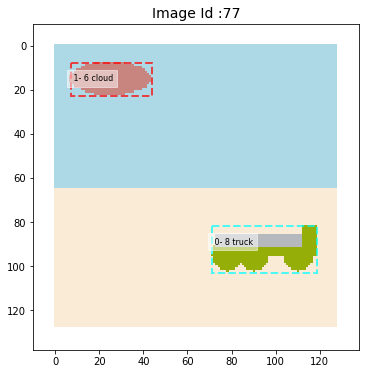

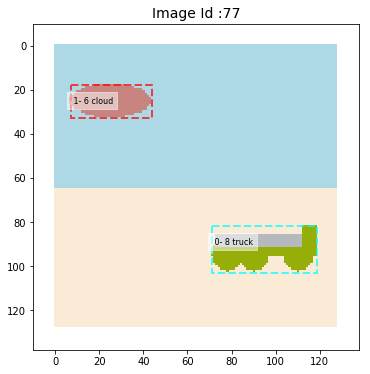

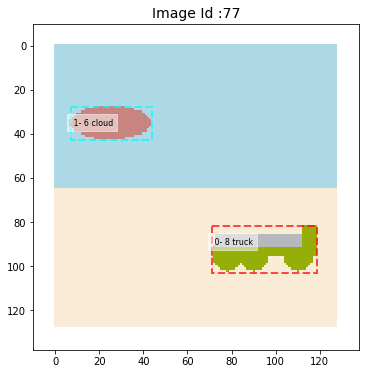

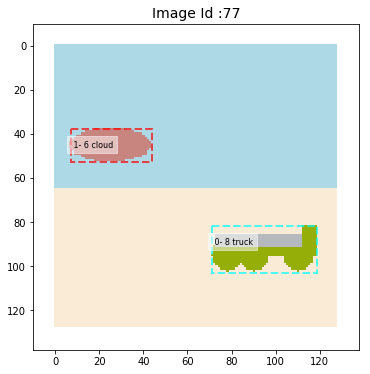

...

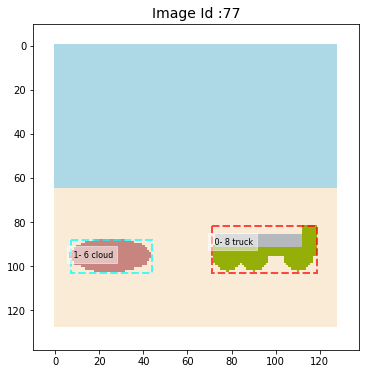

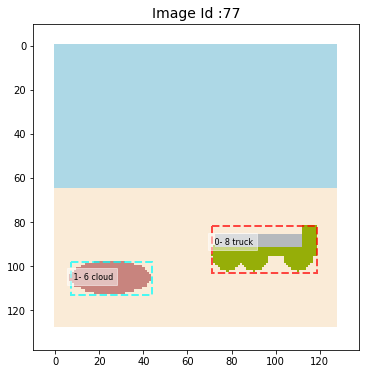

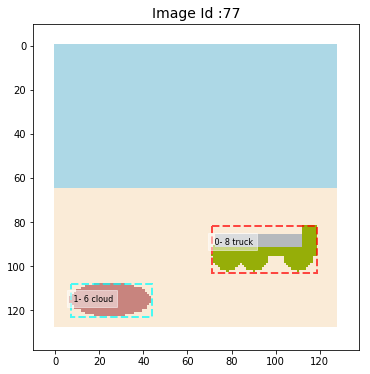

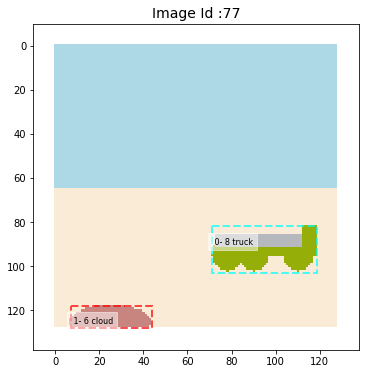

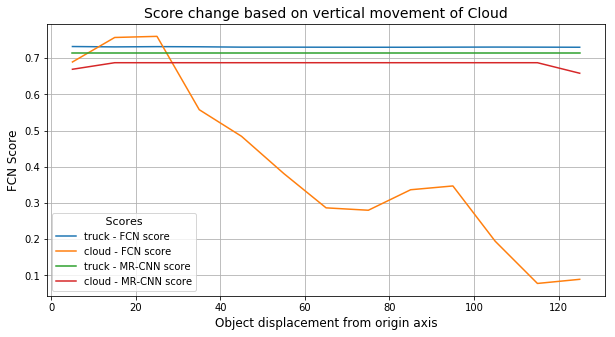

In [311]:
scores_cloud  = {}
baseline_scores = {}
xy_movement = np.arange(5,130,10)
for cy in xy_movement:    
    cloud = ('cloud', (200.0, 132.0, 126.0), (cx, cy, 18, 7))
    dataset_test.image_info[image_id]['shapes'][-1] = cloud
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     print('-'*100)
#     print(' CY: ', cy)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_pr_fcn_scores(r[0], class_names)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in scores_cloud:
            scores_cloud[cls_name] = []
            baseline_scores[cls_name] = []
        scores_cloud[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(scores_cloud)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, scores_cloud, baseline_scores, class_names, title = 'Score change based on vertical movement of Cloud')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('sun', (255.0, 215.0, 0.0), (25, 5, 6, 6))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 3]
 Class Names :  ['truck', 'sun']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('sun', (255.0, 215.0, 0.0), (25, 15, 6, 6))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 3]
 Class Names :  ['truck', 'sun']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('sun', (255.0, 215.0, 0.0), (25, 25, 6, 6))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 3]
 Class Names :  ['truck', 'sun']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('sun', (255.0, 215.0, 0.0), (25, 35, 6, 6))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  

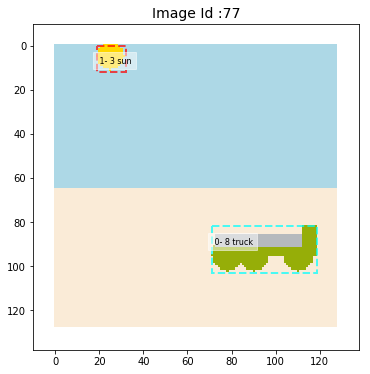

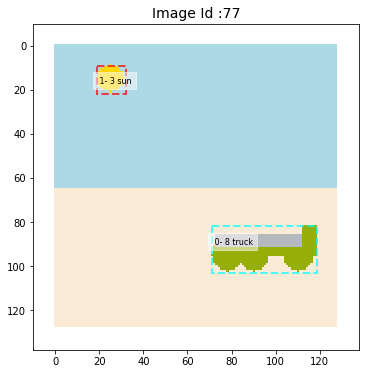

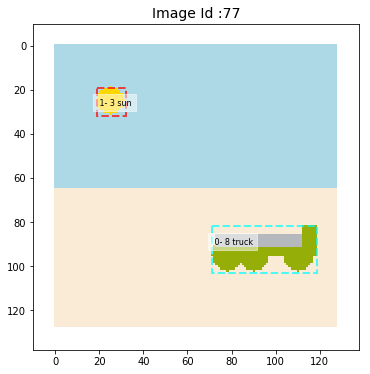

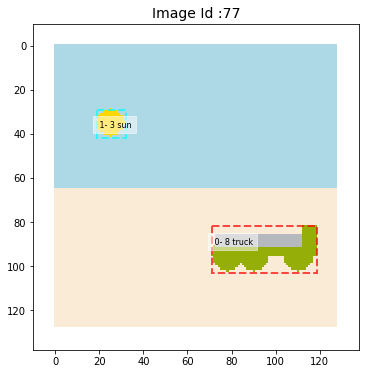

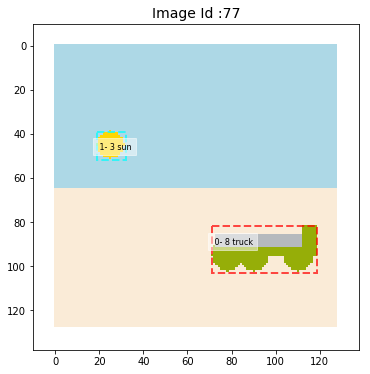

...

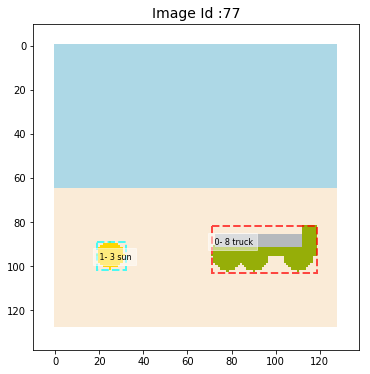

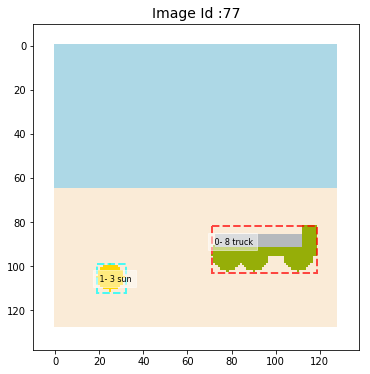

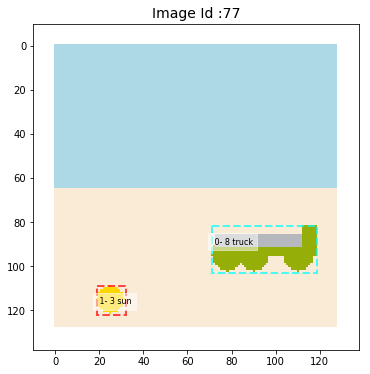

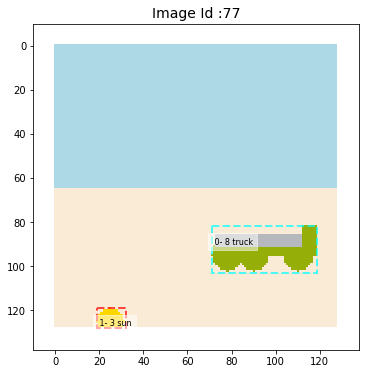

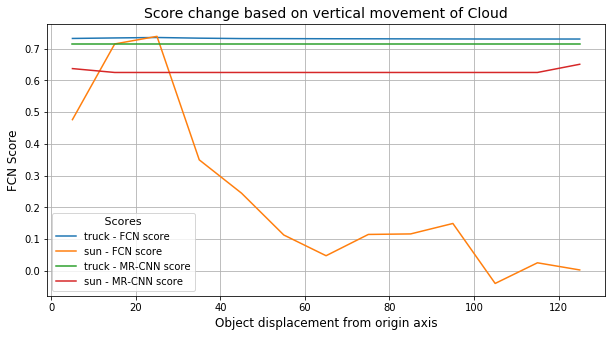

In [313]:
scores_sun  = {}
baseline_scores = {}
xy_movement = np.arange(5,130,10)
for cy in xy_movement:    
    sun       = ('sun'     , (255.0, 215.0, 0.0)  , (cx , cy,  6,  6))
    dataset_test.image_info[image_id]['shapes'][-1] = sun
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     print('-'*100)
#     print(' CY: ', cy)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_pr_fcn_scores(r[0], class_names)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in scores_sun:
            scores_sun[cls_name] = []
            baseline_scores[cls_name] = []
        scores_sun[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(scores_sun)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, scores_sun, baseline_scores, class_names, title = 'Score change based on vertical movement of Cloud')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('person', (139.0, 69.0, 19.0), (25, 5, 2, 10))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 1]
 Class Names :  ['truck', 'person']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('person', (139.0, 69.0, 19.0), (25, 15, 2, 10))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 1]
 Class Names :  ['truck', 'person']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('person', (139.0, 69.0, 19.0), (25, 25, 2, 10))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 1]
 Class Names :  ['truck', 'person']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('person', (139.0, 69.0, 19.0), (25, 35, 2, 10))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128 

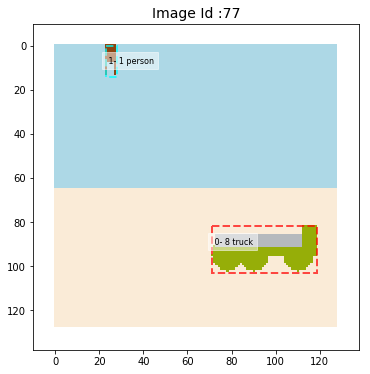

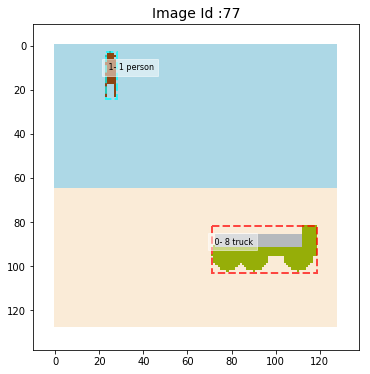

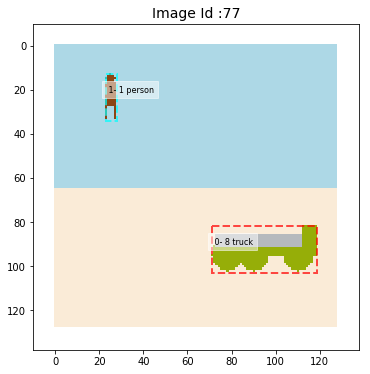

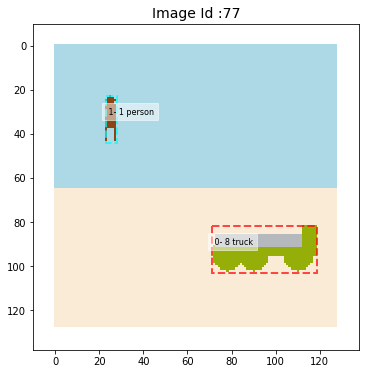

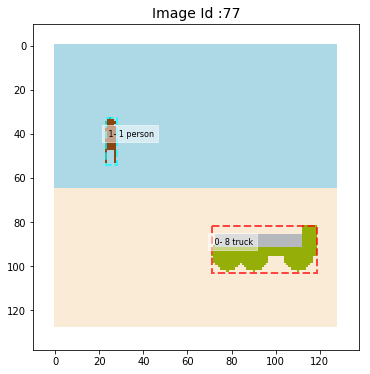

...

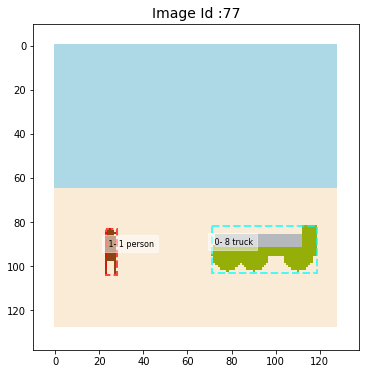

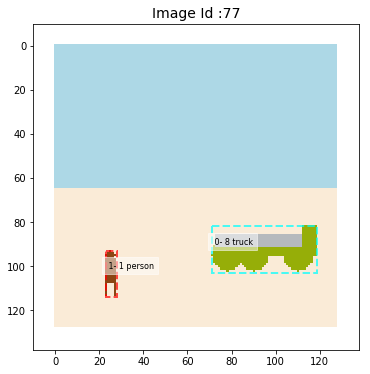

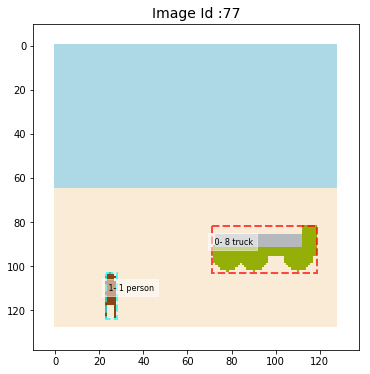

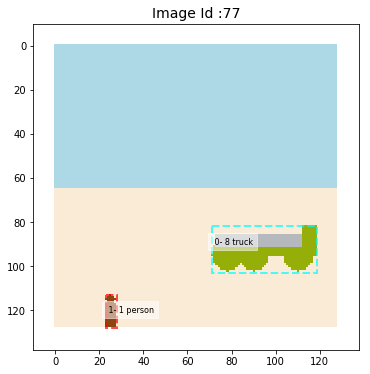

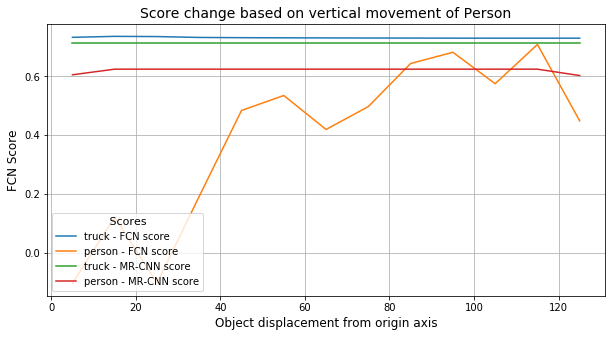

In [315]:
scores_person  = {}
baseline_scores = {}
xy_movement = np.arange(5,130,10)
for cy in xy_movement:    
    person    = ('person'  , (139.0, 69.0, 19.0)  , (cx , cy,  2, 10))
    dataset_test.image_info[image_id]['shapes'][-1] = person
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     print('-'*100)
#     print(' CY: ', cy)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_pr_fcn_scores(r[0], class_names)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in scores_person:
            scores_person[cls_name] = []
            baseline_scores[cls_name] = []
        scores_person[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(scores_person)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, scores_person, baseline_scores, class_names, title = 'Score change based on vertical movement of Person')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('car', (150.0, 174.0, 8.0), (25, 5, 24, 12))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 2]
 Class Names :  ['truck', 'car']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('car', (150.0, 174.0, 8.0), (25, 15, 24, 12))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 2]
 Class Names :  ['truck', 'car']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('car', (150.0, 174.0, 8.0), (25, 25, 24, 12))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 2]
 Class Names :  ['truck', 'car']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('car', (150.0, 174.0, 8.0), (25, 35, 24, 12))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class i

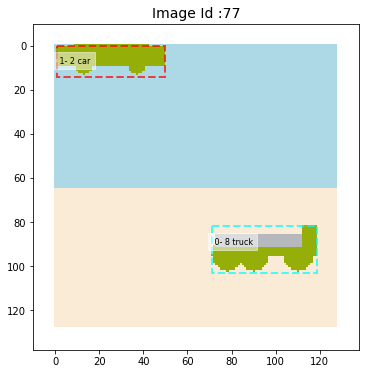

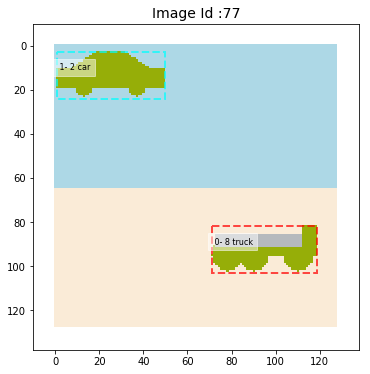

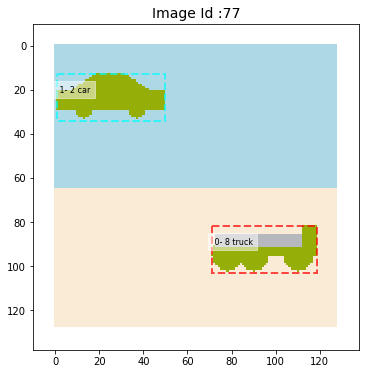

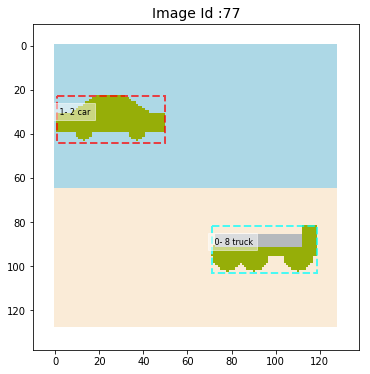

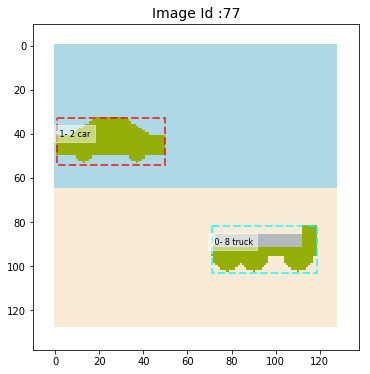

...

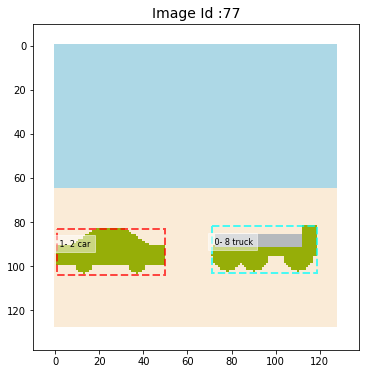

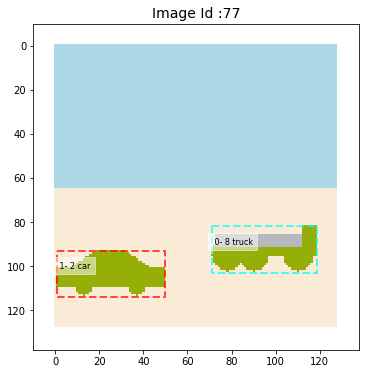

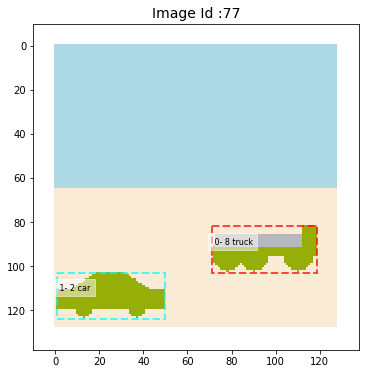

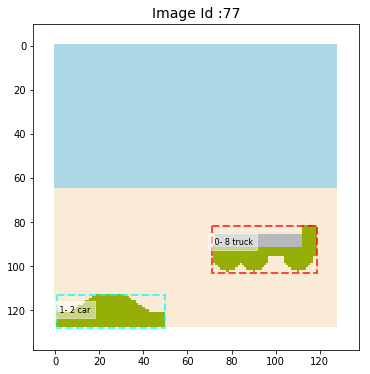

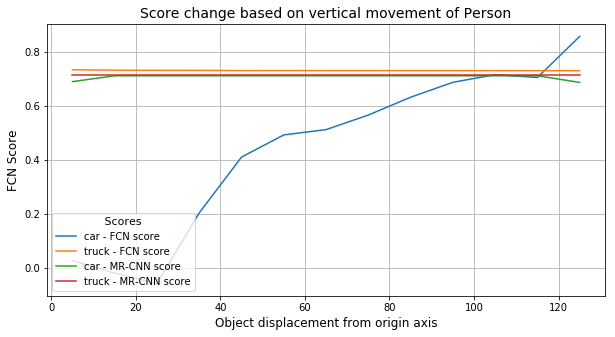

In [318]:
scores_car  = {}
baseline_scores = {}
xy_movement = np.arange(5,130,10)
for cy in xy_movement:    
    car       = ('car'     , (150.0, 174.0, 8.0)  , (cx , cy, 24, 12))
    dataset_test.image_info[image_id]['shapes'][-1] = car
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     print('-'*100)
#     print(' CY: ', cy)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_pr_fcn_scores(r[0], class_names)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in scores_car:
            scores_car[cls_name] = []
            baseline_scores[cls_name] = []
        scores_car[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(scores_car)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, scores_car, baseline_scores, class_names, title = 'Score change based on vertical movement of Person')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('tree', (50.0, 205.0, 50.0), (25, 5, 12, 28))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 5]
 Class Names :  ['truck', 'tree']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('tree', (50.0, 205.0, 50.0), (25, 15, 12, 28))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 5]
 Class Names :  ['truck', 'tree']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('tree', (50.0, 205.0, 50.0), (25, 25, 12, 28))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 5]
 Class Names :  ['truck', 'tree']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('tree', (50.0, 205.0, 50.0), (25, 35, 12, 28))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 

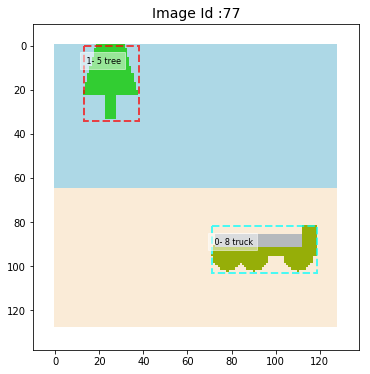

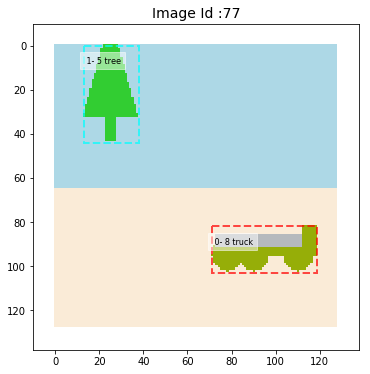

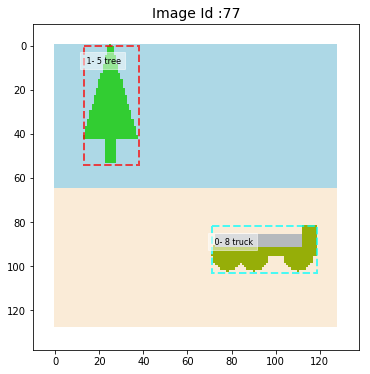

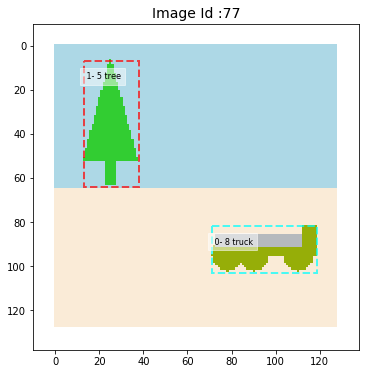

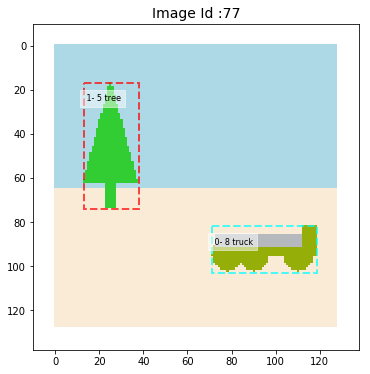

...

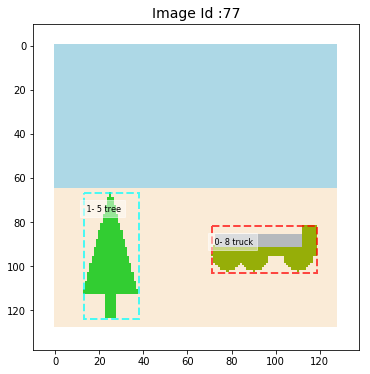

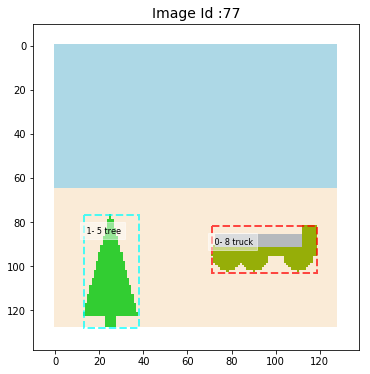

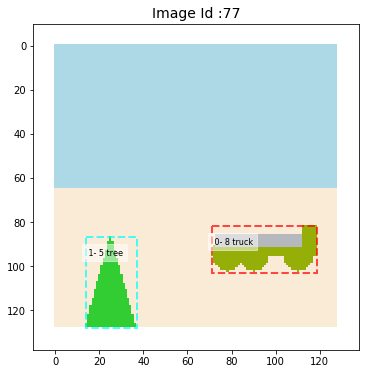

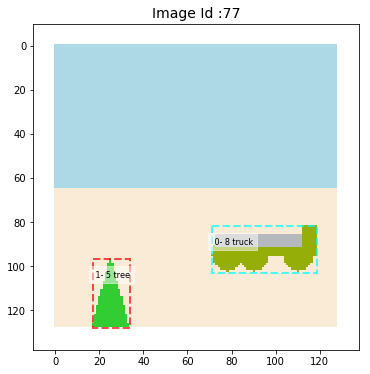

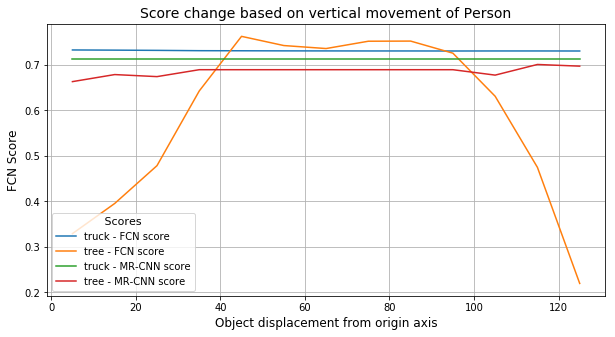

In [320]:
scores_tree  = {}
baseline_scores = {}
xy_movement = np.arange(5,130,10)
for cy in xy_movement:    
    tree      = ('tree'    , (50.0, 205.0, 50.0)  , (cx , cy, 12, 28))
    dataset_test.image_info[image_id]['shapes'][-1] = tree
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     print('-'*100)
#     print(' CY: ', cy)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_pr_fcn_scores(r[0], class_names)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in scores_tree:
            scores_tree[cls_name] = []
            baseline_scores[cls_name] = []
        scores_tree[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(scores_tree)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, scores_tree, baseline_scores, class_names, title = 'Score change based on vertical movement of Person')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('building', (7.0, 9.0, 197.0), (25, 5, 24, 20))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 4]
 Class Names :  ['truck', 'building']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('building', (7.0, 9.0, 197.0), (25, 15, 24, 20))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 4]
 Class Names :  ['truck', 'building']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('building', (7.0, 9.0, 197.0), (25, 25, 24, 20))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 4]
 Class Names :  ['truck', 'building']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('building', (7.0, 9.0, 197.0), (25, 35, 24, 20))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   

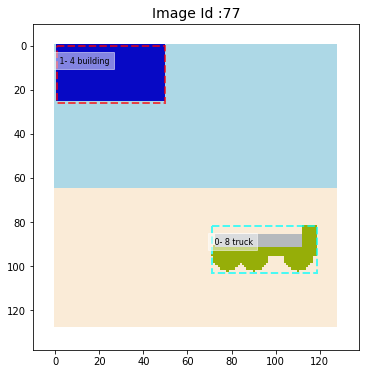

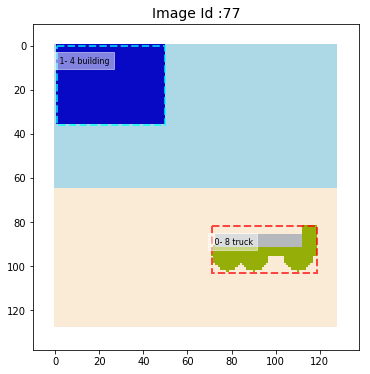

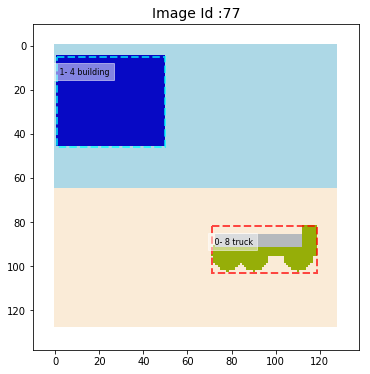

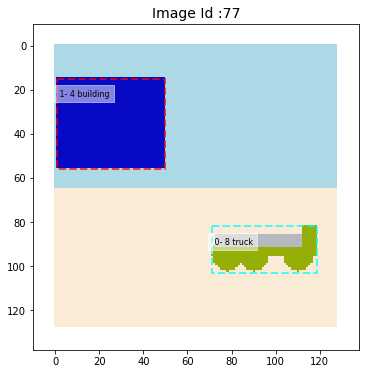

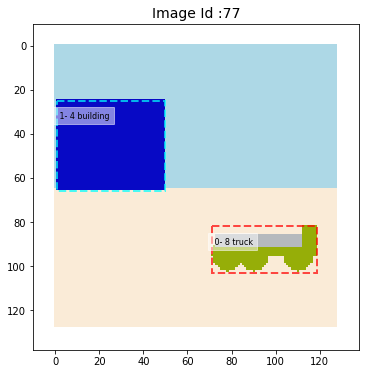

...

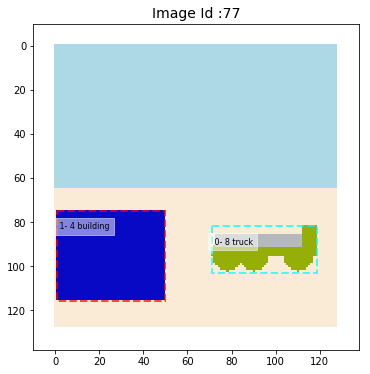

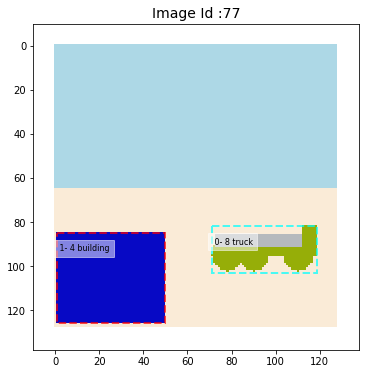

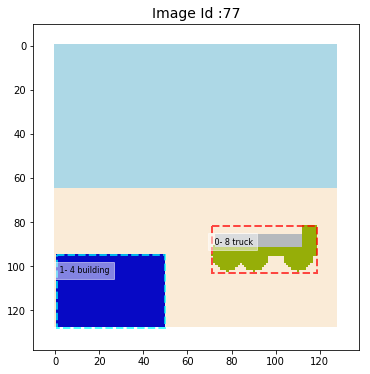

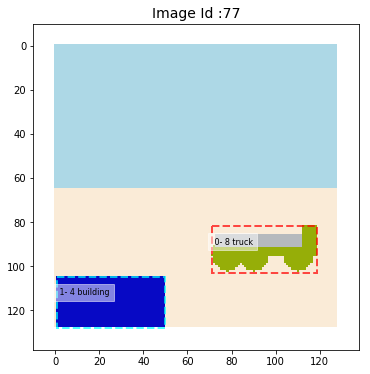

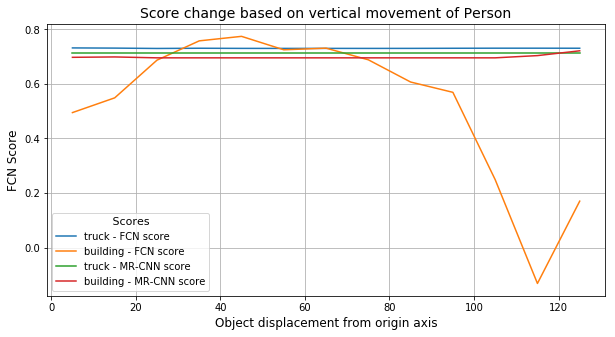

In [323]:
scores_building  = {}
baseline_scores = {}
xy_movement = np.arange(5,130,10)
for cy in xy_movement:    
    building  = ('building', (7.0, 9.0, 197.0)    , (cx , cy, 24, 20))
    dataset_test.image_info[image_id]['shapes'][-1] = building
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     print('-'*100)
#     print(' CY: ', cy)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_pr_fcn_scores(r[0], class_names)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in scores_building:
            scores_building[cls_name] = []
            baseline_scores[cls_name] = []
        scores_building[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(scores_building)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, scores_building, baseline_scores, class_names, title = 'Score change based on vertical movement of Person')

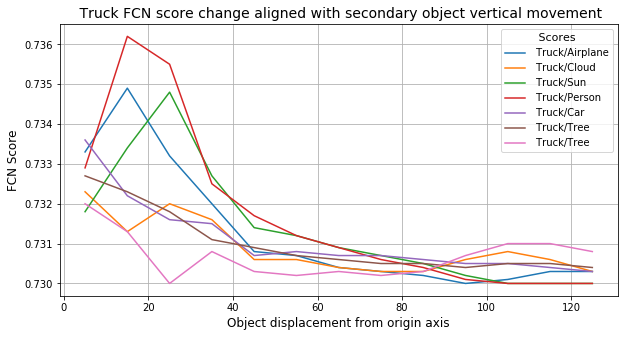

In [324]:
plt.figure(figsize=(10,5))
ax = plt.gca()
title = ' Truck FCN score change based on secondary object vertical movement'
ax.plot(xy_movement, scores_airplane['truck'], label= ' Truck/Airplane')
ax.plot(xy_movement, scores_cloud['truck'], label= ' Truck/Cloud')
ax.plot(xy_movement, scores_sun['truck'], label= ' Truck/Sun')
ax.plot(xy_movement, scores_person['truck'], label= ' Truck/Person')
ax.plot(xy_movement, scores_car['truck'], label= ' Truck/Car')
ax.plot(xy_movement, scores_tree['truck'], label= ' Truck/Tree')
ax.plot(xy_movement, scores_building['truck'], label= ' Truck/Tree')
ax.set_title(title, fontsize=14)
ax.set_xlabel('Object displacement from origin axis', fontsize= 12)
ax.set_ylabel('FCN Score', fontsize= 12)
ax.tick_params(axis='both', labelsize = 10)
#     ax.set_xlim([min_x,1.05])
#     ax.set_ylim([all_scores.min()-0.05, all_scores.max()+0.05])
leg = plt.legend(loc='upper right',frameon=True, fontsize = 10, markerscale = 6)
leg.set_title(' Scores ',prop={'size':11})
plt.grid(True)
#     for xval in np.linspac

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('building', (7.0, 9.0, 197.0), (25, 125, 24, 20))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 4]
 Class Names :  ['truck', 'building']


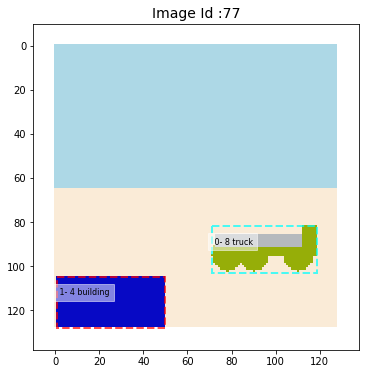

In [325]:
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

###  Truck - Horizontally moving objects (airplane,...)

77
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         8          7]
 Class Names :  ['truck', 'airplane']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              

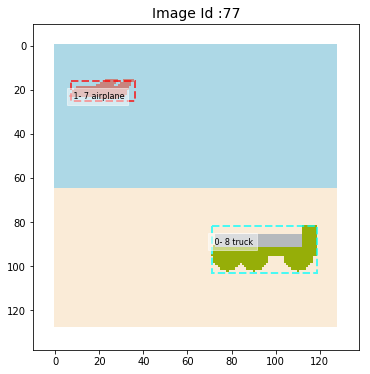

In [332]:
print(image_id)
truck = ('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11))
airplane = ('airplane', (200.0, 132.0, 126.0), (25, 23, 18, 7))

dataset_test.image_info[image_id]['shapes'] = []
dataset_test.image_info[image_id]['shapes'].append(truck)
dataset_test.image_info[image_id]['shapes'].append(airplane)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  

# vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
vis2.display_pr_fcn_scores(r[0], class_names)

 CX:  5
----------------------------------------------------------------------------------------------------
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (5, 30, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 7]
 Class Names :  ['truck', 'airplane']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   

 CX:  55
----------------------------------------------------------------------------------------------------
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (55, 30, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 7]
 Class Names :  ['truck', 'airplane']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask 

 CX:  105
----------------------------------------------------------------------------------------------------
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (105, 30, 18, 7))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 7]
 Class Names :  ['truck', 'airplane']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mas

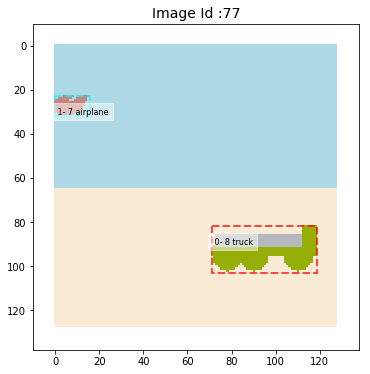

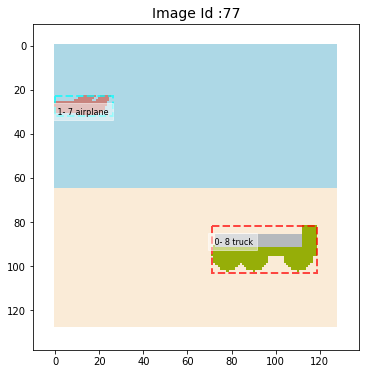

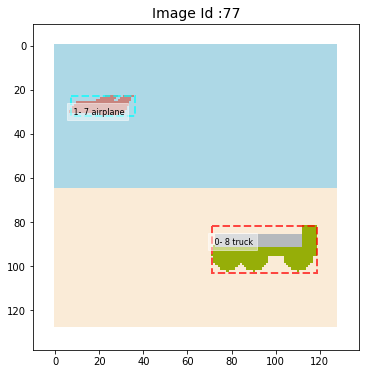

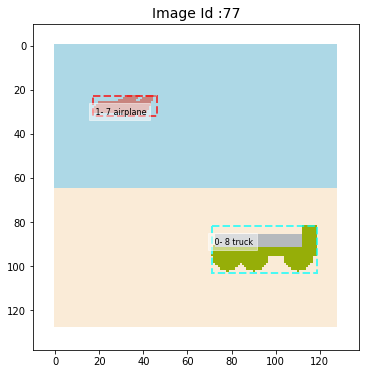

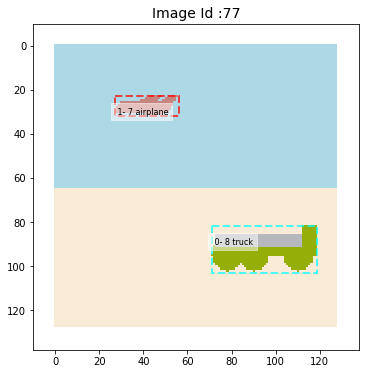

...

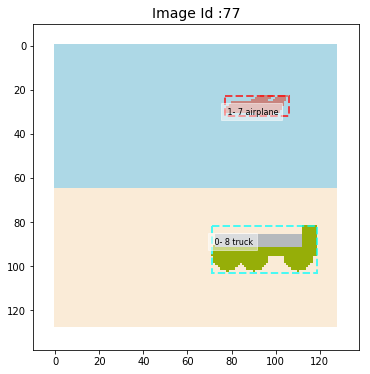

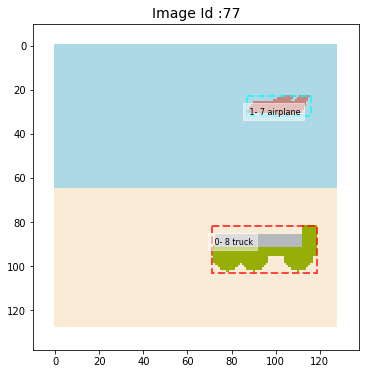

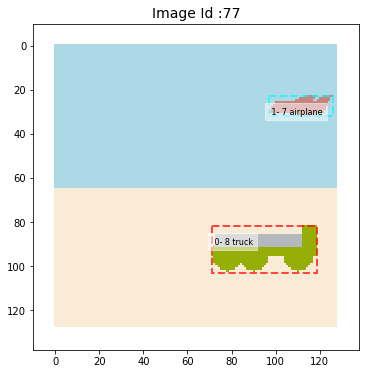

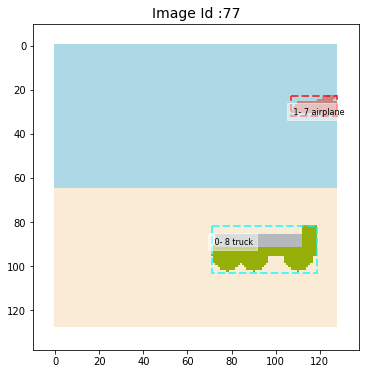

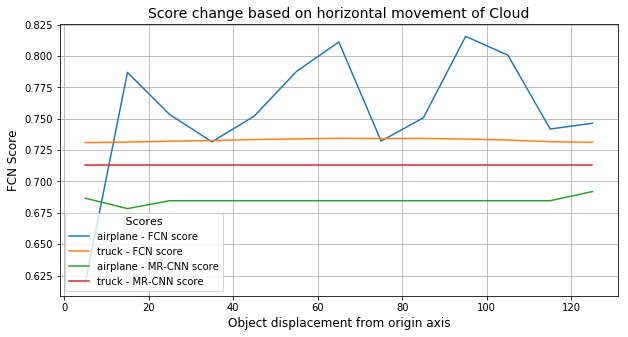

In [327]:
only = None
cy = 30
hscores_airplane = {} # np.empty((2,0))
baseline_scores = {}
# print(scores.shape)
xy_movement = np.arange(5,130,10)
for cx in xy_movement:    
    moving_object = ('airplane', (200.0, 132.0, 126.0), (cx, cy, 18, 7))
    dataset_test.image_info[image_id]['shapes'][-1] = moving_object
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
    
#     print('-'*100)
#     print(' CX: ', cx)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
    vis2.display_pr_fcn_scores(r[0], class_names)
    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in hscores_airplane:
            hscores_airplane[cls_name] = []
            baseline_scores[cls_name] = []
        hscores_airplane[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(hscores_airplane)
# print(baseline_scores)
plot_fcn_score_curves(xy_movement, hscores_airplane, baseline_scores, class_names, title = 'Score change based on horizontal movement of Airplane')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('cloud', (192.0, 192.0, 192.0), (5, 30, 34, 8))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 6]
 Class Names :  ['truck', 'cloud']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
---------------------------

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('cloud', (192.0, 192.0, 192.0), (55, 30, 34, 8))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 6]
 Class Names :  ['truck', 'cloud']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
--------------------------

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('cloud', (192.0, 192.0, 192.0), (105, 30, 34, 8))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 6]
 Class Names :  ['truck', 'cloud']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
-------------------------

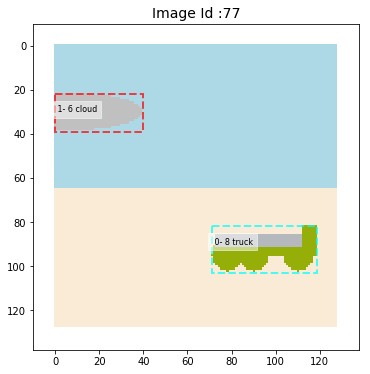

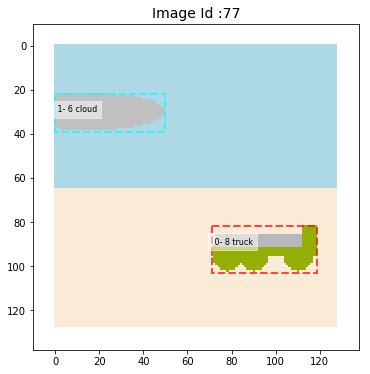

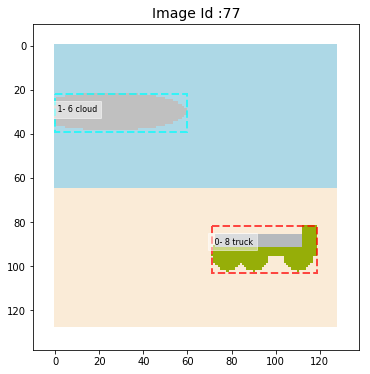

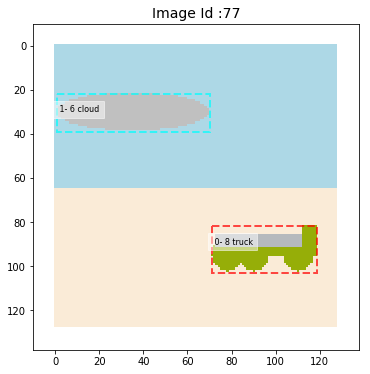

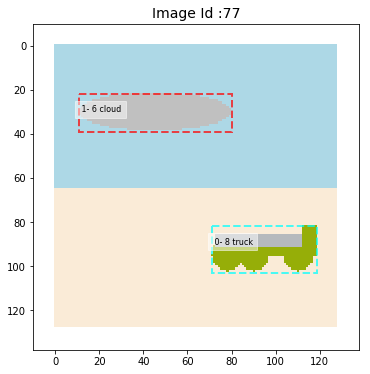

...

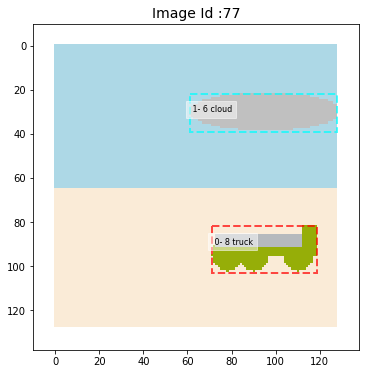

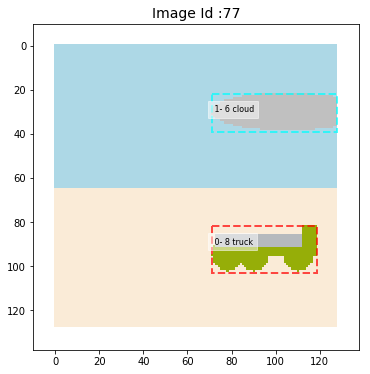

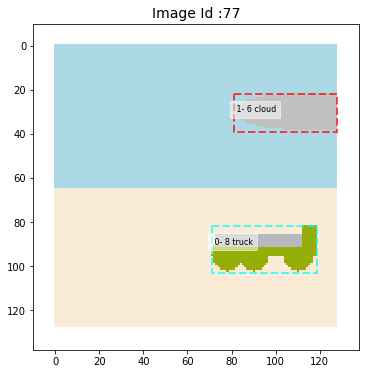

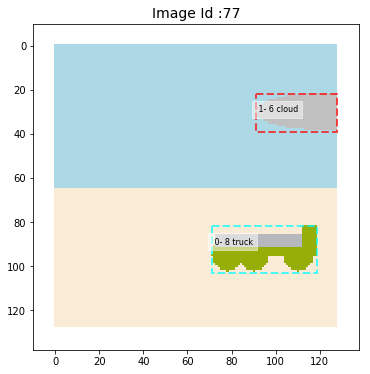

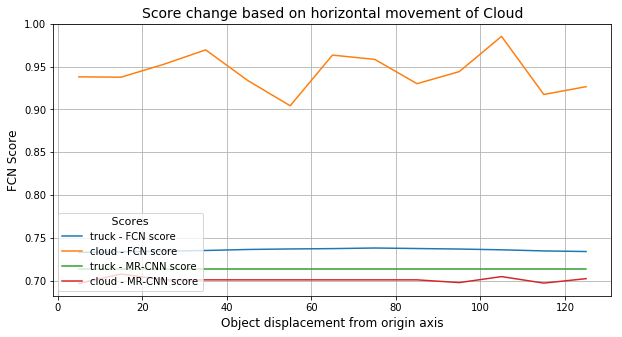

In [329]:
only = None
cy = 30
hscores_cloud = {} # np.empty((2,0))
baseline_scores = {}
# print(scores.shape)
xy_movement = np.arange(5,130,10)
for cx in xy_movement:    
    moving_object = ('cloud'   , (192.0, 192.0, 192.0), (cx , cy, 34,  8))
    dataset_test.image_info[image_id]['shapes'][-1] = moving_object
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
    
#     print('-'*100)
#     print(' CX: ', cx)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
    vis2.display_pr_fcn_scores(r[0], class_names)
    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in hscores_cloud:
            hscores_cloud[cls_name] = []
            baseline_scores[cls_name] = []
        hscores_cloud[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(hscores_cloud)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, hscores_cloud, baseline_scores, class_names, title = 'Score change based on horizontal movement of Cloud')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('sun', (255.0, 215.0, 0.0), (5, 30, 6, 6))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 3]
 Class Names :  ['truck', 'sun']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
----------------------------------

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('sun', (255.0, 215.0, 0.0), (55, 30, 6, 6))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 3]
 Class Names :  ['truck', 'sun']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
---------------------------------

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('sun', (255.0, 215.0, 0.0), (105, 30, 6, 6))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 3]
 Class Names :  ['truck', 'sun']
PR_SCORES from fcn/mrcnn_results:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                              |   |                |     MRCNN / FCN score 0    |         MRCNN / FCN score 1        |        MRCNN / FCN score 2         | 
          class               |TP/| mrcnn  normlzd |  gaussian   bbox   nrm.scr*|  ga.sum    mask     score   norm   |  ga.sum    mask     score   norm   | 
    seq  id name              | FP| score   score  |    sum      area   gau.sum |  in mask   sum              score  |  in mask   sum              score  |  Y1  X1  Y2  X2   AREA  
--------------------------------

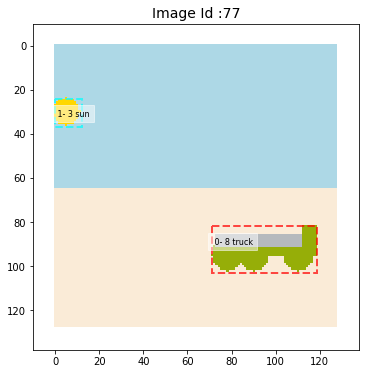

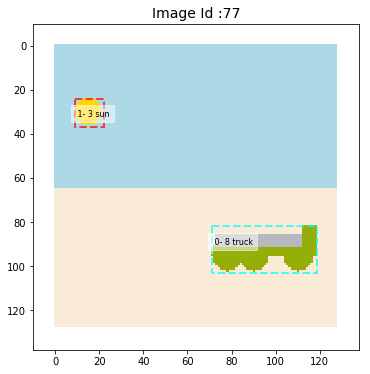

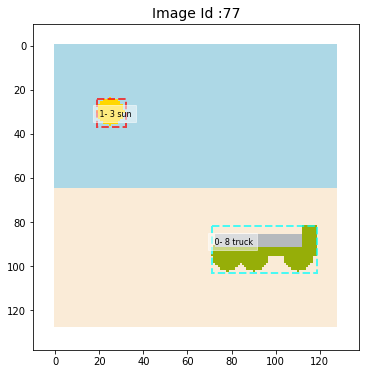

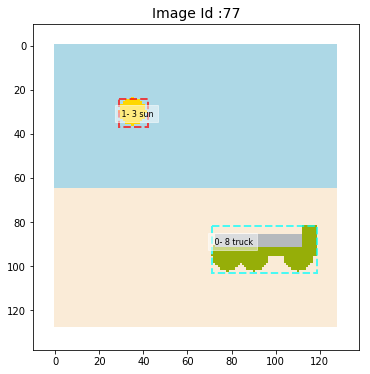

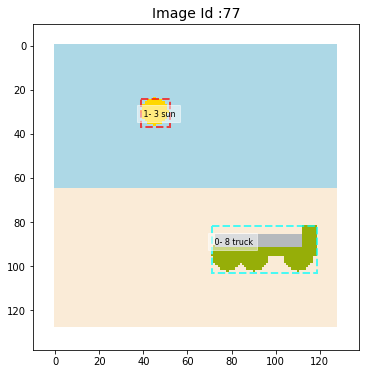

...

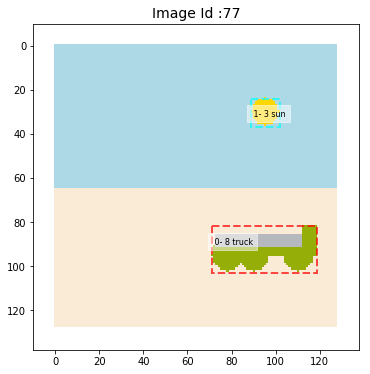

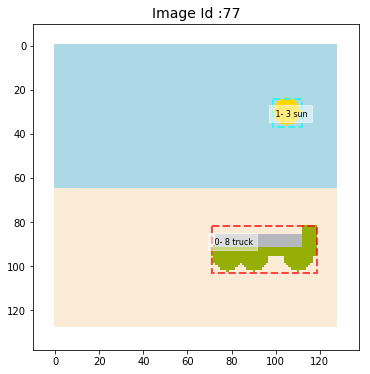

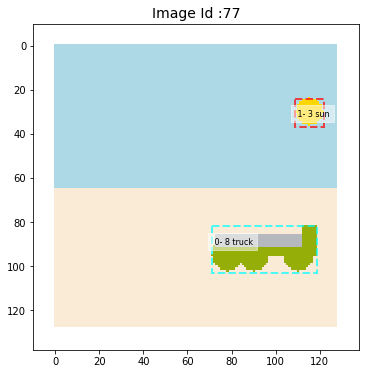

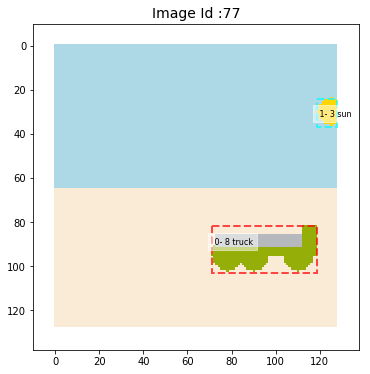

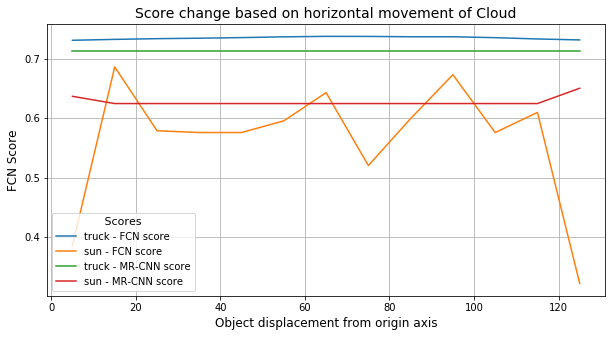

In [337]:
only = None
cy = 30
hscores_sun = {} # np.empty((2,0))
baseline_scores = {}
# print(scores.shape)
xy_movement = np.arange(5,130,10)
for cx in xy_movement:    
    sun       = ('sun'     , (255.0, 215.0, 0.0)  , (cx , cy,  6,  6))
    dataset_test.image_info[image_id]['shapes'][-1] = sun
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
    
#     print('-'*100)
#     print(' CX: ', cx)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)
    vis2.display_pr_fcn_scores(r[0], class_names)
    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in hscores_sun:
            hscores_sun[cls_name] = []
            baseline_scores[cls_name] = []
        hscores_sun[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(hscores_sun)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, hscores_sun, baseline_scores, class_names, title = 'Score change based on horizontal movement of Sun ')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('car', (150.0, 174.0, 8.0), (5, 30, 24, 12))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 2]
 Class Names :  ['truck', 'car']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('car', (150.0, 174.0, 8.0), (15, 30, 24, 12))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 2]
 Class Names :  ['truck', 'car']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('car', (150.0, 174.0, 8.0), (25, 30, 24, 12))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class ids   :  (2,)    [8 2]
 Class Names :  ['truck', 'car']
 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('car', (150.0, 174.0, 8.0), (35, 30, 24, 12))] Coco Id: 77
 Image meta  :  [ 77 128 128   3   0   0 128 128   1   1]
 Class i

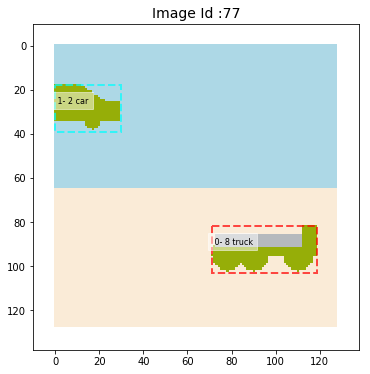

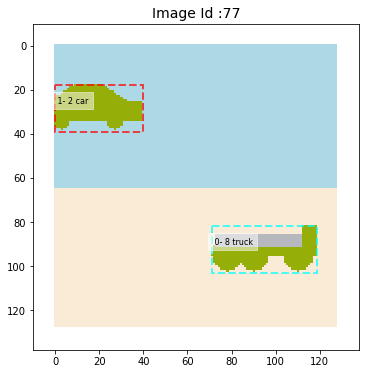

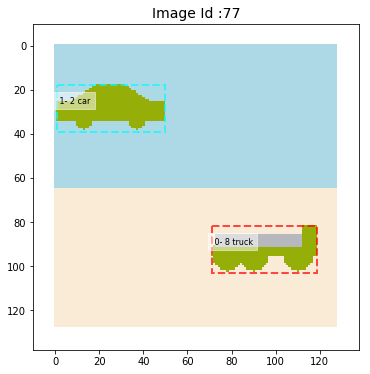

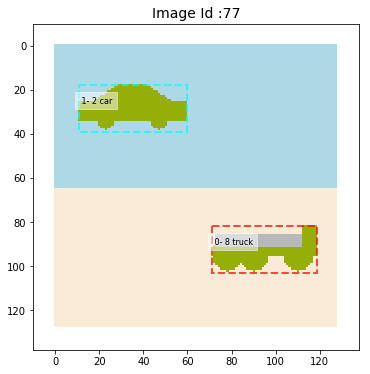

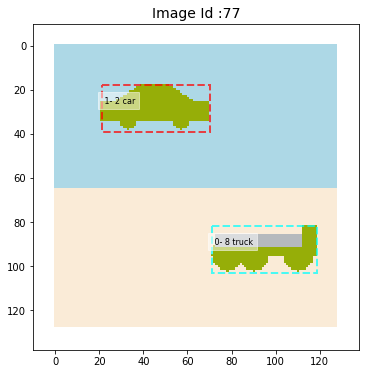

...

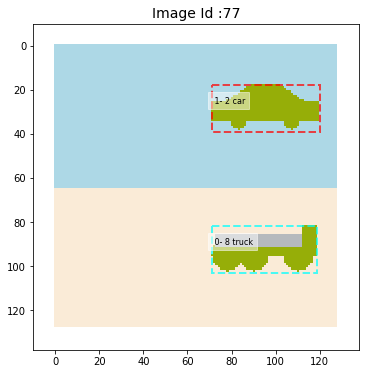

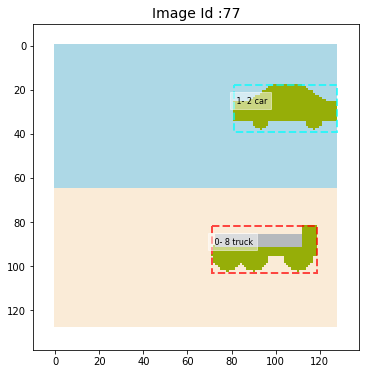

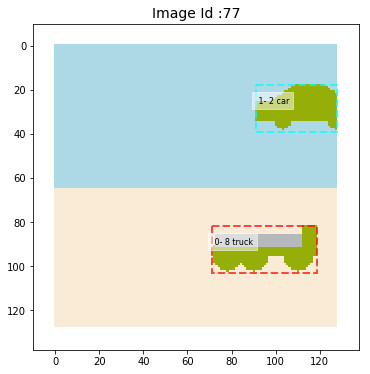

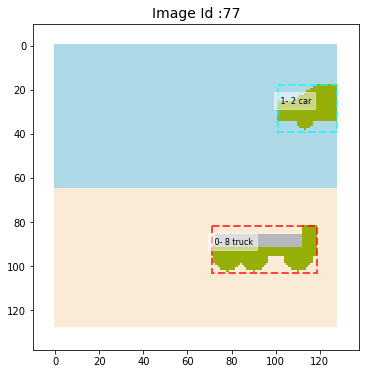

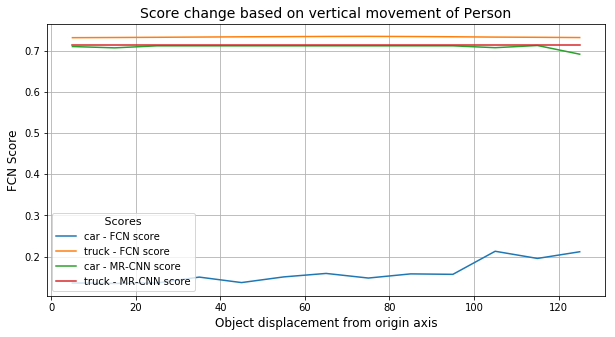

In [339]:
hscores_car  = {}
baseline_scores = {}
cy = 30
xy_movement = np.arange(5,130,10)
for cx in xy_movement:    
    car       = ('car'     , (150.0, 174.0, 8.0)  , (cx , cy, 24, 12))
    dataset_test.image_info[image_id]['shapes'][-1] = car
    r = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     print('-'*100)
#     print(' CY: ', cy)
#     print('-'*100)
    vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)    
#     vis2.display_fcn_hm(vis2.normalize_all(r[0]['fcn_hm'][1:]), class_names, columns =9, size = 8)
#     vis2.display_pr_fcn_scores(r[0], class_names)
#     vis2.display_fcn_scores_box_info(r[0]['fcn_scores'], r[0]['fcn_hm'], class_names,only = only)    
    for idx, (mrcnn_row, fcn_row) in enumerate(  zip(r[0]['pr_scores'],r[0]['fcn_scores'])): 
        cls = int(fcn_row[CLASS_COLUMN])
        cls_name = class_names[cls]
        if cls_name  not in hscores_car:
            hscores_car[cls_name] = []
            baseline_scores[cls_name] = []
        hscores_car[cls_name].append(round(fcn_row[SCORE_1_COLUMN],4))  
        baseline_scores[cls_name].append(round(mrcnn_row[SCORE_1_COLUMN],4))
print(hscores_car)
print(baseline_scores)
plot_fcn_score_curves(xy_movement, hscores_car, baseline_scores, class_names, title = 'Score change based on vertical movement of Person')

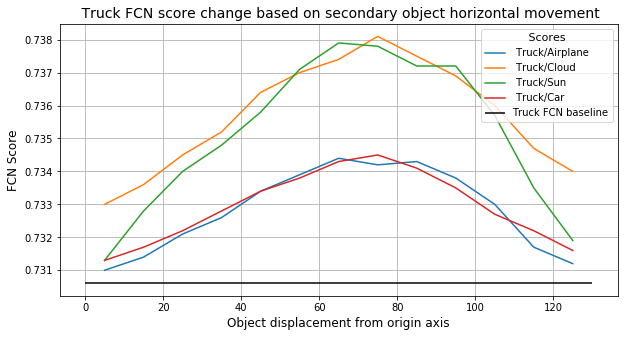

In [340]:
plt.figure(figsize=(10,5))
ax = plt.gca()
title = ' Truck FCN score change based on secondary object horizontal movement'
ax.plot(xy_movement, hscores_airplane['truck'], label= ' Truck/Airplane')
ax.plot(xy_movement, hscores_cloud['truck'], label= ' Truck/Cloud')
ax.hlines(0.7306,0,130, label='Truck FCN baseline')
ax.plot(xy_movement, hscores_sun['truck'], label= ' Truck/Sun')
# ax.plot(xy_movement, scores_person['truck'], label= ' Truck/Person')
ax.plot(xy_movement, hscores_car['truck'], label= ' Truck/Car')
# ax.plot(xy_movement, scores_tree['truck'], label= ' Truck/Tree')
# ax.plot(xy_movement, scores_building['truck'], label= ' Truck/Tree')
ax.set_title(title, fontsize=14)
ax.set_xlabel('Object location on horizontal axis', fontsize= 12)
ax.set_ylabel('FCN Score', fontsize= 12)
ax.tick_params(axis='both', labelsize = 10)
#     ax.set_xlim([min_x,1.05])
#     ax.set_ylim([all_scores.min()-0.05, all_scores.max()+0.05])
leg = plt.legend(loc='upper right',frameon=True, fontsize = 10, markerscale = 6)
leg.set_title(' Scores ',prop={'size':11})
plt.grid(True)
# plot_fcn_score_curves(x_dim, scores, baseline_scores, class_names, title = 'Score change based on horizontal movement of Cloud')

 Image_id    :  77  Reference:  [('truck', (150.0, 174.0, 8.0), (95, 93, 23, 11)), ('airplane', (200.0, 132.0, 126.0), (125, 30, 18, 7))] Coco Id: 77
 Image meta  :  [        77        128        128          3          0          0        128        128          1          1]
 Class ids   :  (2,)    [         8          7]
 Class Names :  ['truck', 'airplane']


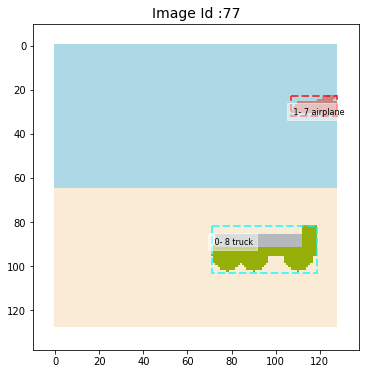

In [186]:
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

In [342]:
def plot_fcn_score_curves(x_y_dim, fcn_scores, mrcnn_scores, class_names, ax = None , min_x = 0.0, title = None):
    if ax is None:
        plt.figure(figsize=(10,5))
        ax = plt.gca()

    # scores is always passed ffom plot_mAP_by_scores, so it's nver None
    # so we loop on scores instead of sorted(class_data)
    # for idx, score_key in enumerate(sorted(class_data)):
    for idx, cls  in enumerate(fcn_scores):
        ax.plot(x_y_dim, fcn_scores[cls], label= cls + ' - FCN score')
        # if  scores is not None and score_key not in  scores:
            # continue        
#         print('score_key is: {:20s} iou: {:6.3f}  avg_prec: {:10.4f}'.format(score_key,  iou_key, class_data[score_key][iou_key]['avg_prec']))
#         score_keys.append(score_key)
#         avg_precs[score_key] = class_data[score_key][iou_key]['avg_prec']
#         precisions = class_data[score_key][iou_key]['precisions']
#         recalls    = class_data[score_key][iou_key]['recalls']
#         label      = '{:15s}'.format(score_key)
        
#         score_idx  = scores.index(score_key)
#         print('idx: ', idx, ' Score_key: ' , score_key, 'Score Index: ' , score_idx, 'color:', SCORE_COLORS[score_key])
    
    for idx, cls  in enumerate(mrcnn_scores):
        ax.plot(x_y_dim, mrcnn_scores[cls], label= cls + ' - MR-CNN score')
        
    print(' y limit:', plt.ylim(), ' xlimit : ', plt.xlim())

    ax.set_title(title, fontsize=14)
    ax.set_xlabel('Object displacement from origin axis', fontsize= 12)
    ax.set_ylabel('FCN Score', fontsize= 12)
    ax.tick_params(axis='both', labelsize = 10)
#     ax.set_xlim([min_x,1.05])
#     ax.set_ylim([all_scores.min()-0.05, all_scores.max()+0.05])
    leg = plt.legend(loc='lower left',frameon=True, fontsize = 10, markerscale = 6)
    leg.set_title(' Scores ',prop={'size':11})
    plt.grid(True)
#     for xval in np.linspace(0.0, 1.0, 11):
#         plt.vlines(xval, 0.0, 1.1, color='gray', alpha=0.3, linestyles='dashed', linewidth=1)

def plot_fcn_score_curves_1(x_y_dim, cls_scores, cls_name, ax = None , min_x = 0.0, title = None):

    ax.set_title(title, fontsize=14)
    ax.set_xlabel('Object displacement from origin axis', fontsize= 12)
    ax.set_ylabel('FCN Score', fontsize= 12)
    ax.tick_params(axis='both', labelsize = 10)
#     ax.set_xlim([min_x,1.05])
#     ax.set_ylim([all_scores.min()-0.05, all_scores.max()+0.05])
    leg = plt.legend(loc='lower left',frameon=True, fontsize = 10, markerscale = 6)
    leg.set_title(' Scores ',prop={'size':11})
    plt.grid(True)
#     for xval in np.linspace(0.0, 1.0, 11):
#         plt.vlines(xval, 0.0, 1.1, color='gray', alpha=0.3, linestyles='dashed', linewidth=1)

#### Manipulate image 18

In [28]:
image_id = 18
save_shapes = copy.copy(dataset_test.image_info[image_id]['shapes'])
pp.pprint(save_shapes)

[('sun', (255.0, 215.0, 0.0), (67, 9, 4, 4)), ('truck', (87.0, 142.0, 92.0), (86, 117, 40, 13))]


[]
[('sun', (0.0, 0.0, 0.0), (7, 9, 4, 4))]
 Image_id    :  18  Reference:  [('sun', (0.0, 0.0, 0.0), (7, 9, 4, 4))] Coco Id: 18
 Image meta  :  [ 18 128 128   3   0   0 128 128   1   1]
 Class ids   :  (1,)    [3]
 Class Names :  ['sun']


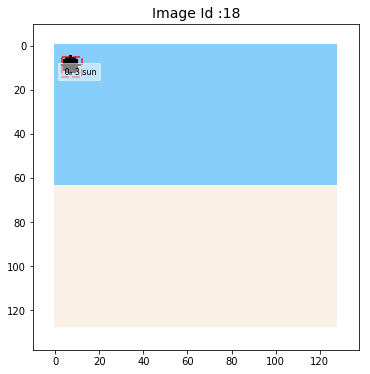

In [31]:
# pp.pprint(save_shapes)
# dataset_test.image_info[image_id]['shapes'] = save_shapes
pp.pprint(dataset_test.image_info[image_id]['shapes'])


# del dataset_test.image_info[image_id]['shapes'][0:2]
# new_obj  = ('car', black, (64,64, 15, 7))
# person = ('person', (139.0, 69.0, 19.0), (17, 92, 2, 10))
## person = ('person', (240.0, 230.0, 140.0), (40, 92, 2, 10))

new_obj = ('sun', (0.0, 0.0, 0.0), (7, 9, 4, 4))
dataset_test.image_info[image_id]['shapes'].append(new_obj)

pp.pprint(dataset_test.image_info[image_id]['shapes'])

vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

In [30]:
del dataset_test.image_info[image_id]['shapes'][0]

vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

IndexError: index -1 is out of bounds for axis 2 with size 0

 Image_id    :  18  Reference:  [('sun', (0.0, 0.0, 0.0), (67, 9, 4, 4))] Coco Id: 18
 Image meta  :  [ 18 128 128   3   0   0 128 128   1   1]
 Class ids   :  (1,)    [3]
 Class Names :  ['sun']


IndexError: index -1 is out of bounds for axis 2 with size 0

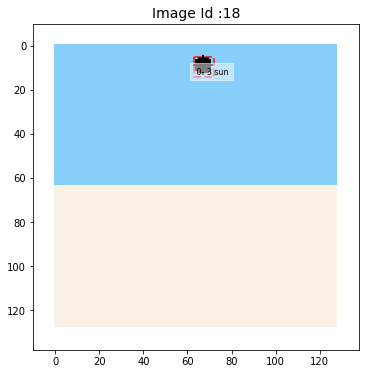

In [13]:
# new_obj  = ('car', black, (cx, cy, 15, 7))
new_obj = ('sun', (0.0, 0.0, 0.0), (67, 9, 4, 4))
dataset_test.image_info[image_id]['shapes'].append(new_obj)

vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

del dataset_test.image_info[image_id]['shapes'][-1]
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

 Image_id    :  79  Reference:  [('airplane', (215.0, 217.0, 161.0), (31, 23, 16, 6)), ('person', (240.0, 230.0, 140.0), (50, 86, 1, 9))] Coco Id: 79
 Image meta  :  [    79    128    128      3      0      0    128    128      1      1]
 Class ids   :  (2,)    [     7      1]
 Class Names :  ['airplane', 'person']


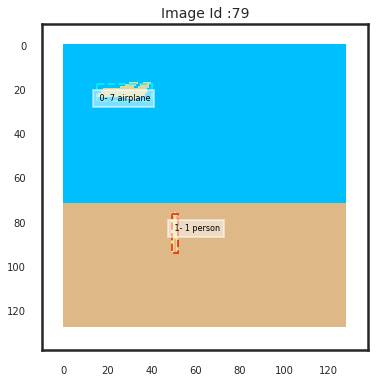

In [410]:
dataset_test.image_info[image_id]['shapes'] = save_shapes
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

#### Manipulate image 67

In [83]:
image_id = 67
# save_shapes = copy.copy(dataset_test.image_info[image_id]['shapes'])
pp.pprint(save_shapes)

[ ('cloud', (245.0, 245.0, 245.0), (57, 9, 21, 4)),
  ('building', (185.0, 89.0, 119.0), (32, 38, 28, 21)),
  ('building', (9.0, 154.0, 59.0), (66, 46, 16, 16)),
  ('car', (34.0, 247.0, 100.0), (87, 96, 21, 10))]


[('airplane', (215.0, 217.0, 161.0), (31, 23, 16, 6))]
 Image_id    :  67  Reference:  [('airplane', (215.0, 217.0, 161.0), (31, 23, 16, 6))] Coco Id: 67
 Image meta  :  [    67    128    128      3      0      0    128    128      1      1]
 Class ids   :  (1,)    [     7]
 Class Names :  ['airplane']


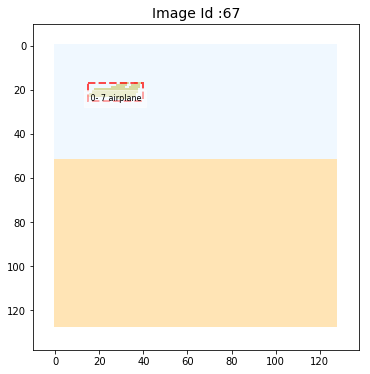

In [84]:
# pp.pprint(save_shapes)
# dataset_test.image_info[image_id]['shapes'] = save_shapes
# del dataset_test.image_info[image_id]['shapes'][0:2]
# new_obj  = ('car', black, (64,64, 15, 7))
# person = ('person', (139.0, 69.0, 19.0), (17, 92, 2, 10))
## person = ('person', (240.0, 230.0, 140.0), (40, 92, 2, 10))
dataset_test.image_info[image_id]['shapes'].append(('airplane', (215.0, 217.0, 161.0), (31, 23, 16, 6)))


pp.pprint(dataset_test.image_info[image_id]['shapes'])

vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

 Image_id    :  67  Reference:  [('building', (0.0, 0.0, 0.0), (4, 4, 16, 16))] Coco Id: 67
 Image meta  :  [    67    128    128      3      0      0    128    128      1      1]
 Class ids   :  (1,)    [     4]
 Class Names :  ['building']


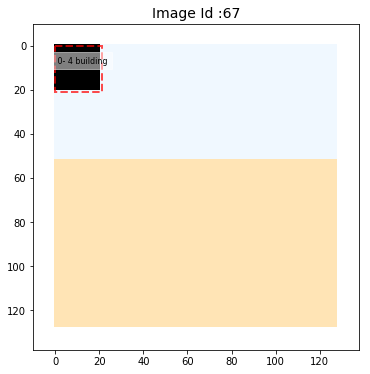

In [76]:
del dataset_test.image_info[image_id]['shapes'][:4]
# new_obj = ('sun', (0.0, 0.0, 0.0), (7, 9, 4, 4))
new_obj = ('building', (0.0, 0.0, 0.0), (4, 4, 16, 16))
dataset_test.image_info[image_id]['shapes'].append(new_obj)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

 Image_id    :  18  Reference:  [('sun', (0.0, 0.0, 0.0), (67, 9, 4, 4))] Coco Id: 18
 Image meta  :  [ 18 128 128   3   0   0 128 128   1   1]
 Class ids   :  (1,)    [3]
 Class Names :  ['sun']


IndexError: index -1 is out of bounds for axis 2 with size 0

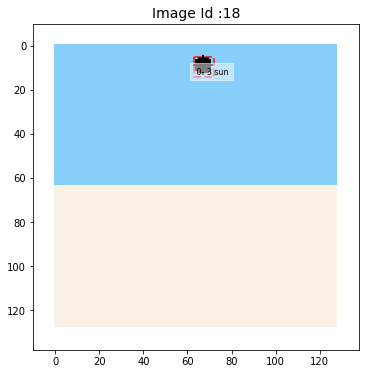

In [13]:
# new_obj  = ('car', black, (cx, cy, 15, 7))
new_obj = ('sun', (0.0, 0.0, 0.0), (67, 9, 4, 4))
dataset_test.image_info[image_id]['shapes'].append(new_obj)

vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

del dataset_test.image_info[image_id]['shapes'][-1]
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

 Image_id    :  79  Reference:  [('airplane', (215.0, 217.0, 161.0), (31, 23, 16, 6)), ('person', (240.0, 230.0, 140.0), (50, 86, 1, 9))] Coco Id: 79
 Image meta  :  [    79    128    128      3      0      0    128    128      1      1]
 Class ids   :  (2,)    [     7      1]
 Class Names :  ['airplane', 'person']


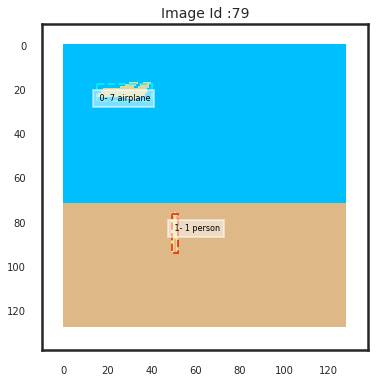

In [410]:
dataset_test.image_info[image_id]['shapes'] = save_shapes
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

#### Manipulate image 79

In [196]:
image_id = 79
save_shapes = copy.copy(dataset_test.image_info[image_id]['shapes'])
pp.pprint(save_shapes)

[ ('airplane', (215.0, 217.0, 161.0), (31, 23, 16, 6)),
  ('person', (240.0, 230.0, 140.0), (50, 86, 1, 9))]


 Image_id    :  79  Reference:  [('airplane', (215.0, 217.0, 161.0), (31, 23, 16, 6)), ('person', (240.0, 230.0, 140.0), (50, 86, 1, 9))] Coco Id: 79
 Image meta  :  [    79    128    128      3      0      0    128    128      1      1]
 Class ids   :  (2,)    [     7      1]
 Class Names :  ['airplane', 'person']


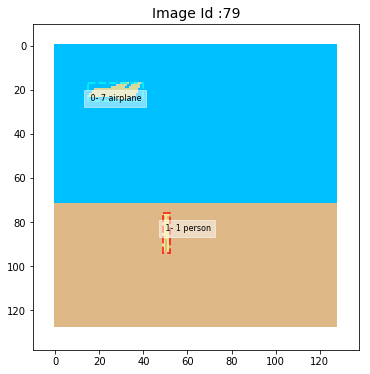

In [197]:
# new_obj  = ('car', black, (64,64, 15, 7))
# person = ('person', (139.0, 69.0, 19.0), (17, 92, 2, 10))
## person = ('person', (240.0, 230.0, 140.0), (40, 92, 2, 10))

vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

 Image_id    :  79  Reference:  [('person', (240.0, 230.0, 140.0), (50, 86, 1, 9))] Coco Id: 79
 Image meta  :  [    79    128    128      3      0      0    128    128      1      1]
 Class ids   :  (1,)    [     1]
 Class Names :  ['person']


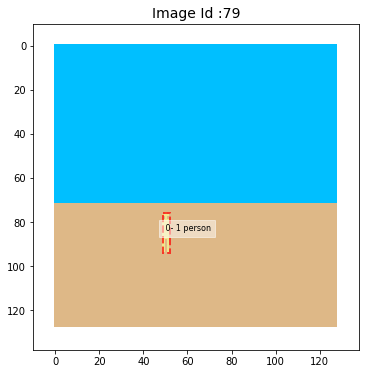

In [198]:
del dataset_test.image_info[image_id]['shapes'][0]
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

 Image_id    :  79  Reference:  [('person', (240.0, 230.0, 140.0), (50, 86, 1, 9)), ('car', (0.0, 0.0, 0.0), (122, 122, 15, 7))] Coco Id: 79
 Image meta  :  [    79    128    128      3      0      0    128    128      1      1]
 Class ids   :  (2,)    [     1      2]
 Class Names :  ['person', 'car']
 Image_id    :  79  Reference:  [('person', (240.0, 230.0, 140.0), (50, 86, 1, 9))] Coco Id: 79
 Image meta  :  [    79    128    128      3      0      0    128    128      1      1]
 Class ids   :  (1,)    [     1]
 Class Names :  ['person']


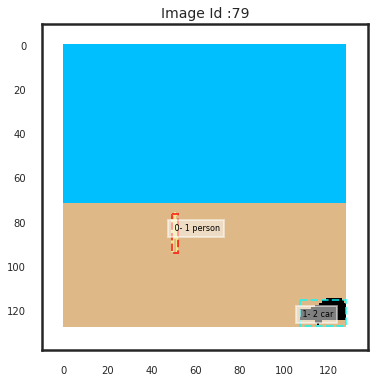

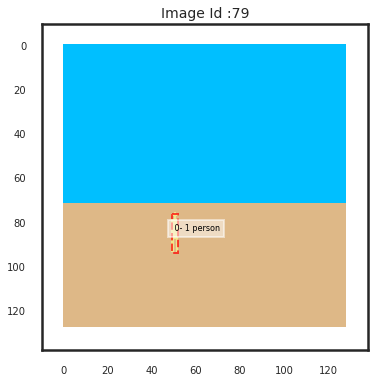

In [409]:
new_obj  = ('car', black, (cx, cy, 15, 7))
dataset_test.image_info[image_id]['shapes'].append(new_obj)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

del dataset_test.image_info[image_id]['shapes'][-1]
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

 Image_id    :  79  Reference:  [('airplane', (215.0, 217.0, 161.0), (31, 23, 16, 6)), ('person', (240.0, 230.0, 140.0), (50, 86, 1, 9))] Coco Id: 79
 Image meta  :  [    79    128    128      3      0      0    128    128      1      1]
 Class ids   :  (2,)    [     7      1]
 Class Names :  ['airplane', 'person']


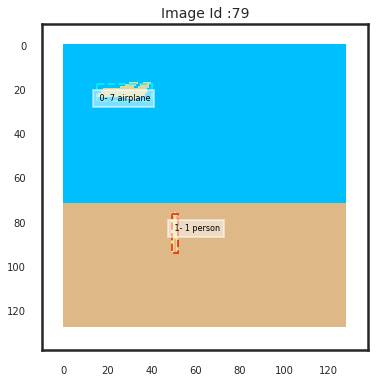

In [410]:
dataset_test.image_info[image_id]['shapes'] = save_shapes
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6)

#### Manipulate image 176

[ ('tree', (85.0, 107.0, 47.0), (80, 60, 4, 12)),
  ('person', (210.0, 180.0, 140.0), (5, 68, 1, 7)),
  ('car', (11.0, 242.0, 235.0), (69, 92, 19, 9)),
  ('person', (240.0, 230.0, 140.0), (40, 92, 2, 10))]
 Image_id    :  176  Reference:  [('tree', (85.0, 107.0, 47.0), (80, 60, 4, 12)), ('person', (210.0, 180.0, 140.0), (5, 68, 1, 7)), ('car', (11.0, 242.0, 235.0), (69, 92, 19, 9)), ('person', (240.0, 230.0, 140.0), (40, 92, 2, 10))] Coco Id: 176
 Image meta  :  [   176    128    128      3      0      0    128    128      1      1]
 Class ids   :  (4,)    [     5      1      2      1]
 Class Names :  ['tree', 'person', 'car', 'person']


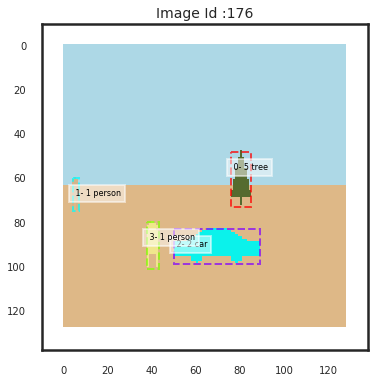

In [429]:
# new_obj  = ('car', black, (64,64, 15, 7))
# person = ('person', (139.0, 69.0, 19.0), (17, 92, 2, 10))
image_id = 176
save_shapes = copy.copy(dataset_test.image_info[image_id]['shapes'])
pp.pprint(save_shapes)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

 Image_id    :  176  Reference:  [('car', (11.0, 242.0, 235.0), (69, 92, 19, 9))] Coco Id: 176
 Image meta  :  [   176    128    128      3      0      0    128    128      1      1]
 Class ids   :  (1,)    [     2]
 Class Names :  ['car']


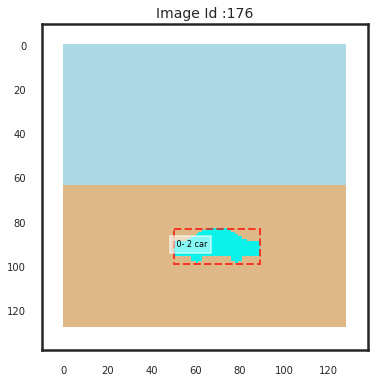

In [430]:
del dataset_test.image_info[image_id]['shapes'][0:2]
del dataset_test.image_info[image_id]['shapes'][-1]
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

 Image_id    :  176  Reference:  [('car', (11.0, 242.0, 235.0), (69, 92, 19, 9)), ('person', (0.0, 0.0, 0.0), (64, 64, 2, 10))] Coco Id: 176
 Image meta  :  [   176    128    128      3      0      0    128    128      1      1]
 Class ids   :  (2,)    [     2      1]
 Class Names :  ['car', 'person']


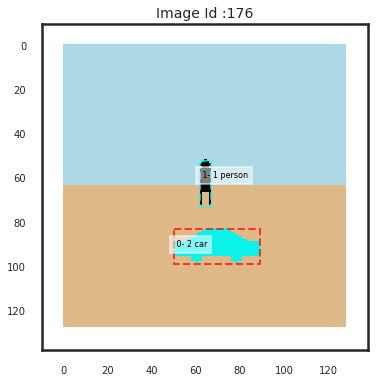

In [426]:
person = ('person', (0.0, 0.0, 0.0), (64, 64, 2, 10))
dataset_test.image_info[image_id]['shapes'].append(person)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

 Image_id    :  176  Reference:  [('car', (11.0, 242.0, 235.0), (69, 92, 19, 9))] Coco Id: 176
 Image meta  :  [   176    128    128      3      0      0    128    128      1      1]
 Class ids   :  (1,)    [     2]
 Class Names :  ['car']


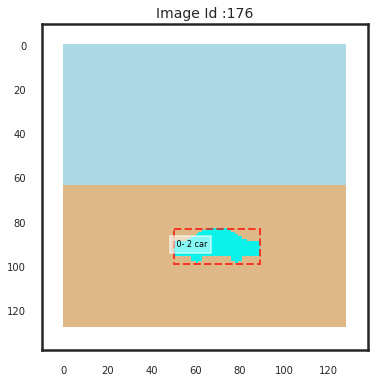

In [427]:
dataset_test.image_info[image_id]['shapes'].pop(-1)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)


 Image_id    :  176  Reference:  [('tree', (85.0, 107.0, 47.0), (80, 60, 4, 12)), ('person', (210.0, 180.0, 140.0), (5, 68, 1, 7)), ('car', (11.0, 242.0, 235.0), (69, 92, 19, 9)), ('person', (240.0, 230.0, 140.0), (40, 92, 2, 10))] Coco Id: 176
 Image meta  :  [   176    128    128      3      0      0    128    128      1      1]
 Class ids   :  (4,)    [     5      1      2      1]
 Class Names :  ['tree', 'person', 'car', 'person']


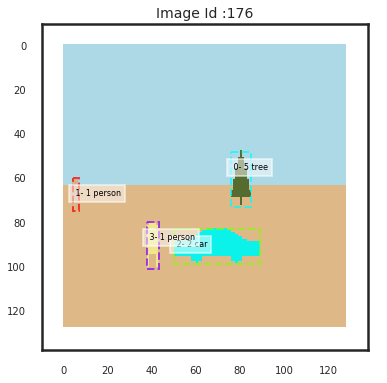

In [428]:
dataset_test.image_info[image_id]['shapes'] = save_shapes
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)


In [179]:
import copy 
save_shapes = copy.copy(dataset_test.image_info[29]['shapes'])
pp.pprint(save_shapes)

[ ('building', (48.0, 111.0, 114.0), (87, 50, 19, 15)),
  ('tree', (0.0, 128.0, 0.0), (17, 53, 6, 16)),
  ('car', (104.0, 52.0, 242.0), (68, 76, 17, 8)),
  ('car', (227.0, 95.0, 90.0), (80, 92, 20, 10))]


####  Modify image 29 -- 
     Remove building and tree and move cars above each other 

[ ('building', (48.0, 111.0, 114.0), (87, 50, 19, 15)),
  ('tree', (0.0, 128.0, 0.0), (17, 53, 6, 16)),
  ('car', (104.0, 52.0, 242.0), (68, 76, 17, 8)),
  ('car', (227.0, 95.0, 90.0), (80, 92, 20, 10))]
 Image_id    :  29  Reference:  [('building', (48.0, 111.0, 114.0), (87, 50, 19, 15)), ('tree', (0.0, 128.0, 0.0), (17, 53, 6, 16)), ('car', (104.0, 52.0, 242.0), (68, 76, 17, 8)), ('car', (227.0, 95.0, 90.0), (80, 92, 20, 10))] Coco Id: 29
 Image meta  :  [    29    128    128      3      0      0    128    128      1      1]
 Class ids   :  (4,)    [     4      5      2      2]
 Class Names :  ['building', 'tree', 'car', 'car']


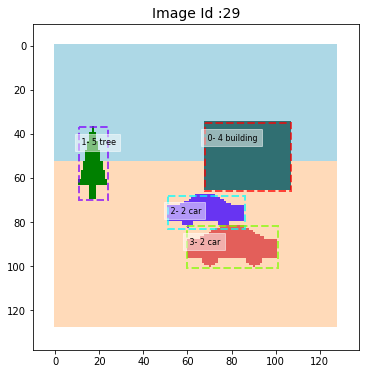

In [238]:
image_id = 29
save_shapes = copy.copy(dataset_test.image_info[image_id]['shapes'])
pp.pprint(save_shapes)
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

[('car', (104.0, 52.0, 242.0), (68, 76, 17, 8)), ('car', (227.0, 95.0, 90.0), (80, 92, 20, 10))]
 Image_id    :  29  Reference:  [('car', (104.0, 52.0, 242.0), (68, 76, 17, 8)), ('car', (227.0, 95.0, 90.0), (80, 92, 20, 10))] Coco Id: 29
 Image meta  :  [    29    128    128      3      0      0    128    128      1      1]
 Class ids   :  (2,)    [     2      2]
 Class Names :  ['car', 'car']


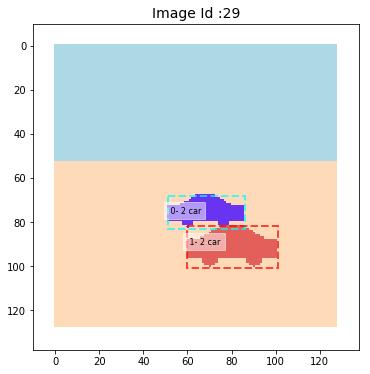

In [239]:
del dataset_test.image_info[29]['shapes'][0:2]
pp.pprint(dataset_test.image_info[29]['shapes'])
vis.display_image_gt(dataset_test, dataset_test.config, 29, size=6, verbose = True)

 Image_id    :  29  Reference:  [('car', (104.0, 52.0, 242.0), (80, 60, 15, 7)), ('car', (227.0, 95.0, 90.0), (80, 92, 20, 10))] Coco Id: 29
 Image meta  :  [    29    128    128      3      0      0    128    128      1      1]
 Class ids   :  (2,)    [     2      2]
 Class Names :  ['car', 'car']


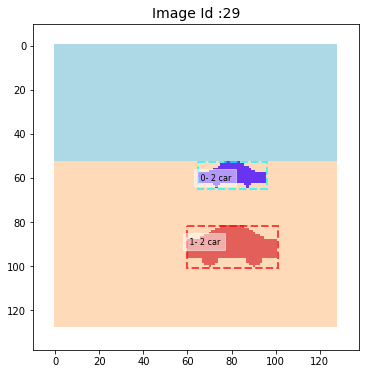

In [240]:
dataset_test.image_info[29]['shapes'][0] =  ('car', (104.0, 52.0, 242.0),(80, 60,15,7))
vis.display_image_gt(dataset_test, dataset_test.config, 29, size=6, verbose = True)

In [255]:
person = ('person', (240.0, 230.0, 140.0), (50, 26, 2, 10))
dataset_test.image_info[29]['shapes'][-1] = (person)

 Image_id    :  29  Reference:  [('car', (104.0, 52.0, 242.0), (80, 60, 15, 7)), ('car', (227.0, 95.0, 90.0), (80, 92, 20, 10)), ('person', (240.0, 230.0, 140.0), (125, 92, 2, 10))] Coco Id: 29
 Image meta  :  [ 29 128 128   3   0   0 128 128   1   1]
 Class ids   :  (3,)    [2 2 1]
 Class Names :  ['car', 'car', 'person']

GT_BOXES for image  29
--------------------------------------------------------------------------------
        class             |                              
seq  id name              |  Y1  X1  Y2  X2     CX     CY    AREA
--------------------------------------------------------------------------------
  0  2 car                |  53  65  65  96    80.5   59.0   372.00
  1  2 car                |  82  60 101 101    80.5   91.5   779.00
  2  1 person             |  80 123 101 128   125.5   90.5   105.00



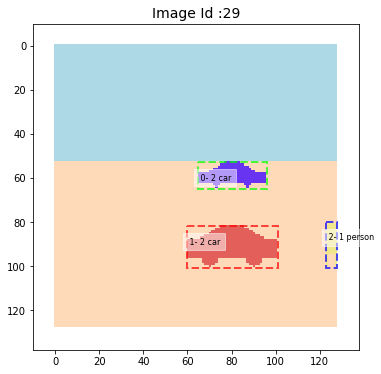

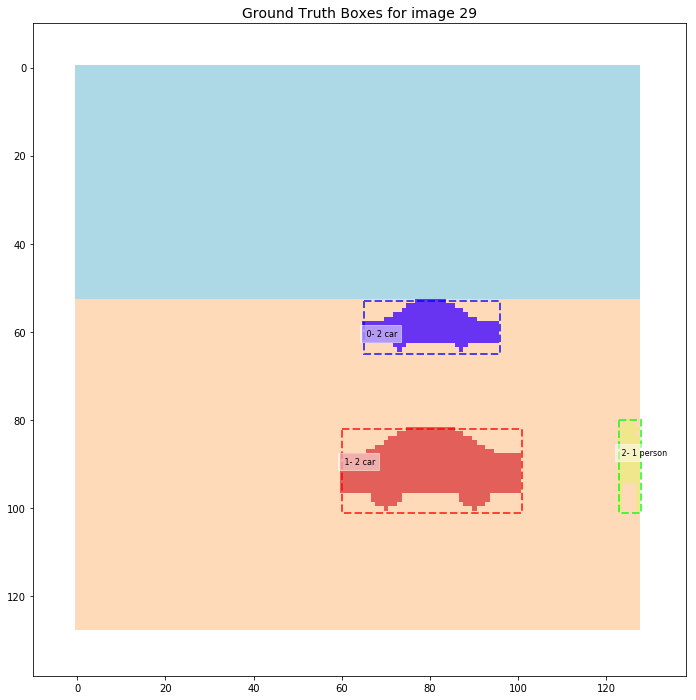

In [276]:
vis.display_image_gt(dataset_test, dataset_test.config, 29, size=6, verbose = True)
vis2.display_gt_bboxes(dataset_test, dataset_test.config, 29)

In [279]:
print(image_id)
# for y in range(60, 100, 2):
#     x = 60
#     person = ('person', (240.0, 230.0, 140.0), (x, y, 2, 10))
#     dataset_test.image_info[29]['shapes'][-1] = person
#     fcn_results = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
#     r = fcn_results[0]
#     vis2.display_fcn_hm(vis2.normalize_all(r['fcn_hm'][...,:3]), class_names, columns = 3, size = 8)

29


## Heatmap aggregation over a number of images

In [17]:
np_format = {}
np_format['float']  = lambda x: "%10.4f" % x
np_format['int']    = lambda x: "%8d" % x
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)

### Helper functions 

In [136]:
def aggregate_results(fcn_results, results):
    r = fcn_results[0]
        
    gt_inst_per_class = np.bincount(np.abs(r['gt_class_ids']), minlength = NUM_CLASSES)
    dt_inst_per_class = np.bincount(r['class_ids']           , minlength = NUM_CLASSES)

    results['gt_cls_counts'] += gt_inst_per_class
    results['dt_cls_counts'] += dt_inst_per_class

    for i in range(NUM_CLASSES):
        results['gt_ttl_img_by_inst'][i,gt_inst_per_class[i]] += 1
        results['dt_ttl_img_by_inst'][i,dt_inst_per_class[i]] += 1


    if len(r['class_ids']) == 1: 
        results['imgs_one_dt'] += 1
    if len(r['gt_class_ids']) == 1:
        results['imgs_one_gt'] += 1

    fcn_hm_max   = np.max(r['fcn_hm'])
    fcn_hm_min   = np.min(r['fcn_hm'])
    pr_hm_max    = np.max(r['pr_hm'])
    pr_hm_min    = np.min(r['pr_hm'])
    
    if fcn_hm_max > results['sav_fcn_max'] :
        results['sav_fcn_max'] = fcn_hm_max

    if fcn_hm_min < results['sav_fcn_min'] :
        results['sav_fcn_min'] = fcn_hm_min

    if pr_hm_max > results['sav_pr_max']:
        results['sav_pr_max'] = pr_hm_max

    if pr_hm_min > results['sav_pr_min']:
        results['sav_pr_min'] = pr_hm_min
    
    results['pr_agg_hm']          += r['pr_hm']
    results['fcn_agg_hm']         += r['fcn_hm']
    results['pr_agg_hm_clipped']  += np.clip(r['pr_hm'], 0.0, 1.0)
    results['fcn_agg_hm_clipped'] += np.clip(r['fcn_hm'], 0.0, 1.0)



    return results
        
def save_results(results, save_path, save_file):
    print(' Save to output file: ',save_file)
    np.savez_compressed(os.path.join(save_path, save_file),     
                    imgs_one_gt        = results['imgs_one_gt'], 
                    imgs_one_dt        = results['imgs_one_dt'],  
                    gt_cls_counts      = results['gt_cls_counts'], 
                    dt_cls_counts      = results['dt_cls_counts'],
                    gt_ttl_img_by_inst = results['gt_ttl_img_by_inst'],
                    dt_ttl_img_by_inst = results['dt_ttl_img_by_inst'],
                    sav_pr_min         = results['sav_pr_min']  ,
                    sav_pr_max         = results['sav_pr_max']  , 
                    sav_fcn_min        = results['sav_fcn_min'] , 
                    sav_fcn_max        = results['sav_fcn_max'] ,                     
                    pr_agg_hm          = results['pr_agg_hm']  ,
                    fcn_agg_hm         = results['fcn_agg_hm']  ,
                    pr_agg_hm_clipped  = results['pr_agg_hm_clipped'],
                    fcn_agg_hm_clipped = results['fcn_agg_hm_clipped'] )     
    return 0


def display_results(results):
    np_format = {}
    np_format['float']  = lambda x: "%10.4f" % x
    np_format['int']    = lambda x: "%6d" % x
    np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)
    
    print()
    print(' Final Results:')
    print('---------------')
    print('  pr_hm MIN: {:12.5f}      MAX: {:12.5f}'.format(results['sav_pr_min'], results['sav_pr_max']))
    print(' fcn_hm MIN: {:12.5f}      MAX: {:12.5f}'.format(results['sav_fcn_min'], results['sav_fcn_max']))
    print()
    print(' images with one gt object:', results['imgs_one_gt'], '  one detection from MR-CNN:', results['imgs_one_dt'])
    print(' Ground Truth by class    :', results['gt_cls_counts'])
    print(' Detections by class      :', results['dt_cls_counts'])
    print()
    print(' Original Heatmap:')
    print(' ----------------')
    print('    pr_hm mins: ',np.min(results['pr_agg_hm'] , axis=(0,1)))
    print('          maxs: ',np.max(results['pr_agg_hm'] , axis=(0,1)))
    print()
    print('   fcn_hm mins: ',np.min(results['fcn_agg_hm'], axis=(0,1)))
    print('          maxs: ',np.max(results['fcn_agg_hm'], axis=(0,1)))
    print()
    print('   pr_hm sums : ',np.sum(results['pr_agg_hm'] , axis=(0,1)))
    print('   fcn_hm sums: ',np.sum(results['fcn_agg_hm'], axis=(0,1)))
    print()
    print(' Clipped Heatmap:')
    print(' ----------------')
    print('   pr_hm mins : ',np.min(results['pr_agg_hm_clipped'], axis=(0,1)))
    print('         maxs : ',np.max(results['pr_agg_hm_clipped'], axis=(0,1)))
    print('  fcn_hm mins : ',np.min(results['fcn_agg_hm_clipped'], axis=(0,1)))
    print('         maxs : ',np.max(results['fcn_agg_hm_clipped'], axis=(0,1)))
    print('   pr_hm sums : ',np.sum(results['pr_agg_hm_clipped'], axis=(0,1)))
    print('  fcn_hm sums : ',np.sum(results['fcn_agg_hm_clipped'], axis=(0,1)))

    print('\n gt_ttl_img_by_inst', results['gt_ttl_img_by_inst'].shape)
    print(' ------------------')
    print(results['gt_ttl_img_by_inst'][:,:16])
    print('\n dt_ttl_img_by_inst : ', results['dt_ttl_img_by_inst'].shape)
    print(' ------------------')
    print(results['dt_ttl_img_by_inst'][:,:16])
    return(0)

### Load weight file

In [137]:
FCN_DIR_WEIGHTS =  '/home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000'
fcn_files  = ['fcn_0001.h5', 'fcn_0002.h5', 'fcn_0003.h5', 'fcn_0004.h5', 
          'fcn_0005.h5', 'fcn_0006.h5', 'fcn_0008.h5', 'fcn_0009.h5', 
          'fcn_0012.h5', 'fcn_0016.h5', 'fcn_0018.h5', 'fcn_0019.h5', 
          'fcn_0021.h5', 'fcn_0022.h5', 'fcn_0023.h5', 'fcn_0024.h5', 
          'fcn_0033.h5', 
          'fcn_0039.h5', 'fcn_0042.h5', 'fcn_0044.h5', 'fcn_0077.h5', 'fcn_0089.h5',    ## 17,18,19,20,21
          'fcn_0170.h5', 'fcn_0177.h5', 'fcn_0253.h5', 'fcn_0266.h5']  ## 22,23,24,25

FILE_IDX = 2    ## fcn_0003
FILE_IDX = 5    ## fcn_0006
FILE_IDX = 13   ## fcn_0022
FILE_IDX = 17   ## fcn_0039
FILE_IDX = 18   ## fcn_0042
FILE_IDX = 20   ## fcn_0077
FILE_IDX = 21   ## fcn_0089
FILE_IDX = 22   ## fcn_0170
FILE_IDX = 24   ## fcn_0253
weights_file = os.path.join(FCN_DIR_WEIGHTS  , fcn_files[FILE_IDX])
print("Loading weights ", weights_file)
fcn_model.load_model_weights(weights_file)

Loading weights  /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0253.h5
-----------------------------------------------
 Load Model with init parm: [ /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0253.h5 ]
-----------------------------------------------
 ---> Explicit weight file
>>> load_weights() from : /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0253.h5
    Weights file loaded: /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0253.h5 
FCN  MODEL Load weight file COMPLETE 


In [29]:
print('{:04d}'.format(FILE_IDX))

0024


 Image_id    :  79  Reference:  [('person', (240.0, 230.0, 140.0), (50, 86, 1, 9))] Coco Id: 79
 Image meta  :  [    79    128    128      3      0      0    128    128      1      1]
 Class ids   :  (1,)    [     1]
 Class Names :  ['person']


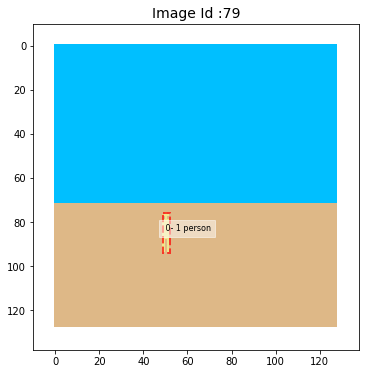

In [222]:
image_id = 79
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)

In [231]:
image_id = 79
# new_obj = ('airplane', (215.0, 217.0, 161.0), (15, 15, 16, 6))
# building = ('building', (7.0, 9.0, 197.0), (92, 60, 24, 20))
airplane = ('airplane', (200.0, 132.0, 126.0), (40, 30, 18, 7))
truck = ('truck', (83.0, 192.0, 78.0), (65, 71, 25, 8))
car = ('car', (150.0, 174.0, 8.0), (87, 112, 22, 11))
person = ('person', (240.0, 230.0, 140.0), (50, 86, 2, 10))
# new_obj = ('sun', (255.0, 215.0, 0.0), (67, 9, 6, 6))
# new_obj = ('sun', (0.0, 0.0, 0.0), (cx, cy, 6, 6))        

# del dataset_test.image_info[image_id]['shapes'][0]
dataset_test.image_info[image_id]['shapes'].append(car)
# dataset_test.image_info[image_id]['shapes'].append(person)
# dataset_test.image_info[image_id]['shapes'].append(building)
# dataset_test.image_info[image_id]['shapes'].append(airplane)
# dataset_test.image_info[image_id]['shapes'].append(truck)


[('person', (240.0, 230.0, 140.0), (50, 86, 2, 10)), ('car', (150.0, 174.0, 8.0), (87, 112, 22, 11))]
 Image_id    :  79  Reference:  [('person', (240.0, 230.0, 140.0), (50, 86, 2, 10)), ('car', (150.0, 174.0, 8.0), (87, 112, 22, 11))] Coco Id: 79
 Image meta  :  [    79    128    128      3      0      0    128    128      1      1]
 Class ids   :  (2,)    [     1      2]
 Class Names :  ['person', 'car']


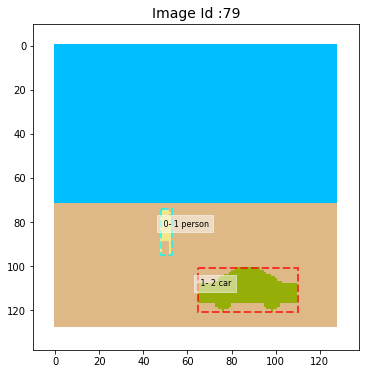

In [235]:
print(dataset_test.image_info[image_id]['shapes'])
vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
# fcn_results = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = True)  

### Run `compute_ap` over images

In [237]:
save_path = "/home/kbardool/git_projs/mrcnn3/train_newshapes_2/other"
black = (0.0, 0.0, 0.0)
FROM  = 4
TO    = 124
STEP_SIZE = 4
NUM_CLASSES = 9
image_id   = 79
exp_desc = 'car_mvmt_w_prsn'
del dataset_test.image_info[image_id]['shapes'][-1]
#---------------------------------------------------------------------------------------
# for FILE_IDX in [2,5,13,18,21,22,24]:
# for FILE_IDX in [ 17, 18, 21 ]:    
for FILE_IDX in [ 17, 18, 21, 22, 23, 24, 25 ]:    
    weights_file = os.path.join(FCN_DIR_WEIGHTS  , fcn_files[FILE_IDX])
    fcn_model.load_model_weights(weights_file)
    
    epochs = fcn_files[FILE_IDX].split('_')[1].replace('.h5','')
    print('Weight file: ', weights_file, ' epochs:', epochs)

    ###  Initialize data structures 
    failed_predicts = 0
    agg_hm_shape = (128,128,NUM_CLASSES)

    results = {}
    results['pr_agg_hm']          = np.zeros(agg_hm_shape)
    results['fcn_agg_hm']         = np.zeros(agg_hm_shape)
    results['pr_agg_hm_clipped']  = np.zeros(agg_hm_shape)
    results['fcn_agg_hm_clipped'] = np.zeros(agg_hm_shape)
    results['gt_cls_counts']      = np.zeros((NUM_CLASSES), dtype = np.int)
    results['dt_cls_counts']      = np.zeros((NUM_CLASSES), dtype = np.int)
    results['gt_ttl_img_by_inst'] = np.zeros((NUM_CLASSES, 200), dtype = np.int)  # 16 is config.MAX_SHAPES_PER_IMAGE
    results['dt_ttl_img_by_inst'] = np.zeros((NUM_CLASSES, 200), dtype = np.int)  # 16 is config.MAX_SHAPES_PER_IMAGE
    results['imgs_one_gt'] = 0
    results['imgs_one_dt'] = 0
    results['sav_pr_min']  = 0
    results['sav_pr_max']  = 0
    results['sav_fcn_min'] = 0
    results['sav_fcn_max'] = 0


    print('==> Calculate Heatmap aggregates for image_id : ', image_id)
    for cx in range(FROM,TO, STEP_SIZE):
        for cy in range(FROM, TO, STEP_SIZE):    
#                 new_obj = ('car', black, (cx, cy, 15, 7))                      ## image 79
            new_obj = ('car', (150.0, 174.0, 8.0), (cx, cy, 22, 11))     ## image 79 - move car around 
    
#                 new_obj = ('person', (0.0, 0.0, 0.0), (cx, cy, 2, 10))         ## image 176, 29

#                 new_obj = ('sun', (0.0, 0.0, 0.0), (cx, cy, 4, 4))             ## image 18  - moving sun - black
#                 new_obj = ('sun', (255.0, 215.0, 0.0), (cx, cy, 4, 4))         ## image 18 - moving sun - color

#                 new_obj = ('building', (0.0, 0.0, 0.0), (cx, cy, 16, 16))      ## image 67 - moving building
#                 new_obj = ('airplane', (0.0, 0.0, 0.0), (cx, cy, 16, 6))       ## image 67 - moving airplane - black
#                 new_obj = ('airplane', (215.0, 217.0, 161.0), (cx, cy, 16, 6)) ## image 67 - moving airplane - color
#                 new_obj = ('sun', (0.0, 0.0, 0.0), (cx, cy, 6, 6))             ## image 67 - moving sun - color
#                 new_obj = ('sun', (255.0, 215.0, 0.0), (cx, cy, 6, 6))         ## image 67 - moving sun - color

#             new_obj = ('airplane', (200.0, 132.0, 126.0), (cx, cy, 18, 7))       ## IMAGE 77 - moving airplane color
#             new_obj = ('car', (200.0, 132.0, 126.0), (cx, cy, 16, 7))          ## IMAGE 77 - moving car color
#             new_obj = ('truck', (83.0, 192.0, 78.0), (65, 71, 25, 8))    ## image 77 - moving truck

            dataset_test.image_info[image_id]['shapes'].append(new_obj)
        
#             print(dataset_test.image_info[image_id]['shapes'])
#             vis.display_image_gt(dataset_test, dataset_test.config, image_id, size=6, verbose = True)
            
        
            try:
                fcn_results = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id, verbose = False)  
            except Exception as e :
                failed_predicts += 1
                print('    failure on mrcnn predict - image id: {} at cx:{} cy:{}    total failures: {}'.format(image_id, cx, cy, failed_predicts))
            else:    
                results = aggregate_results(fcn_results, results)
                pass

            del dataset_test.image_info[image_id]['shapes'][-1]
            
        
    save_file =  'exp2_i'+str(image_id)+'_e'+epochs+'_'+exp_desc+'.npz'
    save_results(results, save_path, save_file)
    display_results(results)

    print('\n\n Agg heatmap Calcs completed for epoch:', epochs , ' (Weight file:', weights_file, ')')
    print(' Total failed :', failed_predicts)

-----------------------------------------------
 Load Model with init parm: [ /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0039.h5 ]
-----------------------------------------------
 ---> Explicit weight file
>>> load_weights() from : /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0039.h5
    Weights file loaded: /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0039.h5 
FCN  MODEL Load weight file COMPLETE 
Weight file:  /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0039.h5  epochs: 0039
==> Calculate Heatmap aggregates for image_id :  79
 Save to output file:  exp2_i79_e0039_car_mvmt_w_prsn.npz

 Final Results:
---------------
  pr_hm MIN:      0.00000      MAX:      1.00000
 fcn_hm MIN:     -4.31139      MAX:      1.82983

 images with one gt object: 0   one detection from MR-CNN: 22
 Ground Truth by class    : [     0    900    900      0      0      0      0      0      0]
 Detection

    Weights file loaded: /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0089.h5 
FCN  MODEL Load weight file COMPLETE 
Weight file:  /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0089.h5  epochs: 0089
==> Calculate Heatmap aggregates for image_id :  79
 Save to output file:  exp2_i79_e0089_car_mvmt_w_prsn.npz

 Final Results:
---------------
  pr_hm MIN:      0.00000      MAX:      1.00000
 fcn_hm MIN:     -4.95953      MAX:      1.78005

 images with one gt object: 0   one detection from MR-CNN: 22
 Ground Truth by class    : [     0    900    900      0      0      0      0      0      0]
 Detections by class      : [     0    914    490   1026    223     86    385    660    333]

 Original Heatmap:
 ----------------
    pr_hm mins:  [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
          maxs:  [    0.0000   785.5839     8.8419     6.7325    10.1911     7.2146     5.6411     9.4

    Weights file loaded: /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0177.h5 
FCN  MODEL Load weight file COMPLETE 
Weight file:  /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0177.h5  epochs: 0177
==> Calculate Heatmap aggregates for image_id :  79
 Save to output file:  exp2_i79_e0177_car_mvmt_w_prsn.npz

 Final Results:
---------------
  pr_hm MIN:      0.00000      MAX:      1.00000
 fcn_hm MIN:     -4.05429      MAX:      1.64936

 images with one gt object: 0   one detection from MR-CNN: 22
 Ground Truth by class    : [     0    900    900      0      0      0      0      0      0]
 Detections by class      : [     0    914    490   1026    223     86    385    660    333]

 Original Heatmap:
 ----------------
    pr_hm mins:  [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
          maxs:  [    0.0000   785.5839     8.8419     6.7325    10.1911     7.2146     5.6411     9.4

    Weights file loaded: /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0266.h5 
FCN  MODEL Load weight file COMPLETE 
Weight file:  /home/kbardool/models_newshapes2/train_fcn8L2_BCE1/fcn20190323T0000/fcn_0266.h5  epochs: 0266
==> Calculate Heatmap aggregates for image_id :  79
 Save to output file:  exp2_i79_e0266_car_mvmt_w_prsn.npz

 Final Results:
---------------
  pr_hm MIN:      0.00000      MAX:      1.00000
 fcn_hm MIN:     -4.11606      MAX:      1.65643

 images with one gt object: 0   one detection from MR-CNN: 22
 Ground Truth by class    : [     0    900    900      0      0      0      0      0      0]
 Detections by class      : [     0    914    490   1026    223     86    385    660    333]

 Original Heatmap:
 ----------------
    pr_hm mins:  [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
          maxs:  [    0.0000   785.5839     8.8419     6.7325    10.1911     7.2146     5.6411     9.4

### Display FCN output heatmaps for a series of epoch files

  input file:  /home/kbardool/git_projs/mrcnn3/train_newshapes_2/other/exp2_img_77_epoch_0039.npz
(128, 128, 9)
n_feartes  range(0, 9)


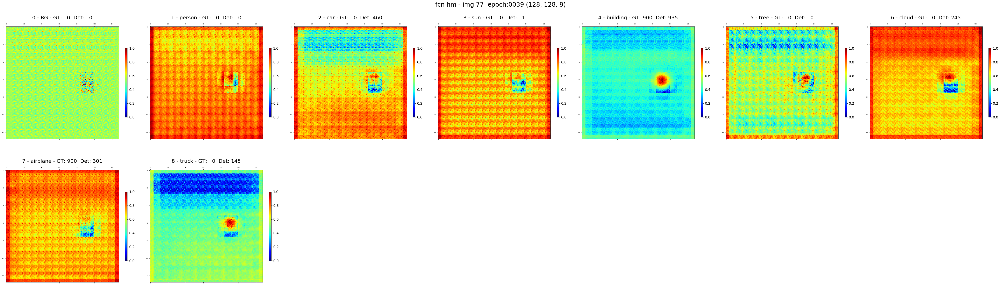

n_feartes  range(0, 9)


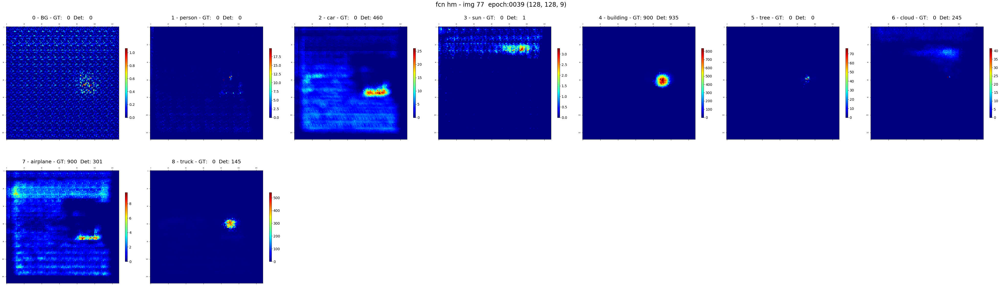

  input file:  /home/kbardool/git_projs/mrcnn3/train_newshapes_2/other/exp2_img_77_epoch_0042.npz
(128, 128, 9)
n_feartes  range(0, 9)


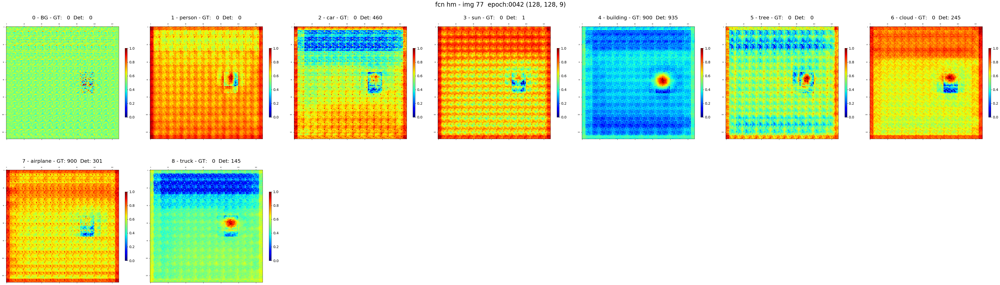

n_feartes  range(0, 9)


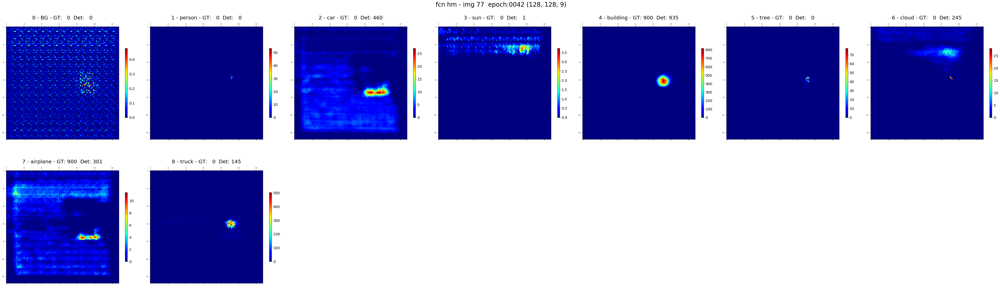

  input file:  /home/kbardool/git_projs/mrcnn3/train_newshapes_2/other/exp2_img_77_epoch_0089.npz
(128, 128, 9)
n_feartes  range(0, 9)


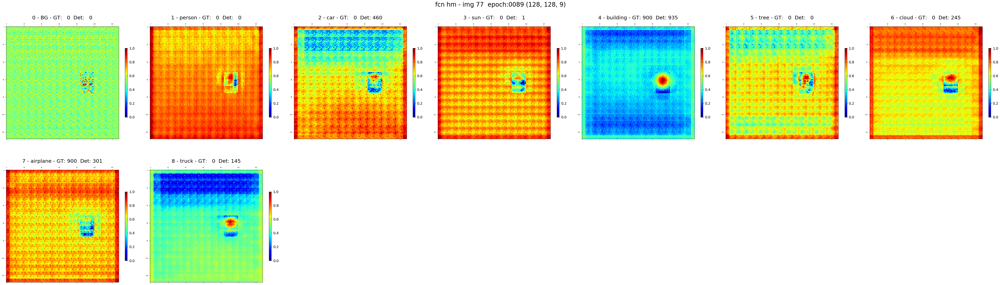

n_feartes  range(0, 9)


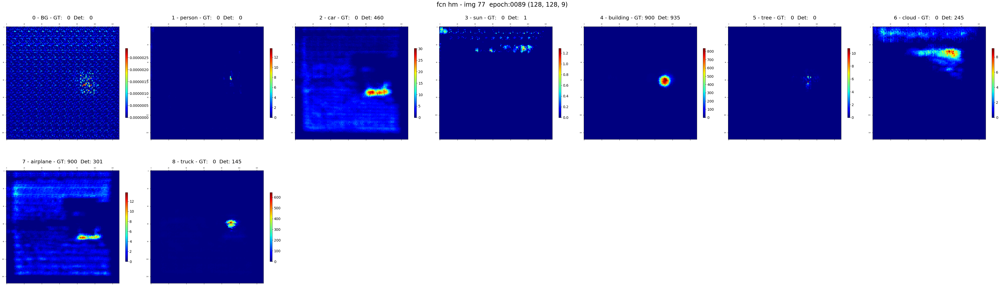

In [74]:
cols = 9 
image_id = 77
exp_desc = 'airp_mvmt_wo_bldg'

# for FILE_IDX in [2,5,13,18,21,22,24]:    
for FILE_IDX in [17,18,21]:
    epochs = fcn_files[FILE_IDX].split('_')[1].replace('.h5','')
    load_file =  'exp2_i'+str(image_id)+'_e'+epochs+'_'+exp_desc+'.npz'
    filename  = os.path.join(save_path, load_file)
    if os.path.exists(filename):
        print('  input file: ', filename)
        loaddata = np.load(os.path.join(save_path, load_file))
    else: 
        print('file not found ', filename)
        continue 
    fcn_agg_hm         = loaddata['fcn_agg_hm']
    fcn_agg_hm_clipped = loaddata['fcn_agg_hm_clipped']
    gt_cls_counts      = loaddata['gt_cls_counts']  
    dt_cls_counts      = loaddata['dt_cls_counts']      
    ttl = 'fcn hm - img '+str(image_id)+'  epoch:'+str(epochs) +'  '+ exp_desc 

#     vis2.display_fcn_input_1(vis2.normalize_fcn_hm(fcn_agg_hm), gt_cls_counts, dt_cls_counts, class_names, columns =7, title =  ttl + '- CLASS NORMALIZED ')
#     vis2.display_fcn_input_1(fcn_agg_hm_clipped, gt_cls_counts, dt_cls_counts, class_names, columns =7, title = ttl +'- CLIPPED TO 0 ')
#     vis2.display_fcn_input_1(fcn_agg_hm, gt_cls_counts, dt_cls_counts, class_names, columns = cols, title = ttl +'- RAW DATA ', norm = False)
        vis2.display_fcn_input_1(vis2.normalize_fcn_hm(fcn_agg_hm), gt_cls_counts, dt_cls_counts, class_names, columns = cols, title = ttl +'- NORMALIZED PER CLASS ')
        vis2.display_fcn_input_1(vis2.normalize_all(fcn_agg_hm), gt_cls_counts, dt_cls_counts, class_names, columns = cols, title = ttl +'- NORMALIZED ACROSS ALL CLASSES ')

In [73]:
print(fcn_agg_hm.min(axis=(0,1), keepdims = True))
print(fcn_agg_hm.min( keepdims = True))


[[[   -0.0000 -2971.1923 -1572.1935 -3483.4265 -1107.3983 -1226.4653 -2126.6803 -2012.9345 -1259.4795]]]
[[[-3483.4265]]]


## Load and Display saved .npz file 

In [94]:
# epochs = files[FILE_IDX].split('_')[1].replace('.h5','')
epochs = '0266'
image_id =  176
load_file =  'exp2_img'+'_'+str(image_id)+'_epoch_'+epochs+'.npz'
print('  input file: ',os.path.join(save_path, load_file))

NameError: name 'heatmaps_file' is not defined

In [390]:
loaddata = np.load(os.path.join(save_path, load_file))
# print(type(loaddata))
# print(loaddata.keys)
# print(type(loaddata['gt_ttl_img_by_inst']),'  ', type(loaddata['gt_ttl_img_by_inst'][0]))

# gt_cls_counts      = loaddata['gt_cls_counts']  
# dt_cls_counts      = loaddata['dt_cls_counts']  
# imgs_one_gt        = loaddata['imgs_one_gt']  
# imgs_one_dt        = loaddata['imgs_one_dt'] 
# gt_ttl_img_by_inst = loaddata['gt_ttl_img_by_inst']
# dt_ttl_img_by_inst = loaddata['dt_ttl_img_by_inst']
# sav_pr_min         = loaddata['sav_pr_min'] 
# sav_pr_max         = loaddata['sav_pr_max']  
# sav_fcn_min        = loaddata['sav_fcn_min']
# sav_fcn_max        = loaddata['sav_fcn_max']
# pr_agg_hm          = loaddata['pr_agg_hm']
# pr_agg_hm_clipped  = loaddata['pr_agg_hm_clipped']
fcn_agg_hm         = loaddata['fcn_agg_hm']
fcn_agg_hm_clipped = loaddata['fcn_agg_hm_clipped']

print('Agg heatmap Calcs complete for epoch:', epochs , ' (heatmap file:', load_file, ')')
# display_results(loaddata)

Agg heatmap Calcs complete for epoch: 0266  (heatmap file: exp2_img_176_epoch_0266.npz )

 Final Results:
---------------
  pr_hm MIN:      0.00000      MAX:      1.00000
 fcn_hm MIN:     -5.39373      MAX:      1.62916

 images with one gt object: 0   one detection from MR-CNN: 20
 Ground Truth by class    : [     0    961    961      0      0      0      0      0      0]
 Detections by class      : [     0    959    970    251      0     46      0      0      6]

 Original Heatmap:
 ----------------
    pr_hm mins:  [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
          maxs:  [    0.0000     3.4073   923.9503     3.9395     0.0000     3.2247     0.0000     0.0000     5.4793]

   fcn_hm mins:  [   -0.0000 -1740.9845 -1527.5998 -2045.3900 -1618.4484 -1705.7219 -1571.4869 -1667.5775 -1818.4751]
          maxs:  [    0.0000    -3.6481  1240.3007  -110.5703   -29.3917    -1.3002  -102.8233   731.3356   701.5903]

   pr_hm sums :  [ 

0

## Display Heatmaps

In [214]:
# hmfig = vis2.display_pairwise_heatmap(gt_ttl_img_by_inst, [0,1,2,3,4,5,6,7,8], class_names)

### mask_rcnn output

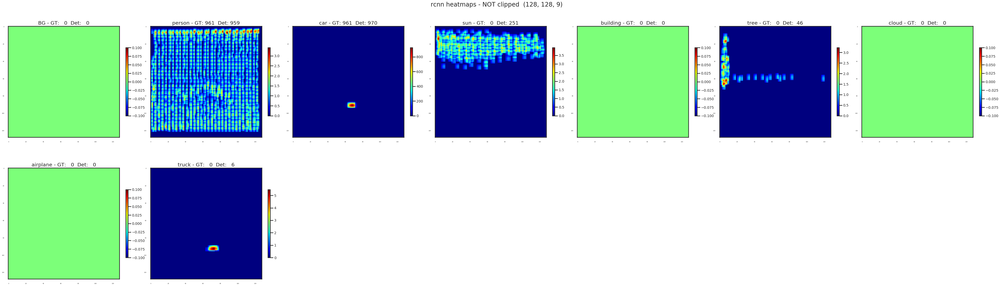

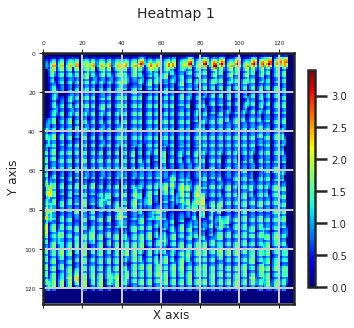

In [372]:
vis2.display_fcn_input_1(pr_agg_hm, gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns = 7, title = 'rcnn heatmaps - NOT clipped ')
vis.plot_2d_gaussian(pr_agg_hm[:,:,1], size =(5,5), title = 'MRCNN produced heatmap')

### mask_rcnn output - normalized

(128, 128, 9)


../mrcnn/visualize_2.py:692: RuntimeWarning: invalid value encountered in true_divide
  out /= (x.max(axis=(0,1), keepdims = True) - x.min(axis=(0,1), keepdims = True))


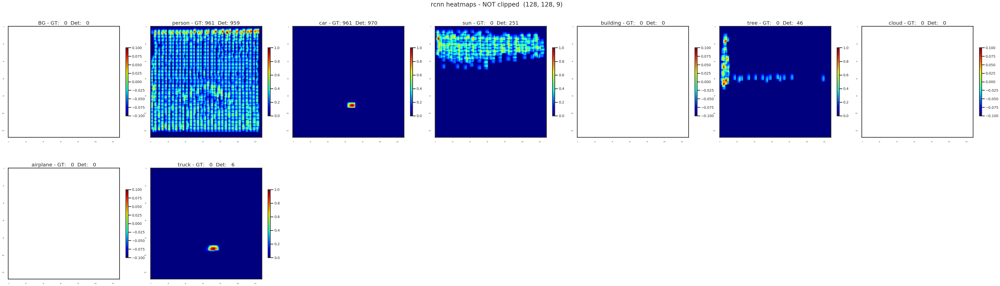

(128, 128)


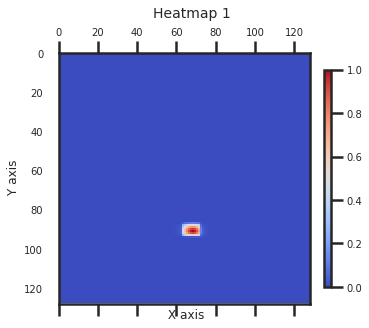

In [357]:
vis2.display_fcn_input_1(vis2.normalize_fcn_hm(pr_agg_hm), gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns = 7, title = 'rcnn heatmaps - NOT clipped ')
vis.plot_2d_gaussian(vis2.normalize_fcn_hm(pr_agg_hm[:,:,2]), size =(5,5))

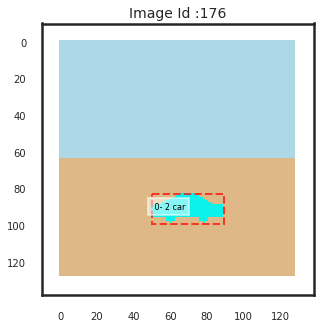

In [341]:
vis.display_image_gt(dataset_test, dataset_test.config, image_id , size = 5, verbose = False)   

### mask_rcnn output - standarize and clip

(128, 128, 9)


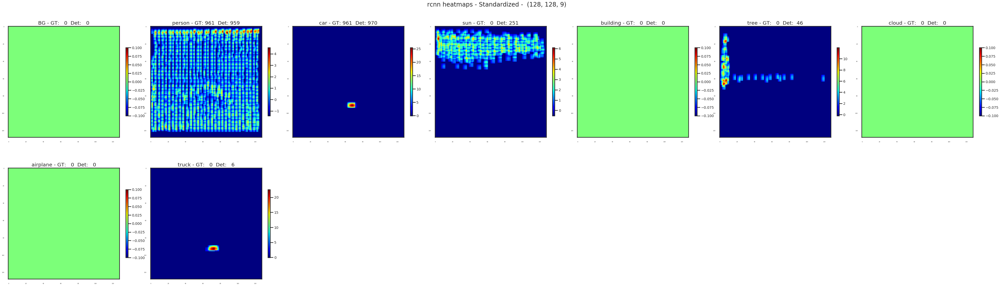

(128, 128, 9)


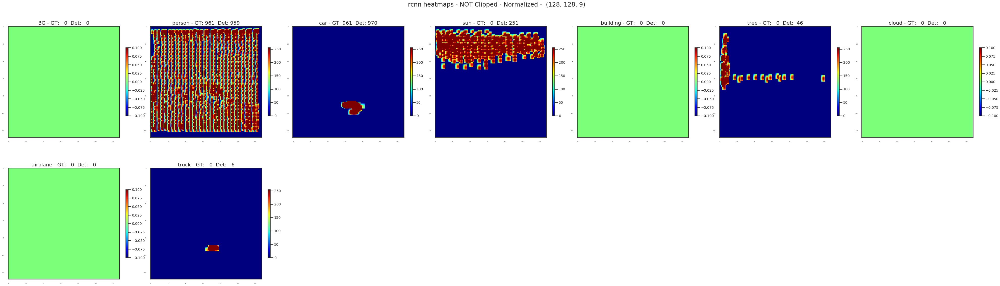

In [342]:
vis2.display_fcn_input_1(vis2.standardize_fcn_hm(pr_agg_hm), gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns = 7, title = 'rcnn heatmaps - Standardized - ')
vis2.display_fcn_input_1(vis2.deprocess_image(pr_agg_hm), gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns = 7, title = 'rcnn heatmaps - NOT Clipped - Normalized - ')

###  mask_rcnn clipped  
(pr_agg_hm_clipped is same as pr_agg_hm since the ouptut of R-CNN is [0,1]

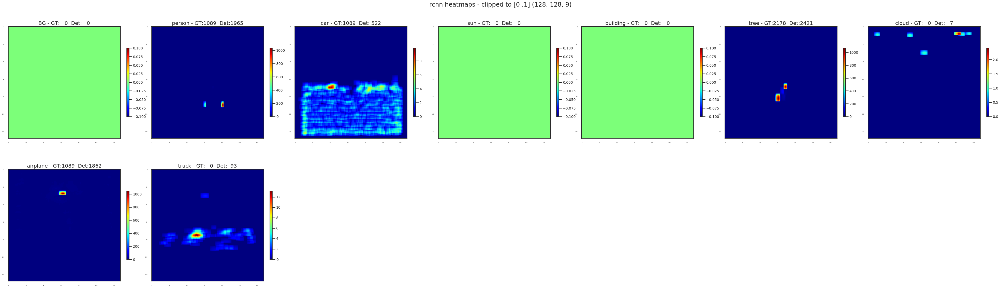

In [293]:
vis2.display_fcn_input_1(pr_agg_hm_clipped, gt_cls_counts, dt_cls_counts, class_names , cmap = 'jet', columns = 7, title = 'rcnn heatmaps - clipped to [0 ,1]')

(128, 128, 9)


../mrcnn/visualize_2.py:692: RuntimeWarning: invalid value encountered in true_divide
  out /= (x.max(axis=(0,1), keepdims = True) - x.min(axis=(0,1), keepdims = True))


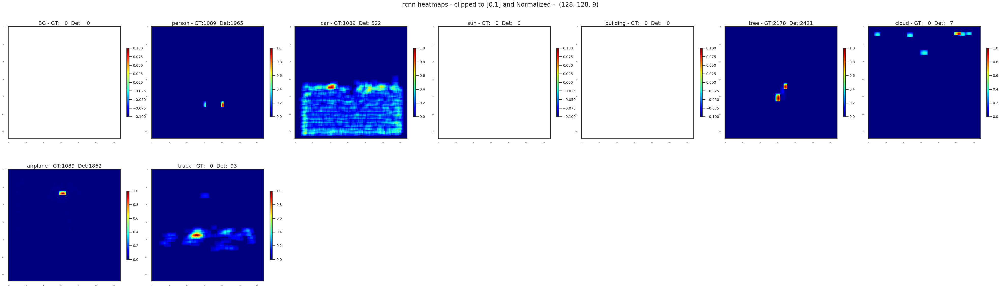

In [272]:
vis2.display_fcn_input_1(vis2.normalize_fcn_hm(pr_agg_hm_clipped), gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns = 7, title = 'rcnn heatmaps - clipped to [0,1] and Normalized - ')

(128, 128, 9)


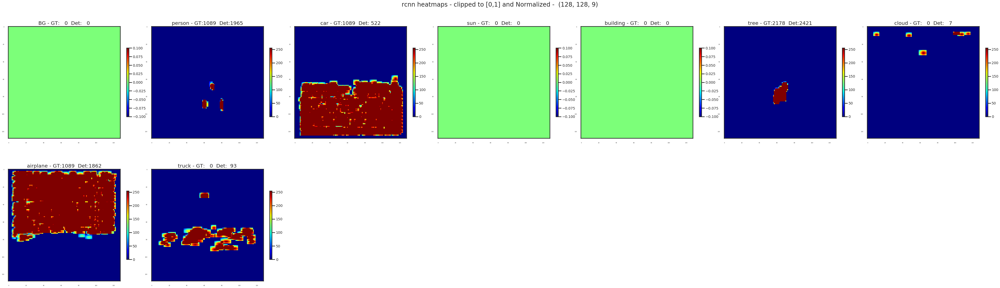

In [273]:
vis2.display_fcn_input_1(vis2.deprocess_image(pr_agg_hm_clipped), gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns = 7, title = 'rcnn heatmaps - clipped to [0,1] and Normalized - ')

###  fcn

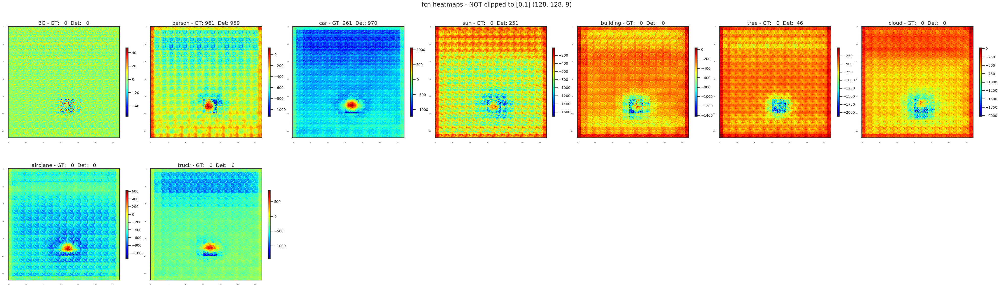

(128, 128)


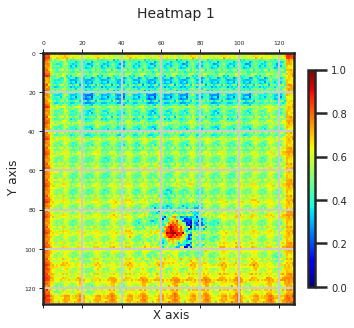

(128, 128)


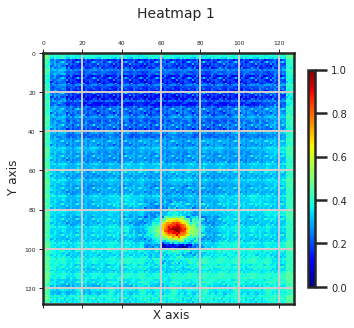

In [365]:
vis2.display_fcn_input_1(fcn_agg_hm, gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns =7, title = 'fcn heatmaps - NOT clipped to [0,1]')
vis.plot_2d_gaussian(vis2.normalize_fcn_hm(fcn_agg_hm[:,:,1]), size =(5,5))
vis.plot_2d_gaussian(vis2.normalize_fcn_hm(fcn_agg_hm[:,:,2]), size =(5,5))

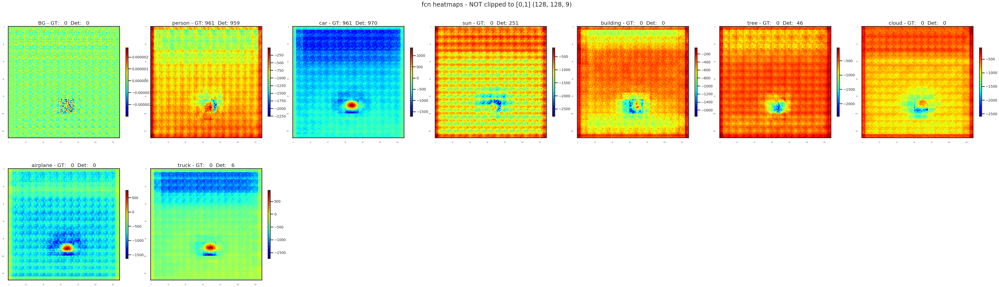

(128, 128)


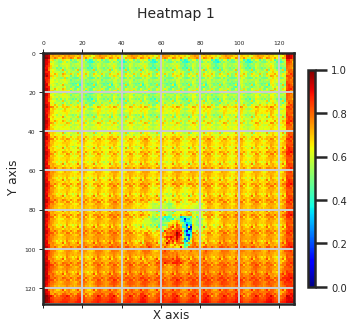

(128, 128)


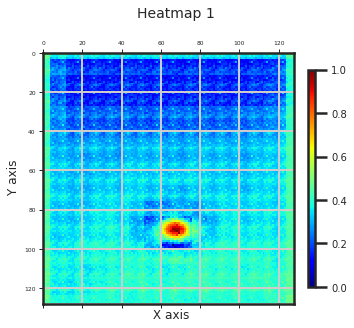

In [381]:
vis2.display_fcn_input_1(fcn_agg_hm, gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns =7, title = 'fcn heatmaps - NOT clipped to [0,1]')
vis.plot_2d_gaussian(vis2.normalize_fcn_hm(fcn_agg_hm[:,:,1]), size =(5,5))
vis.plot_2d_gaussian(vis2.normalize_fcn_hm(fcn_agg_hm[:,:,2]), size =(5,5))

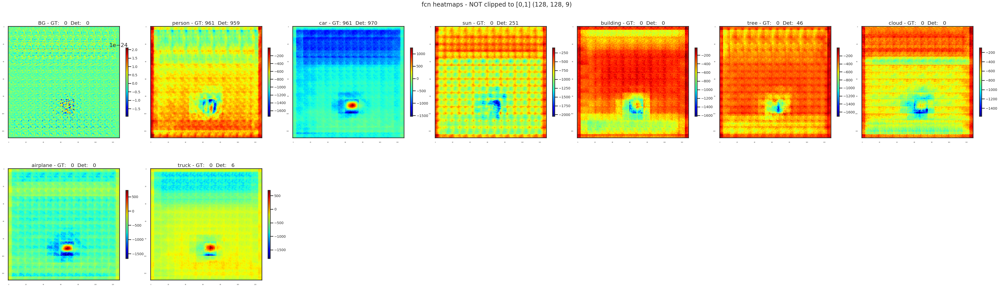

(128, 128)


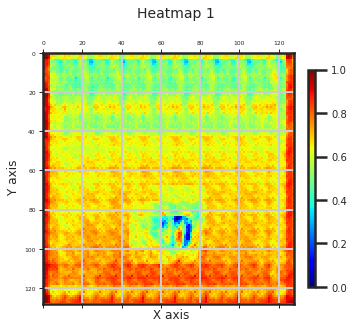

(128, 128)


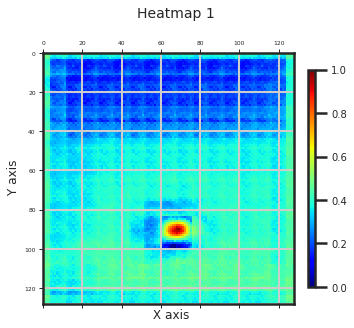

In [391]:
vis2.display_fcn_input_1(fcn_agg_hm, gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns =7, title = 'fcn heatmaps - NOT clipped to [0,1]')
vis.plot_2d_gaussian(vis2.normalize_fcn_hm(fcn_agg_hm[:,:,1]), size =(5,5))
vis.plot_2d_gaussian(vis2.normalize_fcn_hm(fcn_agg_hm[:,:,2]), size =(5,5))

### fcn normalized

(128, 128, 9)


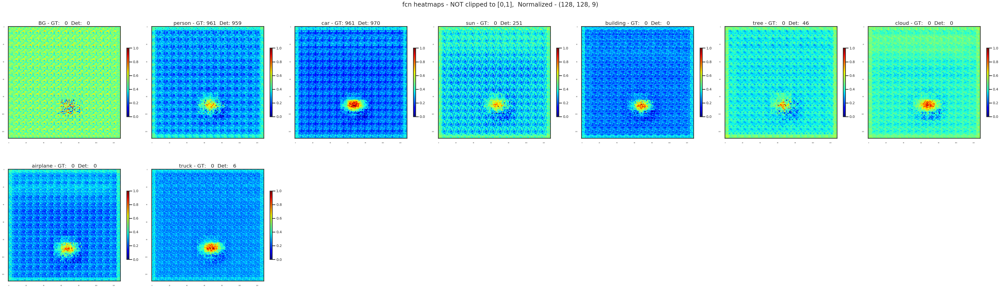

In [344]:
vis2.display_fcn_input_1(vis2.normalize_fcn_hm(fcn_agg_hm), gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns = 7, title = 'fcn heatmaps - NOT clipped to [0,1],  Normalized -')

### fcn clipped

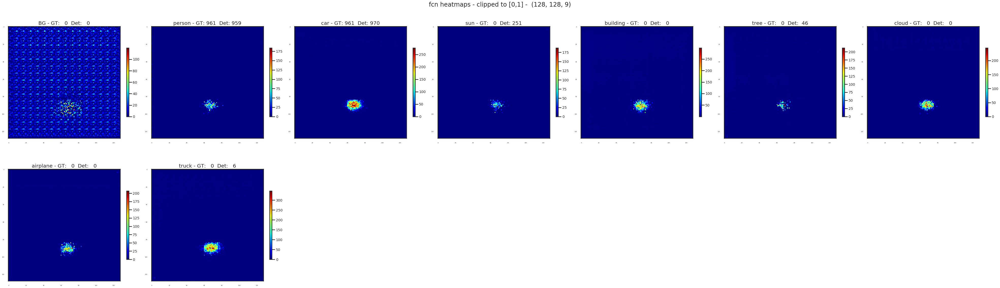

In [345]:
vis2.display_fcn_input_1(fcn_agg_hm_clipped, gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns = 7, title = 'fcn heatmaps - clipped to [0,1] - ')

### fcn clipped - normalized

In [347]:
# vis2.display_fcn_input_1(vis2.deprocess_image(fcn_agg_hm_clipped), gt_cls_counts, dt_cls_counts, class_names, cmap = 'jet', columns = 7, title = 'fcn heatmaps - clipped to [0 ,1] and Normalized - ')

## 2D Plots  

####  2D plot of `model_gt_heatmap` returned from model

In [ ]:
fig = visualize.plot_2d_heatmap(model_gt_heatmap, model_gt_heatmap_scores, img_id, gt_class_ids, 
                          class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

####  2D plot of `pred_heatmap_norm` returned from MRCNN 

In [ ]:
fig = visualize.plot_2d_heatmap(model_pr_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3, 
                            class_names = coco_class_names, scale = 4, scaling = 'all')

####  2D plot of `model_fcn_heatmap` returned from model

In [ ]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3,
                          class_names = coco_class_names, scale = 4, scaling = 'all')

####  2D plot of `model_fcn_heatmap` returned from model - ALL CLASSES

In [ ]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_gt_heatmap_scores, img_id,
                                class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

In [ ]:
fig.savefig('fcn_heatmaps_2d.png')

####  2D comparative display `pred_heatmap` / `fcn_heatmap`  

In [ ]:
fig = visualize.plot_2d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, model_pr_heatmap_scores, 
                        img_id, class_ids = pr_class_ids, class_names = coco_class_names, scale = 4, scaling = True )    

##  3D Plots

####  3D plot of  `gt_heatmap_norm` returned form code above

In [ ]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap(model_gt_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling='class')

####  3D plot of `pred_heatmap_norm` returned form model

In [ ]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_pr_heatmap, img_id, pr_class_ids, class_names = coco_class_names, zlim = 'class' , scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - only classes in pred_scores

In [ ]:
print(np.max(model_fcn_heatmap), np.min(model_fcn_heatmap))

print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, pr_class_ids,class_names = coco_class_names, scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - all classes

In [ ]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
#     plot_3d_heatmap(model_fcn_heatmap, img_id, class_ids,class_names = class_names, size = (8,8), zlim=0)
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, class_names = coco_class_names, columns = 3,scaling = 'all')

####  3D comparative display `pred_heatmap` / `fcn_heatmap` 

In [ ]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, img_id, class_ids = pr_class_ids, 
                            class_names = coco_class_names, size=(8,8), zlim = 'all' , scaling = 'all')

####  3D comparative display `gt_heatmap` / `fcn_heatmap` 

In [ ]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap_compare(model_gt_heatmap, model_fcn_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling = 'none')

## Overlay predictions on image

#### Overlay image with gt_heatmaps

In [ ]:
visualize.display_heatmaps_mrcnn(mrcnn_input, mrcnn_output, 0, hm = 'gt', columns = 3, 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names)

#### Overlay image with pred_heatmaps

In [ ]:
visualize.display_heatmaps_mrcnn(mrcnn_input, mrcnn_output, 0, hm = 'pr', columns = 3,
                     config = mrcnn_model.config, class_ids = pr_class_ids, class_names = coco_class_names)

#### Overlay image with fcn_heatmaps

In [ ]:
visualize.display_heatmaps_mrcnn_fcn(mrcnn_input, mrcnn_output, 0, heatmap = model_fcn_heatmap, hm = 'gt', columns = 3,
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'clip')

In [ ]:
from IPython.core.display import HTML
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: center;
}
</style>
""")

#### Overlay image with gt_heatmaps and fcn_heatmaps

In [ ]:
visualize.display_heatmaps_compare(mrcnn_input, mrcnn_output, heatmap = model_fcn_heatmap, image_id = 0, 
                                   hm = 'gt', config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'each')

#### Overlay image with pr_heatmaps and fcn_heatmaps

In [ ]:
visualize.display_heatmaps_compare(mrcnn_input, mrcnn_output, heatmap = model_fcn_heatmap, image_id = 0, hm = 'pr', 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'each')